In [1]:
import numpy as np
import pandas as pd
import pygeostat as gs
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from mpl_toolkits.axes_grid1 import make_axes_locatable
import subprocess as sp
%pylab inline --no-import-all
from subprocess import check_output
import tensorflow as tf
from tensorflow.python import debug as tf_debug
import os
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score
from sklearn.cluster import KMeans
from sklearn import preprocessing
import scipy.spatial as scs
import scipy as sc
import math
from scipy.spatial import distance
from sklearn.metrics import mean_squared_error
import time
from sklearn.metrics import r2_score
from random import randrange

Populating the interactive namespace from numpy and matplotlib


C:\ProgramData\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
plt_extent = 'Sensitivity_2'

In [3]:
griddef = gs.GridDef(gridfl='griddef.txt')
griddef

Pygeostat GridDef:
50 5.0 10.0 
50 5.0 10.0 
25 5.0 10.0

In [4]:
varmodelpar = '''                  Parameters for VARMODEL
                  ***********************
 
START OF PARAMETERS:
varmodel.out                 -file for modeled variogram points output
2                            -number of directions to model points along
 135   0.0  1000   0.5      -  azm, dip, npoints, point separation
 45   0.0  1000   0.5      -  azm, dip, npoints, point separation
1    0.01                   -nst, nugget effect
3    0.99    135   0.0   0.0    -it,cc,azm,dip,tilt (ang1,ang2,ang3)
        200    75    75    -a_hmax, a_hmin, a_vert (ranges)
0   100000                   -fit model (0=no, 1=yes), maximum iterations
1.0                          -  variogram sill (can be fit, but not recommended in most cases)
1                            -  number of experimental files to use
varcalc.out                  -    experimental output file 1
2   1   4                    -      # of variograms (<=0 for all), variogram #s
1   1   10                   -  # pairs weighting, inverse distance weighting, min pairs
0     10.0                   -  fix Hmax/Vert anis. (0=no, 1=yes)
0      1.0                   -  fix Hmin/Hmax anis. (0=no, 1=yes)
varmodelfit.var              -  file to save fit variogram model
'''
varmodel= gs.Program(program='varmodel',parfile='varmodel.par')
varmodel.run(parstr=varmodelpar.format())
varmodelfl = gs.DataFile(flname='varmodel.out',
                       readfl=True)
print(varmodelfl.data.head())

Calling:  ['varmodel', 'varmodel.par']

varmodel version: 1.1.1

  output points file: varmodel.out
  number of directions to model points along:            2
  azm, dip, npoints, pointsep:    135.000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:    45.0000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  nst =           1
 c0 constrained to  1.000000000000000E-002  1.000000000000000E-002
  fit model?            0      100000
  number of variogram files:            1
  variogram file: varcalc.out
  using variograms            1           4
  # pairs wt, inv dist wt, min pairs:            1           1          10
  fixhmaxvert,hmaxvert:            0   10.0000000000000     
  fixhminhmax,hminhmax:            0   1.00000000000000     
  variogram model output file: varmodelfit.var
  Modeling points

varmodel completed successfully

   Variogram Index  Lag Distance  Number of Pairs  Variogram Value  \


In [5]:
varmodelfl = gs.DataFile(flname='varmodel.out',
                       readfl=True)
print(varmodelfl.data.head())

   Variogram Index  Lag Distance  Number of Pairs  Variogram Value  \
0              1.0           0.5              1.0         0.010019   
1              1.0           1.0              1.0         0.010074   
2              1.0           1.5              1.0         0.010167   
3              1.0           2.0              1.0         0.010297   
4              1.0           2.5              1.0         0.010464   

   Variogram Number  Calculation Azimuth  Calculation Dip  
0               1.0                135.0              0.0  
1               1.0                135.0              0.0  
2               1.0                135.0              0.0  
3               1.0                135.0              0.0  
4               1.0                135.0              0.0  


In [6]:
varg = ("1    0.01                   -nst, nugget effect\n\
3    0.99    135   0.0   0.0    -it,cc,azm,dip,tilt (ang1,ang2,ang3)\n\
        250    250    150    -a_hmax, a_hmin, a_vert (ranges)")

print(varg)

1    0.01                   -nst, nugget effect
3    0.99    135   0.0   0.0    -it,cc,azm,dip,tilt (ang1,ang2,ang3)
        250    250    150    -a_hmax, a_hmin, a_vert (ranges)


In [7]:
sgsimpar = '''                  Parameters for SGSIM
                  ********************

START OF PARAMETERS:
cluster.dat           -file with data
1  2  3  4  0  0              -  columns for X,Y,Z,vr,wt,sec.var.
-1.0       1.0e21             -  trimming limits
0                             -transform the data (0=no, 1=yes)
sgsim.trn                     -  file for output trans table
0                             -  consider ref. dist (0=no, 1=yes)
histsmth.out                  -  file with ref. dist distribution
1  2                          -  columns for vr and wt
0.0    15.0                   -  zmin,zmax(tail extrapolation)
1       0.0                   -  lower tail option, parameter
1      15.0                   -  upper tail option, parameter
1                             -debugging level: 0,1,2,3
sgsim.dbg                     -file for debugging output
sgsim.out                     -file for simulation output
1                             -number of realizations to generate
{grid}
69069                         -random number seed
0     8                       -min and max original data for sim
48                            -number of simulated nodes to use
1                             -assign data to nodes (0=no, 1=yes)
1     3                       -multiple grid search (0=no, 1=yes),num
0                             -maximum data per octant (0=not used)
250  250.0  150.0              -maximum search radii (hmax,hmin,vert)
 0.0   0.0   0.0              -angles for search ellipsoid
51    51    11                -size of covariance lookup table
0     0.60   1.0              -ktype: 0=SK,1=OK,2=LVM,3=EXDR,4=COLC
../data/ydata.dat             -  file with LVM, EXDR, or COLC variable
4                             -  column for secondary variable
{varg}

'''
sgsim= gs.Program(program='sgsim',parfile='sgsim.par')
sgsim.run(parstr=sgsimpar.format(varg = varg,
                                 grid = griddef
                                ))
sgsimfl = gs.DataFile(flname='sgsim.out', griddef = griddef,
                       readfl=True)
print(sgsimfl.data.head())

Calling:  ['sgsim', 'sgsim.par']

 SGSIM Version: 4.000

  data file = cluster.dat                             
  input columns =            1           2           3           4           0
           0
  trimming limits =   -1.000000      1.0000000E+21
  transformation flag =            0
  transformation file = sgsim.trn                               
  consider smoothed distribution (1=yes) =            0
  file with smoothed distribution = histsmth.out                            
  columns =            1           2
  data limits (tails) =   0.0000000E+00   15.00000    
  lower tail =            1  0.0000000E+00
  upper tail =            1   15.00000    
  debugging level =            1
  debugging file = sgsim.dbg                               
  output file sgsim.out                               
  number of realizations =            1
  X grid specification =           50   5.000000       10.00000    
  Y grid specification =           50   5.000000       10.00000    
  Z grid

In [8]:
addcoordpar = '''                  Parameters for ADDCOORD
                  ***********************

START OF PARAMETERS:
{datafl}                         -file with data
addcoord.out                      -file for output
1                                 -realization number
{grid}
3 3 6                            -decimals for x, y, z (-1=exclude)
'''
addcoord= gs.Program(program='addcoord',parfile='addcoord.par')
addcoord.run(parstr=addcoordpar.format(datafl=sgsimfl.flname
                                ,grid = griddef
                                ))
addcoordfl = gs.DataFile(flname='addcoord.out', griddef = griddef,
                       readfl=True)
print(addcoordfl.data.head())

Calling:  ['addcoord', 'addcoord.par']

 ADDCOORD VERSION: 4.1.0

 Data File = sgsim.out                               
 Output File = addcoord.out                            
 Realization number =            1
 X grid size =           50   5.00000000000000        10.0000000000000     
 Y grid size =           50   5.00000000000000        10.0000000000000     
 Z grid size =           25   5.00000000000000        10.0000000000000     
 decimals =            3           3           6
 
 Format: (f07.03,x,f07.03,x,f10.06,x,a)      

 ADDCOORD: 4.1.0 Finished

      X    Y    Z     value
0   5.0  5.0  5.0  0.482893
1  15.0  5.0  5.0  0.435116
2  25.0  5.0  5.0  0.116569
3  35.0  5.0  5.0  0.084204
4  45.0  5.0  5.0 -0.211761


In [9]:
datafl = gs.DataFile(flname = 'addcoord.out',x='X',y='Y',z='Z', griddef=griddef,
readfl=True)
print(datafl.data.head())

      X    Y    Z     value
0   5.0  5.0  5.0  0.482893
1  15.0  5.0  5.0  0.435116
2  25.0  5.0  5.0  0.116569
3  35.0  5.0  5.0  0.084204
4  45.0  5.0  5.0 -0.211761


In [10]:
dataflpd = pd.DataFrame(datafl.data, dtype = np.float32)

In [11]:
gs.write_gslib(dataflpd,'dataflpd.out')
sgsimfl = gs.DataFile(flname = 'dataflpd.out', griddef=griddef,readfl=True)
print(sgsimfl.data.head())

      X    Y    Z     value
0   5.0  5.0  5.0  0.482893
1  15.0  5.0  5.0  0.435116
2  25.0  5.0  5.0  0.116569
3  35.0  5.0  5.0  0.084204
4  45.0  5.0  5.0 -0.211761


In [4]:
sgsimfl = gs.DataFile(flname = 'dataflpd.out', griddef=griddef,readfl=True)
print(sgsimfl.data.describe())

                  X             Y             Z         value
count  62500.000000  62500.000000  62500.000000  62500.000000
mean     250.000000    250.000000    125.000000      0.371670
std      144.309851    144.309851     72.111602      0.775798
min        5.000000      5.000000      5.000000     -2.018213
25%      125.000000    125.000000     65.000000     -0.209774
50%      250.000000    250.000000    125.000000      0.321935
75%      375.000000    375.000000    185.000000      0.889074
max      495.000000    495.000000    245.000000      2.813831


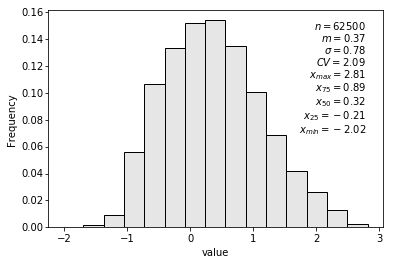

In [5]:
gs.histplt(sgsimfl.data['value'])

In [14]:
gsamplepar = '''       Parameters for gsample V2.000
     *********************************
       
START OF PARAMETERS:
1                            - Number of files to sample
{datafl}            - File with first grid
1  {varcol1}                        - Number of variables and columns
1                            - Realization to sample
{griddef}
1                            - Sampling spacing option (0=regular, 1=random)
80  80                       -  If 0, spacing in X, Y
45  45                     -  If 0, collar of the first sample, X and Y (inside sampling grid)
{ndh}  69069                    -  If 1, number of drill holes and seed number
0  90                        - Azimuth and dip
10                            - Sample spacing downhole
1                          - Starting drill hole ID for new drills
2                            - Number of decimal places (coordinates precision, up to 6)
5   495                       - Sampling grid: xmin, xmax
5   495                       -                ymin, ymax
5   245                       -                zmin, zmax
dhs_{i}.out        - Output file with new drill holes
0                            - Output keyout file? (0=no, 1=yes)
0                            -  If keyout (0=input grid inside sampling grid, 1=input blocks with assays)
keyout.out         - Keyout file
'''
for i in range(1,21):
    gsample= gs.Program(program='gsample',parfile='gsample.par')
    gsample.run(parstr=gsamplepar.format(datafl=sgsimfl.flname,
                                           varcol1=sgsimfl.gscol('value'),
                                           griddef=griddef,
                                           i=i,
                                           ndh = 100 - (i-1) * 5
                                           ))

Calling:  ['gsample', 'gsample.par']

GSAMPLE Version: 1.000

PARAMETER FILE                  = gsample.par                                                                                                                                                                                                                                                     
-----------------------------------------------------------------------------

INPUT PARAMETERS 

Number of grids to sample       =   1
Total number of variables       =   1
 
Data file  1                    = 
dataflpd.out
Variable columns                =   4
 
Sample realization number       =   1
 
Input grid 
Input grid in X                 =   50        5.00   10.00
Input grid in Y                 =   50        5.00   10.00
Input grid in Z                 =   25        5.00   10.00
 
Sample option                   =   1
 
Consider irregular spacing 

New drill holes to create       =       100
Seed number                     =     6


Allocating memory 

Finding block indices 

Sampling from grid 

Number of drill holes successfully created =   80
-----------------------------------------------------------------------------

END

Total execution time 0.100 seconds.
Calling:  ['gsample', 'gsample.par']

GSAMPLE Version: 1.000

PARAMETER FILE                  = gsample.par                                                                                                                                                                                                                                                     
-----------------------------------------------------------------------------

INPUT PARAMETERS 

Number of grids to sample       =   1
Total number of variables       =   1
 
Data file  1                    = 
dataflpd.out
Variable columns                =   4
 
Sample realization number       =   1
 
Input grid 
Input grid in X                 =   50        5.00   10.00
Input grid in Y                 =   


GSAMPLE Version: 1.000

PARAMETER FILE                  = gsample.par                                                                                                                                                                                                                                                     
-----------------------------------------------------------------------------

INPUT PARAMETERS 

Number of grids to sample       =   1
Total number of variables       =   1
 
Data file  1                    = 
dataflpd.out
Variable columns                =   4
 
Sample realization number       =   1
 
Input grid 
Input grid in X                 =   50        5.00   10.00
Input grid in Y                 =   50        5.00   10.00
Input grid in Z                 =   25        5.00   10.00
 
Sample option                   =   1
 
Consider irregular spacing 

New drill holes to create       =        55
Seed number                     =     69069
 
Azimuth                       


Allocating memory 

Finding block indices 

Sampling from grid 

Number of drill holes successfully created =   35
-----------------------------------------------------------------------------

END

Total execution time 0.140 seconds.
Calling:  ['gsample', 'gsample.par']

GSAMPLE Version: 1.000

PARAMETER FILE                  = gsample.par                                                                                                                                                                                                                                                     
-----------------------------------------------------------------------------

INPUT PARAMETERS 

Number of grids to sample       =   1
Total number of variables       =   1
 
Data file  1                    = 
dataflpd.out
Variable columns                =   4
 
Sample realization number       =   1
 
Input grid 
Input grid in X                 =   50        5.00   10.00
Input grid in Y                 =   

-----------------------------------------------------------------------------

Allocating memory 

Finding block indices 

Sampling from grid 

Number of drill holes successfully created =   15
-----------------------------------------------------------------------------

END

Total execution time 0.110 seconds.
Calling:  ['gsample', 'gsample.par']

GSAMPLE Version: 1.000

PARAMETER FILE                  = gsample.par                                                                                                                                                                                                                                                     
-----------------------------------------------------------------------------

INPUT PARAMETERS 

Number of grids to sample       =   1
Total number of variables       =   1
 
Data file  1                    = 
dataflpd.out
Variable columns                =   4
 
Sample realization number       =   1
 
Input grid 
Input grid in X  

In [15]:
print(dataflpoints.data.head())
dataflpoints.describe()

NameError: name 'dataflpoints' is not defined

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


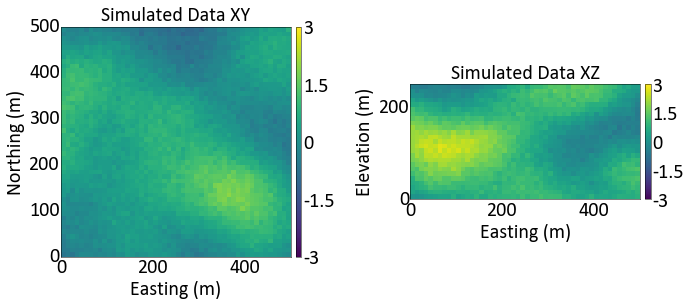

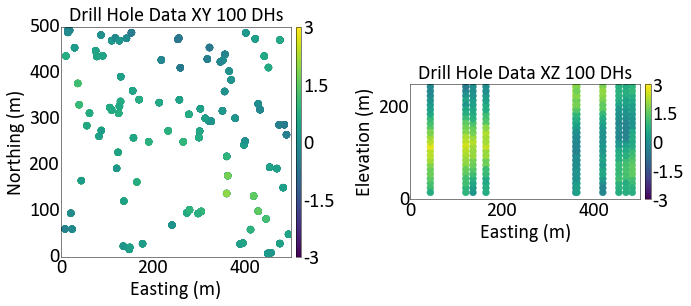

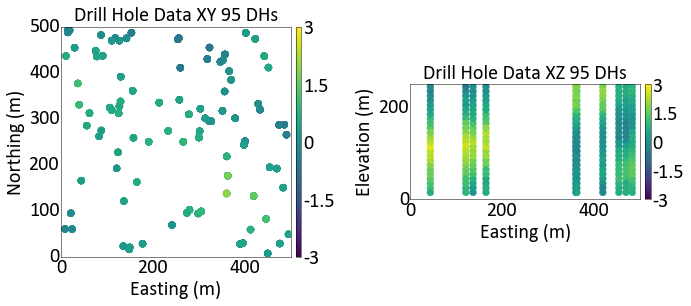

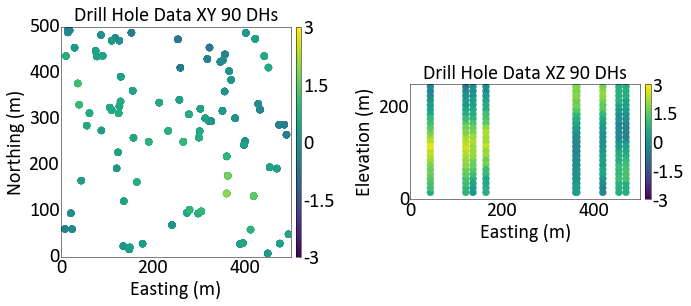

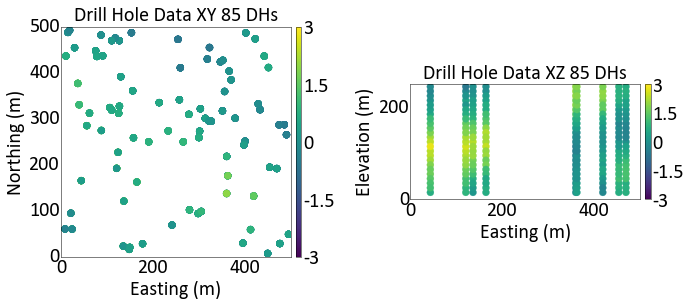

...

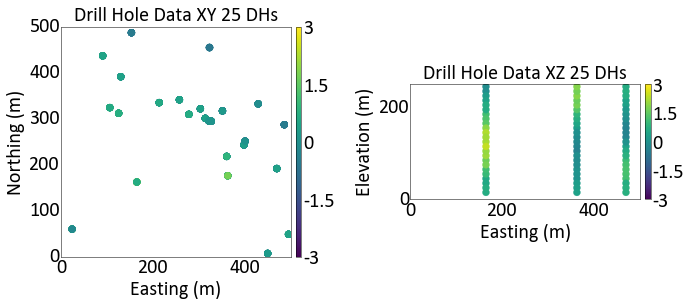

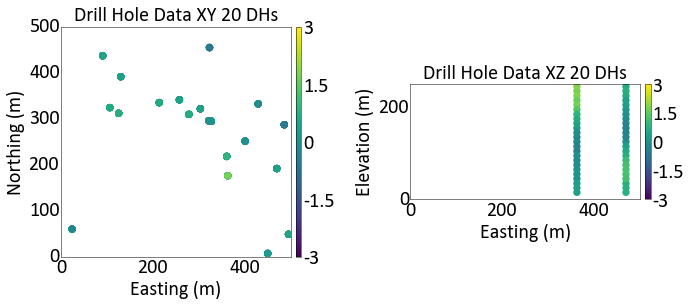

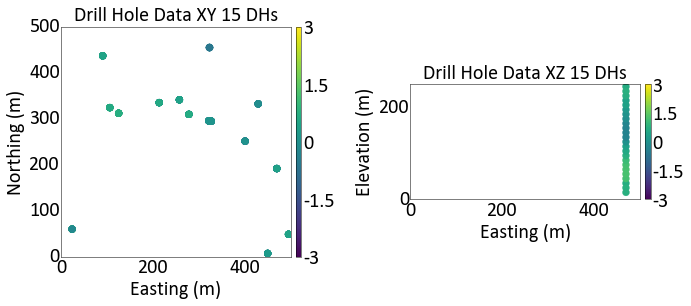

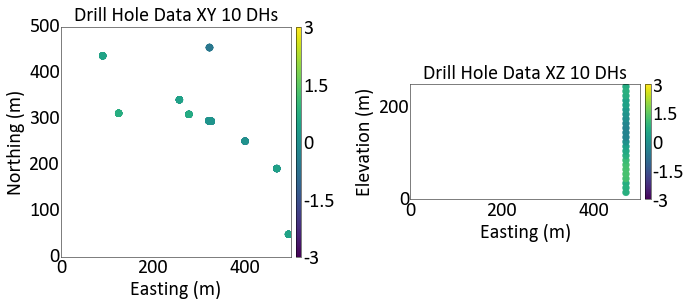

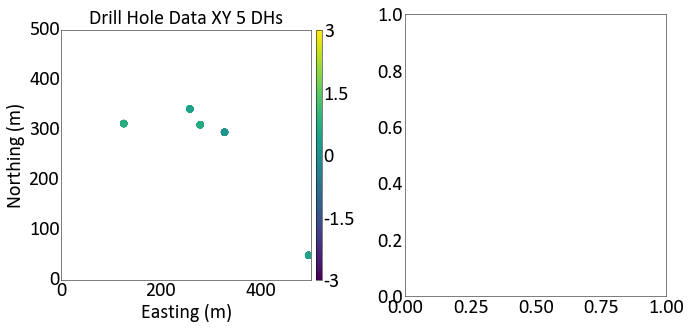

In [16]:
vlim = (-3,3)
gs.set_style('pt20')
f, axes = plt.subplots(1, 2, figsize=(10, 5))
gs.pixelplt(sgsimfl,var='value',sliceno= 20, ax = axes[0],title = ('Simulated Data XY'),vlim=vlim)
gs.pixelplt(sgsimfl,var='value',orient='xz',sliceno= 20, ax = axes[1],title = ('Simulated Data XZ'),vlim=vlim)
plt.tight_layout()
plt.savefig('C:/Users/Matt/Desktop/Thesis Work/Thesis/0-Figures/3-Chapter/Data_Drill_spacing_{}.png'.format(plt_extent),vlim=vlim)

for fold in range (1,21):
    f, axes = plt.subplots(1, 2, figsize=(10, 5)) 
    dataflpoints = gs.DataFile(flname='dhs_{}.out'.format(fold), x='X',y='Y',z='Z', griddef = griddef,
                           readfl=True)
    gs.locmap(dataflpoints,var = 'value',orient='xy', ax = axes[0],sliceno= 15,title = ('Drill Hole Data XY {} DHs').format(100-(fold-1)*5),vlim=vlim)
    gs.locmap(dataflpoints,var = 'value',orient='xz', ax = axes[1],sliceno= 15,title = ('Drill Hole Data XZ {} DHs').format(100-(fold-1)*5),vlim=vlim)
    
    plt.tight_layout()
    plt.savefig('C:/Users/Matt/Desktop/Thesis Work/Thesis/0-Figures/3-Chapter/Data_Drill_{}_{}.png'.format(fold,plt_extent),vlim=vlim)


In [ ]:
if 'session' in locals() and session is not None:
    print('Close interactive session')
    session.close()
    tf.InteractiveSession.close(sess)
    sess.close()

-1.7424
2.7666
1
Working on Node 10 fold 1 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpwpwdujl0', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0EB9F898>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 29.81195831298828
Cost_test : 27.699564
R^2:-1214.2100219726562
Epoch: 100/5000 err = 0.06135767139494419
Cost_test : 0.054097246
R^2:-1.469234824180603
Epoch: 200/5000 err = 0.02352493815124035
Cost_test : 0.021867769
R^2:0.04170730710029602
Epoch: 300/5000 err = 0.016468491405248642
Cost_test : 0.01577639
R^2:0.35266798734664917
Epoch: 400/5000 err = 0.013536141254007816
Cost_test : 0.013194383
R^2:0.4368525445461273
Epoch: 500/5000 err = 0.010884348303079605
Cost_test : 0.011437084
R^2:0.5674417912960052
Epoch: 600/5000 err = 0.010018039960414171
Cost_test : 0.010091713
R^2:0.5969455540180206
Epoch: 700/5000 err = 0.008972720243036747
Cost_test : 0.009012132
R^2:0.6217820942401886
Epoch: 800/5000 err = 0.008383228909224272
Cost_test : 0.00819476
R^2:0.6756457090377808
Epoch: 900/5000 err = 0.007263675332069397
Cost_test : 0.0074578747
R^2:0.7066699266433716
Epoch: 1000/5000 err = 0.0066328581888228655
Cost_test : 0.006896177
R^2:0.7387109398841858
Epoch: 1100/500

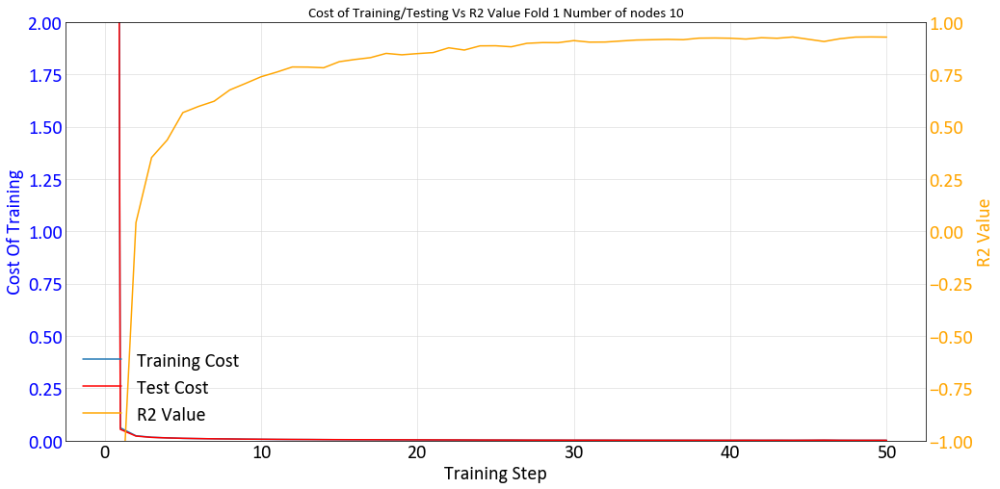

Working on Node 15 fold 1 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp3chwexgb', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E8176FF60>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 31.262798309326172
Cost_test : 27.824778
R^2:-1225.8275146484375
Epoch: 100/5000 err = 0.035987772047519684
Cost_test : 0.034523007
R^2:-0.4933850169181824
Epoch: 200/5000 err = 0.019065039232373238
Cost_test : 0.018822554
R^2:0.22268682718276978
Epoch: 300/5000 err = 0.014685134403407574
Cost_test : 0.014659854
R^2:0.39571067690849304
Epoch: 400/5000 err = 0.011983610223978758
Cost_test : 0.012286456
R^2:0.5051435828208923
Epoch: 500/5000 err = 0.010598025750368834
Cost_test : 0.01068362
R^2:0.5780535340309143
Epoch: 600/5000 err = 0.008934434037655592
Cost_test : 0.009380821
R^2:0.6469271779060364
Epoch: 700/5000 err = 0.007529995404183865
Cost_test : 0.008312988
R^2:0.6978026628494263
Epoch: 800/5000 err = 0.007061096141114831
Cost_test : 0.0074220602
R^2:0.7285615801811218
Epoch: 900/5000 err = 0.006334227742627263
Cost_test : 0.006575481
R^2:0.7560752928256989
Epoch: 1000/5000 err = 0.005752274999395013
Cost_test : 0.0059302463
R^2:0.7702318727970123
Epoch: 110

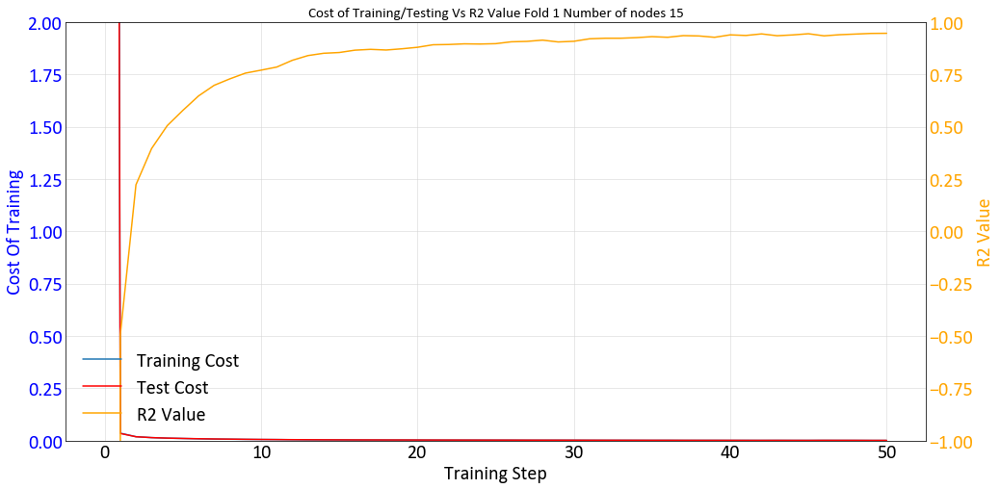

Working on Node 20 fold 1 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpadxf1mgx', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E886C1A90>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 57.8680419921875
Cost_test : 52.05097
R^2:-2338.59423828125
Epoch: 100/5000 err = 0.058070167899131775
Cost_test : 0.06270016
R^2:-1.3061119318008423
Epoch: 200/5000 err = 0.027806511148810387
Cost_test : 0.026405213
R^2:-0.07779103517532349
Epoch: 300/5000 err = 0.018007093109190464
Cost_test : 0.017912494
R^2:0.3089570701122284
Epoch: 400/5000 err = 0.01328513864427805
Cost_test : 0.013398552
R^2:0.4494003355503082
Epoch: 500/5000 err = 0.010807226411998272
Cost_test : 0.0106904395
R^2:0.5585773289203644
Epoch: 600/5000 err = 0.008750066626816988
Cost_test : 0.008937361
R^2:0.6728185415267944
Epoch: 700/5000 err = 0.007444110931828618
Cost_test : 0.0077319564
R^2:0.7125033438205719
Epoch: 800/5000 err = 0.0068166234996169806
Cost_test : 0.006794047
R^2:0.7258581817150116
Epoch: 900/5000 err = 0.0060877869836986065
Cost_test : 0.006052658
R^2:0.7580703794956207
Epoch: 1000/5000 err = 0.0056609532330185175
Cost_test : 0.0054285405
R^2:0.7691724300384521
Epoch: 1100/

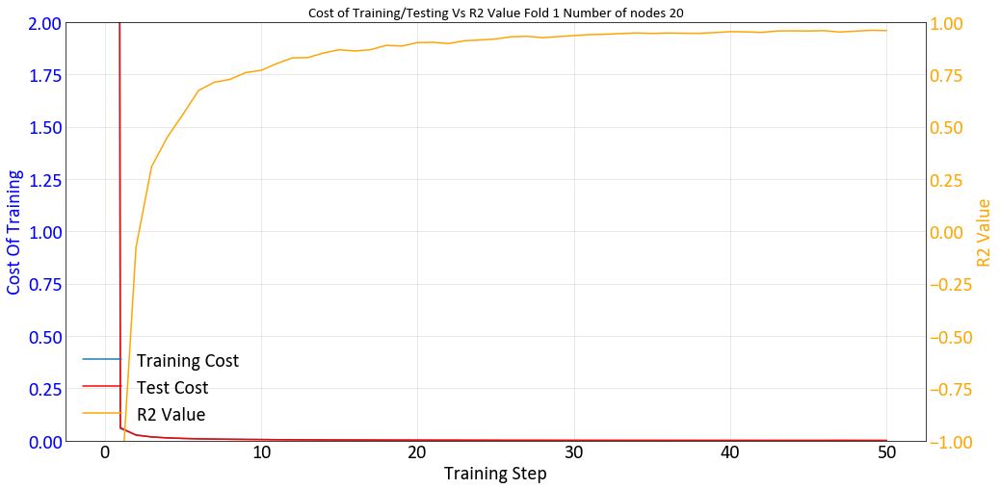

Working on Node 25 fold 1 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpou183l8b', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0FFCC630>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 68.7130126953125
Cost_test : 60.387333
R^2:-2794.1697998046875
Epoch: 100/5000 err = 0.06347747333347797
Cost_test : 0.066044874
R^2:-1.5379942655563354
Epoch: 200/5000 err = 0.024892614223062992
Cost_test : 0.024639245
R^2:-0.021539926528930664
Epoch: 300/5000 err = 0.016294931061565876
Cost_test : 0.017621212
R^2:0.345527321100235
Epoch: 400/5000 err = 0.012651753146201372
Cost_test : 0.013977338
R^2:0.4715231955051422
Epoch: 500/5000 err = 0.010517963208258152
Cost_test : 0.011538418
R^2:0.5930481255054474
Epoch: 600/5000 err = 0.009338689967989922
Cost_test : 0.009662182
R^2:0.6490727365016937
Epoch: 700/5000 err = 0.007030056556686759
Cost_test : 0.008148735
R^2:0.7137949764728546
Epoch: 800/5000 err = 0.0060192018281668425
Cost_test : 0.0068164254
R^2:0.7583004236221313
Epoch: 900/5000 err = 0.004895782098174095
Cost_test : 0.0057434794
R^2:0.802048534154892
Epoch: 1000/5000 err = 0.004127907799556851
Cost_test : 0.0048889196
R^2:0.830719530582428
Epoch: 1100/

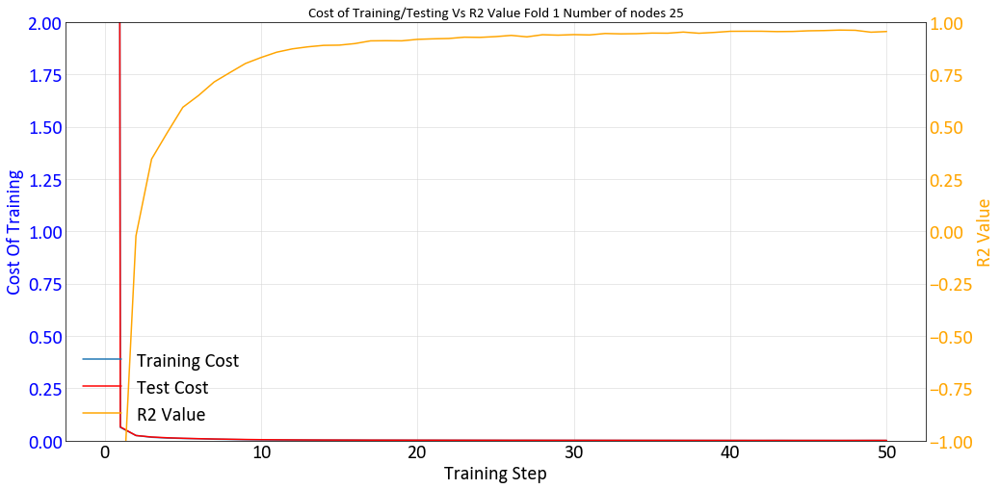

-1.7424
2.7666
2
Working on Node 10 fold 2 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpeypxiq_w', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F1314FB70>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 34.4543342590332
Cost_test : 31.70993
R^2:-1409.06982421875
Epoch: 100/5000 err = 0.04841012507677078
Cost_test : 0.051021945
R^2:-0.9355311989784241
Epoch: 200/5000 err = 0.019956737756729126
Cost_test : 0.020233022
R^2:0.19203993678092957
Epoch: 300/5000 err = 0.014153636060655117
Cost_test : 0.015192679
R^2:0.4408869743347168
Epoch: 400/5000 err = 0.011684744618833065
Cost_test : 0.0135496
R^2:0.5377018451690674
Epoch: 500/5000 err = 0.011399476323276758
Cost_test : 0.012475281
R^2:0.545912891626358
Epoch: 600/5000 err = 0.010311095509678125
Cost_test : 0.011568665
R^2:0.6047326028347015
Epoch: 700/5000 err = 0.01037796214222908
Cost_test : 0.010735473
R^2:0.5935466587543488
Epoch: 800/5000 err = 0.00873212469741702
Cost_test : 0.009961208
R^2:0.6497094035148621
Epoch: 900/5000 err = 0.008191660977900028
Cost_test : 0.009319294
R^2:0.6625668108463287
Epoch: 1000/5000 err = 0.007490368327125907
Cost_test : 0.00872173
R^2:0.699133962392807
Epoch: 1100/5000 err = 0.

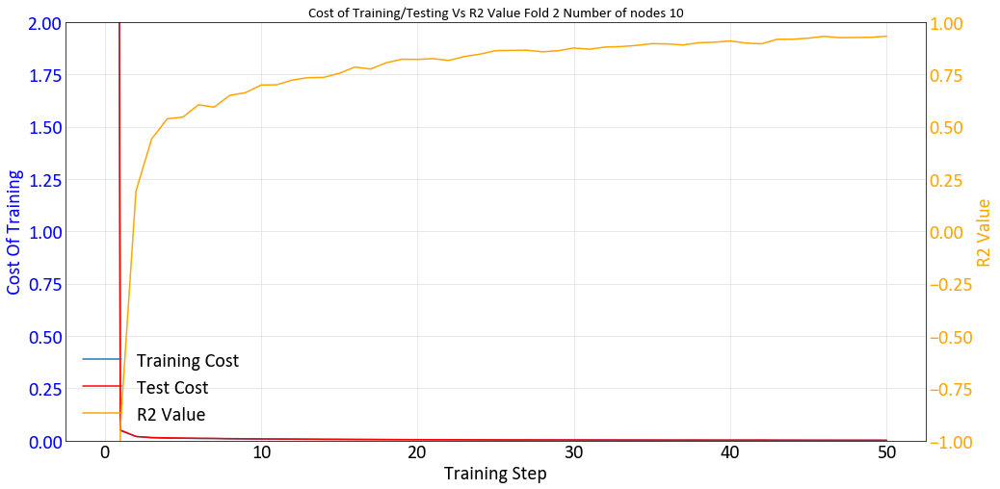

Working on Node 15 fold 2 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpbmj7wmbe', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0ED4C828>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 48.931352615356445
Cost_test : 44.234833
R^2:-1987.8028564453125
Epoch: 100/5000 err = 0.05025346949696541
Cost_test : 0.0534507
R^2:-1.0658890008926392
Epoch: 200/5000 err = 0.019662335515022278
Cost_test : 0.022110654
R^2:0.22150376439094543
Epoch: 300/5000 err = 0.013642428908497095
Cost_test : 0.015722904
R^2:0.5017193257808685
Epoch: 400/5000 err = 0.010184666141867638
Cost_test : 0.012626663
R^2:0.6097977757453918
Epoch: 500/5000 err = 0.008734269998967648
Cost_test : 0.010906866
R^2:0.6225038766860962
Epoch: 600/5000 err = 0.007606797618791461
Cost_test : 0.009688975
R^2:0.7063129842281342
Epoch: 700/5000 err = 0.007311224937438965
Cost_test : 0.008707842
R^2:0.6970769762992859
Epoch: 800/5000 err = 0.006317271618172526
Cost_test : 0.007842968
R^2:0.7576704919338226
Epoch: 900/5000 err = 0.005584410158917308
Cost_test : 0.007140536
R^2:0.780538409948349
Epoch: 1000/5000 err = 0.0050089722499251366
Cost_test : 0.0064915023
R^2:0.7953172922134399
Epoch: 1100/50

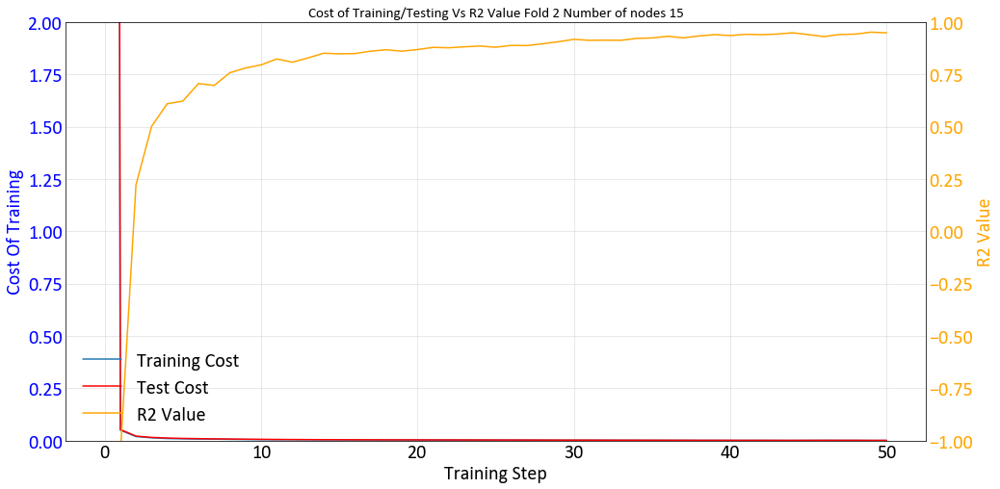

Working on Node 20 fold 2 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp7gw95249', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F5A5F98>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 74.70448684692383
Cost_test : 68.50539
R^2:-3027.430908203125
Epoch: 100/5000 err = 0.08783401176333427
Cost_test : 0.09671253
R^2:-2.5699210166931152
Epoch: 200/5000 err = 0.02641982026398182
Cost_test : 0.027966136
R^2:-0.1188773512840271
Epoch: 300/5000 err = 0.0182565338909626
Cost_test : 0.019104652
R^2:0.2751239240169525
Epoch: 400/5000 err = 0.014209581073373556
Cost_test : 0.015559622
R^2:0.45612943172454834
Epoch: 500/5000 err = 0.012026194483041763
Cost_test : 0.013218883
R^2:0.5237343907356262
Epoch: 600/5000 err = 0.009607951156795025
Cost_test : 0.0114325
R^2:0.6315802931785583
Epoch: 700/5000 err = 0.008553136605769396
Cost_test : 0.0099492045
R^2:0.6744373440742493
Epoch: 800/5000 err = 0.007621535332873464
Cost_test : 0.008772168
R^2:0.7100074291229248
Epoch: 900/5000 err = 0.006837786175310612
Cost_test : 0.007755246
R^2:0.7200913429260254
Epoch: 1000/5000 err = 0.006240720162168145
Cost_test : 0.0069283326
R^2:0.7564072012901306
Epoch: 1100/5000 er

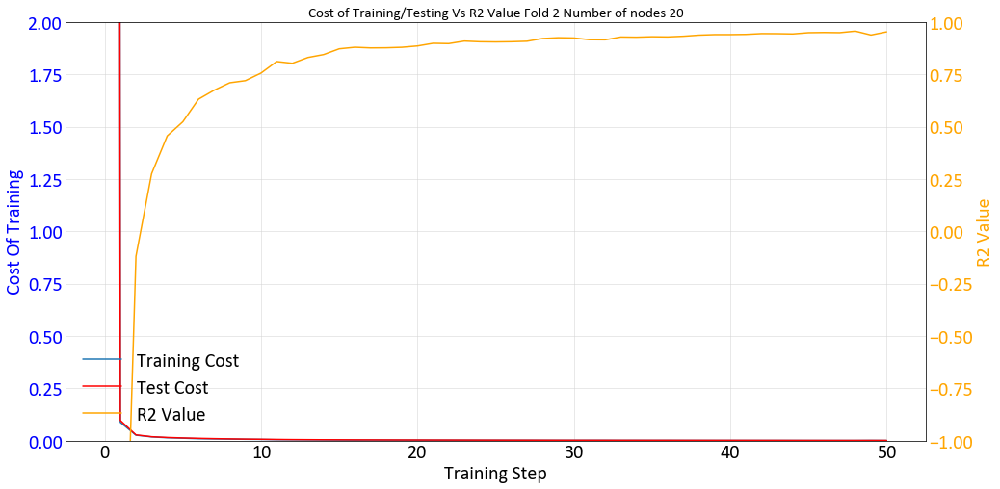

Working on Node 25 fold 2 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp98dj2zke', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0D545AC8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 70.59667205810547
Cost_test : 62.486187
R^2:-2751.7763671875
Epoch: 100/5000 err = 0.07103032246232033
Cost_test : 0.07989354
R^2:-1.8071001768112183
Epoch: 200/5000 err = 0.02052378375083208
Cost_test : 0.02292389
R^2:0.2022877037525177
Epoch: 300/5000 err = 0.013954501133412123
Cost_test : 0.015601836
R^2:0.4655751883983612
Epoch: 400/5000 err = 0.010120369028300047
Cost_test : 0.01260556
R^2:0.6075960695743561
Epoch: 500/5000 err = 0.008754635695368052
Cost_test : 0.010446139
R^2:0.6503645181655884
Epoch: 600/5000 err = 0.007446348434314132
Cost_test : 0.008997375
R^2:0.7051044702529907
Epoch: 700/5000 err = 0.006973635172471404
Cost_test : 0.007960886
R^2:0.738816112279892
Epoch: 800/5000 err = 0.005601071752607822
Cost_test : 0.007129406
R^2:0.7632142901420593
Epoch: 900/5000 err = 0.005585311679169536
Cost_test : 0.0064316685
R^2:0.7813660204410553
Epoch: 1000/5000 err = 0.004897257778793573
Cost_test : 0.0058544865
R^2:0.8073600828647614
Epoch: 1100/5000 err 

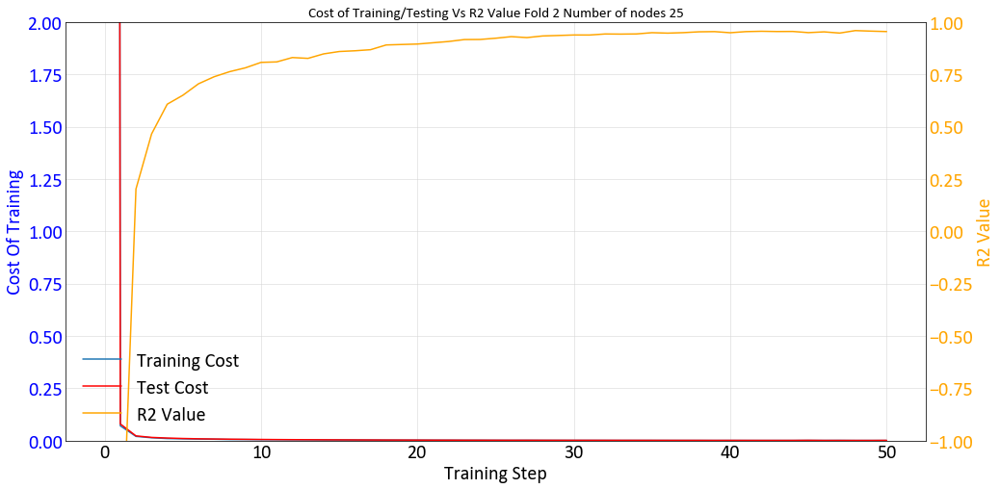

-1.7424
2.7666
3
Working on Node 10 fold 3 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp8_75rm1t', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F131DF5C0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 31.576638221740723
Cost_test : 30.497244
R^2:-1222.0066528320312
Epoch: 100/5000 err = 0.06407737173140049
Cost_test : 0.0701684
R^2:-1.5928266048431396
Epoch: 200/5000 err = 0.029618912376463413
Cost_test : 0.034027867
R^2:-0.13434815406799316
Epoch: 300/5000 err = 0.018094005063176155
Cost_test : 0.022847708
R^2:0.24491608142852783
Epoch: 400/5000 err = 0.015880368649959564
Cost_test : 0.0182957
R^2:0.3787666857242584
Epoch: 500/5000 err = 0.013237806502729654
Cost_test : 0.015416036
R^2:0.43973517417907715
Epoch: 600/5000 err = 0.011057656724005938
Cost_test : 0.01330239
R^2:0.5434703230857849
Epoch: 700/5000 err = 0.00938371242955327
Cost_test : 0.011616109
R^2:0.6306741237640381
Epoch: 800/5000 err = 0.008661055471748114
Cost_test : 0.010167644
R^2:0.6388904452323914
Epoch: 900/5000 err = 0.007324253441765904
Cost_test : 0.009087567
R^2:0.7022848725318909
Epoch: 1000/5000 err = 0.007431690348312259
Cost_test : 0.008049898
R^2:0.6879183351993561
Epoch: 1100/5000

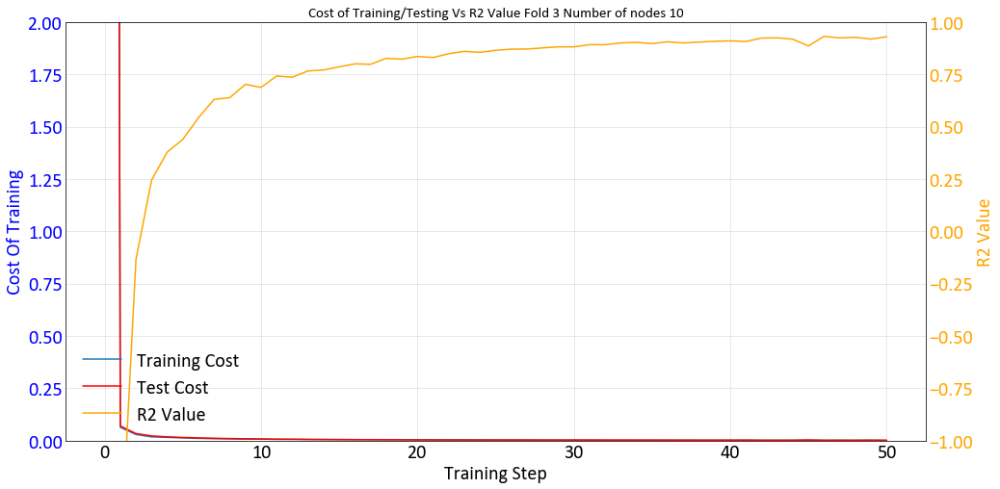

Working on Node 15 fold 3 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpchfs7jcw', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022ED9498D30>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 17.380367755889893
Cost_test : 15.766054
R^2:-738.3179321289062
Epoch: 100/5000 err = 0.03706555627286434
Cost_test : 0.03940301
R^2:-0.5635432600975037
Epoch: 200/5000 err = 0.01876996550709009
Cost_test : 0.022047475
R^2:0.24818074703216553
Epoch: 300/5000 err = 0.013394451700150967
Cost_test : 0.014969649
R^2:0.45336318016052246
Epoch: 400/5000 err = 0.010802977718412876
Cost_test : 0.012136448
R^2:0.5672376155853271
Epoch: 500/5000 err = 0.009367845952510834
Cost_test : 0.0106928125
R^2:0.6220764219760895
Epoch: 600/5000 err = 0.00830935500562191
Cost_test : 0.009441418
R^2:0.6587571501731873
Epoch: 700/5000 err = 0.007693693973124027
Cost_test : 0.008421714
R^2:0.7019871771335602
Epoch: 800/5000 err = 0.006767034763470292
Cost_test : 0.007648012
R^2:0.7243576049804688
Epoch: 900/5000 err = 0.006074226228520274
Cost_test : 0.0069569526
R^2:0.7299585938453674
Epoch: 1000/5000 err = 0.005698958644643426
Cost_test : 0.006355992
R^2:0.7641216516494751
Epoch: 1100/50

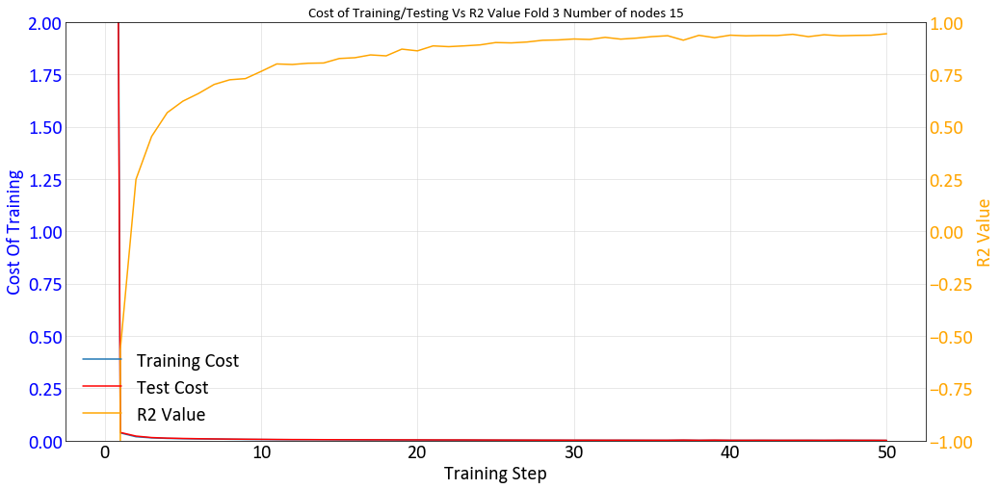

Working on Node 20 fold 3 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpl38h85c1', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0D48BBA8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 75.46073532104492
Cost_test : 70.645546
R^2:-3052.855712890625
Epoch: 100/5000 err = 0.0788119025528431
Cost_test : 0.068782225
R^2:-2.3098862171173096
Epoch: 200/5000 err = 0.027456450276076794
Cost_test : 0.03023112
R^2:-0.16368955373764038
Epoch: 300/5000 err = 0.019438770599663258
Cost_test : 0.02047588
R^2:0.23455524444580078
Epoch: 400/5000 err = 0.014423744287341833
Cost_test : 0.015019381
R^2:0.4255693256855011
Epoch: 500/5000 err = 0.013552804477512836
Cost_test : 0.011866671
R^2:0.4889621436595917
Epoch: 600/5000 err = 0.0107670733705163
Cost_test : 0.009959468
R^2:0.5867468118667603
Epoch: 700/5000 err = 0.008515742141753435
Cost_test : 0.008757516
R^2:0.667008101940155
Epoch: 800/5000 err = 0.00780136720277369
Cost_test : 0.007900905
R^2:0.6779287457466125
Epoch: 900/5000 err = 0.007068256381899118
Cost_test : 0.0071783843
R^2:0.7142844796180725
Epoch: 1000/5000 err = 0.006363090826198459
Cost_test : 0.0065829786
R^2:0.7126409411430359
Epoch: 1100/5000 e

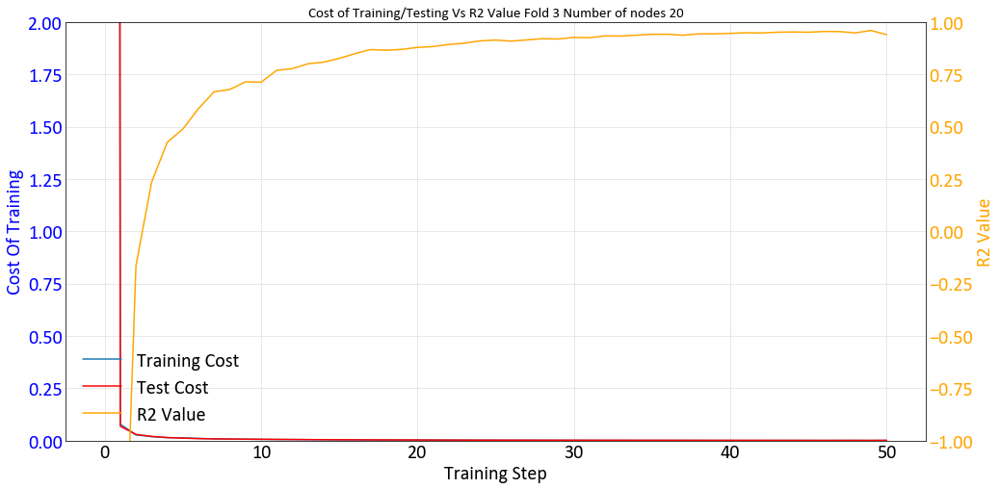

Working on Node 25 fold 3 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpsckxyb96', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0D5EB5C0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 109.7295150756836
Cost_test : 101.90195
R^2:-4427.9954833984375
Epoch: 100/5000 err = 0.11481160670518875
Cost_test : 0.100669876
R^2:-3.8398070335388184
Epoch: 200/5000 err = 0.026560389436781406
Cost_test : 0.024269663
R^2:-0.07763683795928955
Epoch: 300/5000 err = 0.01914354506880045
Cost_test : 0.017324332
R^2:0.24667739868164062
Epoch: 400/5000 err = 0.01537121320143342
Cost_test : 0.014451462
R^2:0.36133551597595215
Epoch: 500/5000 err = 0.013586718589067459
Cost_test : 0.01260566
R^2:0.45187467336654663
Epoch: 600/5000 err = 0.011887689586728811
Cost_test : 0.011230917
R^2:0.5001221001148224
Epoch: 700/5000 err = 0.009692845866084099
Cost_test : 0.010000507
R^2:0.5797840058803558
Epoch: 800/5000 err = 0.009235688485205173
Cost_test : 0.009082678
R^2:0.642730712890625
Epoch: 900/5000 err = 0.007983830058947206
Cost_test : 0.008287351
R^2:0.6632547378540039
Epoch: 1000/5000 err = 0.008174051996320486
Cost_test : 0.007589823
R^2:0.6714875102043152
Epoch: 1100/50

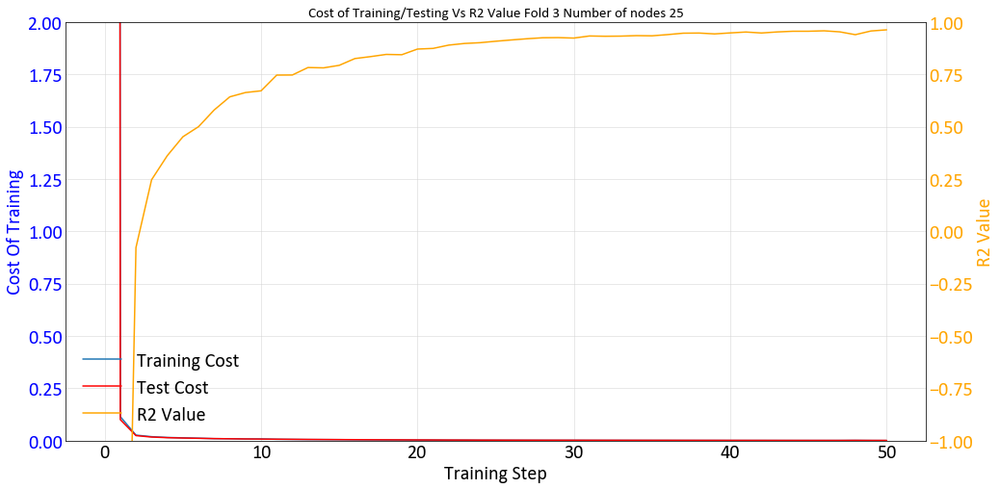

-1.7424
2.7666
4
Working on Node 10 fold 4 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpn8kf82mj', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0EC8C390>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 33.74546241760254
Cost_test : 29.994282
R^2:-1481.3502807617188
Epoch: 100/5000 err = 0.06335831992328167
Cost_test : 0.07272456
R^2:-1.6282652616500854
Epoch: 200/5000 err = 0.03138127736747265
Cost_test : 0.037680972
R^2:-0.2563297152519226
Epoch: 300/5000 err = 0.02114066109061241
Cost_test : 0.028536556
R^2:0.13765573501586914
Epoch: 400/5000 err = 0.020640244707465172
Cost_test : 0.023071852
R^2:0.1391056776046753
Epoch: 500/5000 err = 0.014813524670898914
Cost_test : 0.018563708
R^2:0.38437357544898987
Epoch: 600/5000 err = 0.012446477077901363
Cost_test : 0.015221001
R^2:0.5160263478755951
Epoch: 700/5000 err = 0.011413452681154013
Cost_test : 0.012773146
R^2:0.5457320809364319
Epoch: 800/5000 err = 0.00939180376008153
Cost_test : 0.010946844
R^2:0.6074076592922211
Epoch: 900/5000 err = 0.007969660218805075
Cost_test : 0.0096908035
R^2:0.6765695512294769
Epoch: 1000/5000 err = 0.007296899100765586
Cost_test : 0.008591642
R^2:0.7010577917098999
Epoch: 1100/500

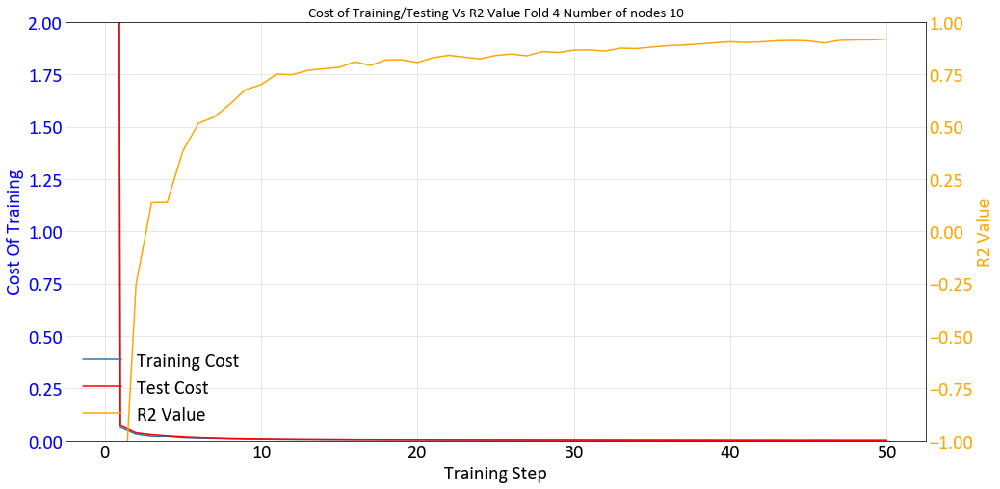

Working on Node 15 fold 4 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpgjhzva0u', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F10003278>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 94.45684814453125
Cost_test : 85.14146
R^2:-3902.9195556640625
Epoch: 100/5000 err = 0.10146692767739296
Cost_test : 0.11916348
R^2:-3.234830617904663
Epoch: 200/5000 err = 0.03005567379295826
Cost_test : 0.034937203
R^2:-0.2649688720703125
Epoch: 300/5000 err = 0.0180122721940279
Cost_test : 0.020841584
R^2:0.2942553758621216
Epoch: 400/5000 err = 0.013619077391922474
Cost_test : 0.015218564
R^2:0.4419881999492645
Epoch: 500/5000 err = 0.011034772265702486
Cost_test : 0.012219302
R^2:0.5749407708644867
Epoch: 600/5000 err = 0.00923699140548706
Cost_test : 0.0101466095
R^2:0.6387775540351868
Epoch: 700/5000 err = 0.007878117728978395
Cost_test : 0.008727346
R^2:0.6836313307285309
Epoch: 800/5000 err = 0.006872453959658742
Cost_test : 0.0077245045
R^2:0.7254382073879242
Epoch: 900/5000 err = 0.006760375807061791
Cost_test : 0.0069810376
R^2:0.7325242161750793
Epoch: 1000/5000 err = 0.006501252995803952
Cost_test : 0.006427469
R^2:0.747909277677536
Epoch: 1100/5000 er

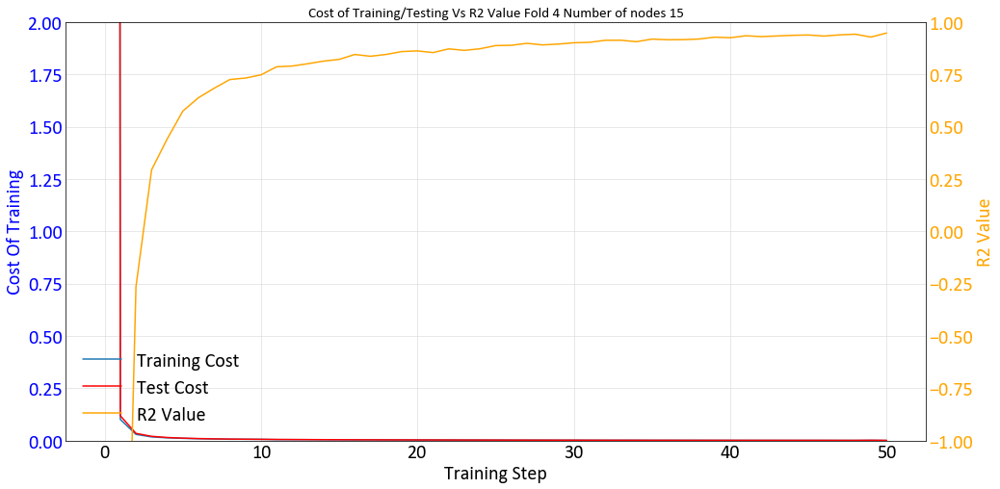

Working on Node 20 fold 4 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp1vvuaoa2', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022ED9565470>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 106.14872360229492
Cost_test : 97.2961
R^2:-4257.8704833984375
Epoch: 100/5000 err = 0.119975246489048
Cost_test : 0.124210365
R^2:-4.134099245071411
Epoch: 200/5000 err = 0.02890171017497778
Cost_test : 0.032153204
R^2:-0.13243991136550903
Epoch: 300/5000 err = 0.01712612807750702
Cost_test : 0.019563762
R^2:0.3147757053375244
Epoch: 400/5000 err = 0.013638554140925407
Cost_test : 0.016020235
R^2:0.42629143595695496
Epoch: 500/5000 err = 0.011724987532943487
Cost_test : 0.013408878
R^2:0.5189175009727478
Epoch: 600/5000 err = 0.010868164245039225
Cost_test : 0.011398051
R^2:0.5698080360889435
Epoch: 700/5000 err = 0.009502708911895752
Cost_test : 0.009896663
R^2:0.613610565662384
Epoch: 800/5000 err = 0.007849160581827164
Cost_test : 0.008720965
R^2:0.6624823808670044
Epoch: 900/5000 err = 0.007063774392008781
Cost_test : 0.007828228
R^2:0.6969148218631744
Epoch: 1000/5000 err = 0.0071344152092933655
Cost_test : 0.0070854146
R^2:0.724930614233017
Epoch: 1100/5000 e

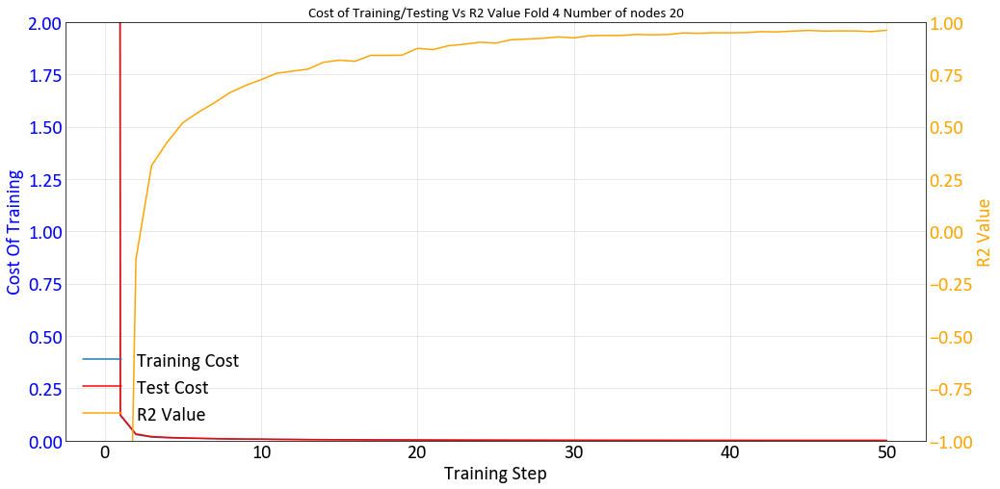

Working on Node 25 fold 4 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpk5t6r537', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0ECEEA58>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 168.8370819091797
Cost_test : 152.48068
R^2:-6899.132568359375
Epoch: 100/5000 err = 0.22996831685304642
Cost_test : 0.2422988
R^2:-8.558184146881104
Epoch: 200/5000 err = 0.047045158222317696
Cost_test : 0.045857023
R^2:-0.9771574139595032
Epoch: 300/5000 err = 0.02111832145601511
Cost_test : 0.022524932
R^2:0.11675000190734863
Epoch: 400/5000 err = 0.014755703508853912
Cost_test : 0.0153086465
R^2:0.41779255867004395
Epoch: 500/5000 err = 0.011803063098341227
Cost_test : 0.012619219
R^2:0.5001505017280579
Epoch: 600/5000 err = 0.010637253522872925
Cost_test : 0.010938851
R^2:0.5840364694595337
Epoch: 700/5000 err = 0.009868018794804811
Cost_test : 0.009720634
R^2:0.5877460837364197
Epoch: 800/5000 err = 0.008316901046782732
Cost_test : 0.008740616
R^2:0.6630586087703705
Epoch: 900/5000 err = 0.007592138834297657
Cost_test : 0.007919408
R^2:0.7095775604248047
Epoch: 1000/5000 err = 0.006871580611914396
Cost_test : 0.0072206594
R^2:0.7266464531421661
Epoch: 1100/500

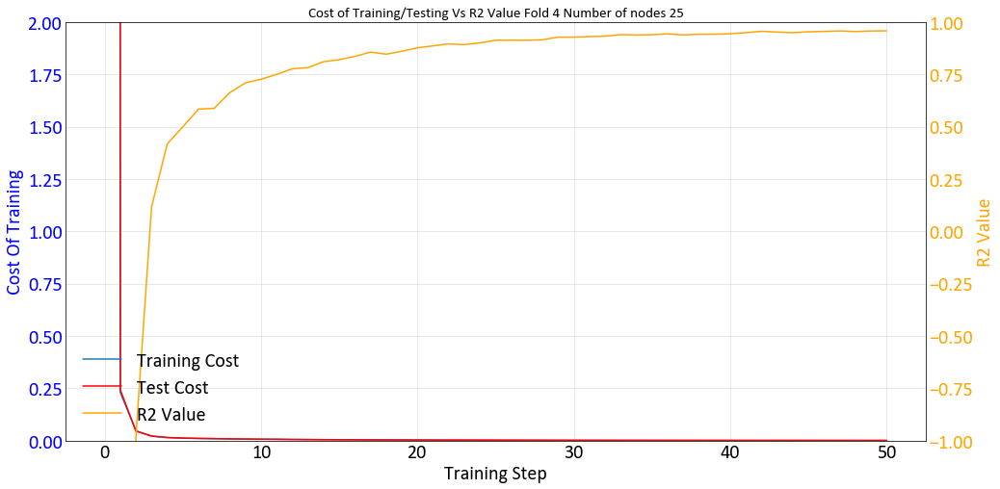

-1.7424
2.7666
5
Working on Node 10 fold 5 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpp181un_k', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0FAB4D68>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 47.35726547241211
Cost_test : 43.20137
R^2:-1879.7496337890625
Epoch: 100/5000 err = 0.048646362498402596
Cost_test : 0.04807888
R^2:-0.9916621446609497
Epoch: 200/5000 err = 0.022649780847132206
Cost_test : 0.021081582
R^2:0.05521133542060852
Epoch: 300/5000 err = 0.017186634242534637
Cost_test : 0.01725563
R^2:0.30247819423675537
Epoch: 400/5000 err = 0.014903151895850897
Cost_test : 0.015495178
R^2:0.4225977659225464
Epoch: 500/5000 err = 0.013405903242528439
Cost_test : 0.013682682
R^2:0.4629213511943817
Epoch: 600/5000 err = 0.011192664038389921
Cost_test : 0.011358488
R^2:0.5578892230987549
Epoch: 700/5000 err = 0.009672795422375202
Cost_test : 0.009551606
R^2:0.5869452953338623
Epoch: 800/5000 err = 0.009041501674801111
Cost_test : 0.008462194
R^2:0.6465408205986023
Epoch: 900/5000 err = 0.008039331762120128
Cost_test : 0.0076239114
R^2:0.6628980338573456
Epoch: 1000/5000 err = 0.0075471492018550634
Cost_test : 0.0069459607
R^2:0.6791722774505615
Epoch: 1100/

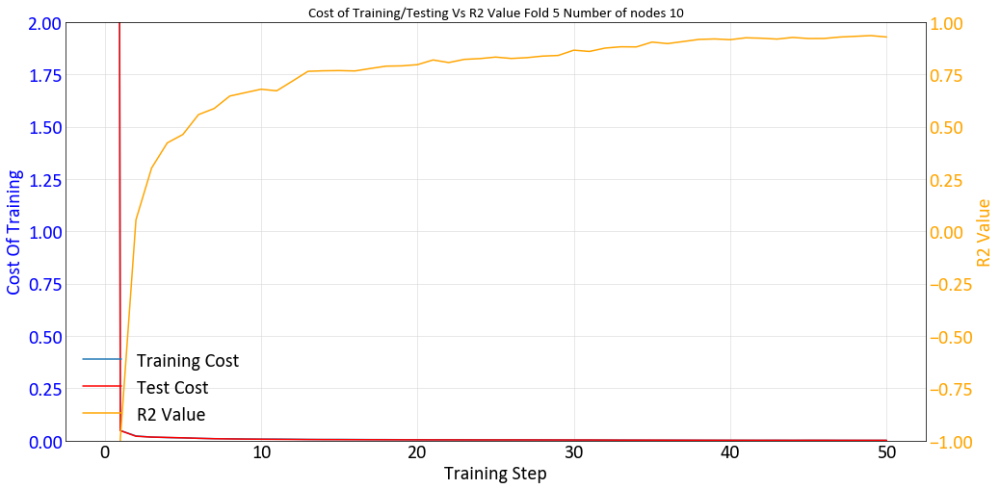

Working on Node 15 fold 5 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpfj45z15n', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0ED08EB8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 48.77058410644531
Cost_test : 43.733227
R^2:-1988.6739501953125
Epoch: 100/5000 err = 0.05153314396739006
Cost_test : 0.046150815
R^2:-1.1164480447769165
Epoch: 200/5000 err = 0.024108165875077248
Cost_test : 0.02121284
R^2:0.06326937675476074
Epoch: 300/5000 err = 0.01672527566552162
Cost_test : 0.015174256
R^2:0.31539714336395264
Epoch: 400/5000 err = 0.013518539723008871
Cost_test : 0.012066302
R^2:0.42463600635528564
Epoch: 500/5000 err = 0.009909897111356258
Cost_test : 0.010201022
R^2:0.5913856625556946
Epoch: 600/5000 err = 0.009465030394494534
Cost_test : 0.008885423
R^2:0.5861243605613708
Epoch: 700/5000 err = 0.00803152471780777
Cost_test : 0.007800073
R^2:0.6870447099208832
Epoch: 800/5000 err = 0.007418718887493014
Cost_test : 0.006883467
R^2:0.6934029459953308
Epoch: 900/5000 err = 0.0066743416246026754
Cost_test : 0.005998447
R^2:0.7312482297420502
Epoch: 1000/5000 err = 0.005773646989837289
Cost_test : 0.005347053
R^2:0.7646967172622681
Epoch: 1100/50

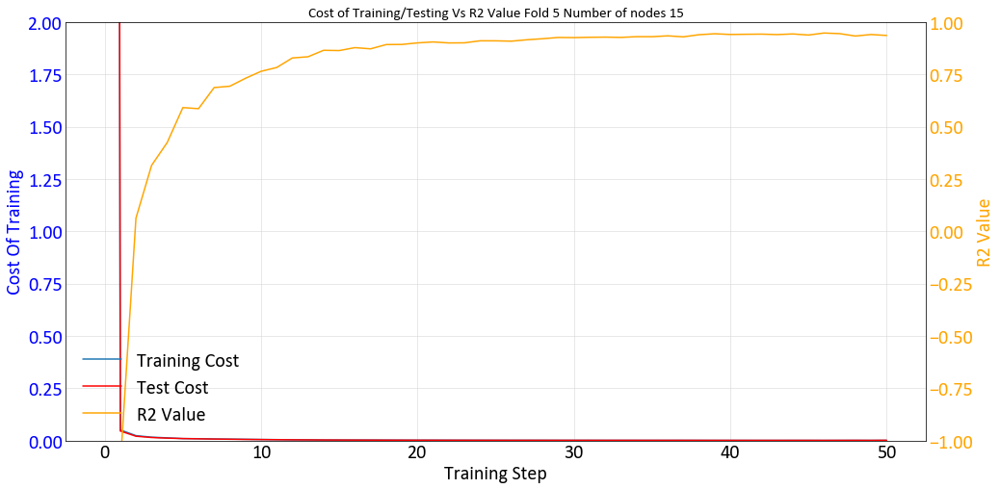

Working on Node 20 fold 5 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpet7s5p_4', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022ED95B7BE0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 28.50187873840332
Cost_test : 24.595716
R^2:-1197.2592163085938
Epoch: 100/5000 err = 0.024042381905019283
Cost_test : 0.020297801
R^2:0.05422741174697876
Epoch: 200/5000 err = 0.013724840711802244
Cost_test : 0.013094067
R^2:0.48289811611175537
Epoch: 300/5000 err = 0.011346208862960339
Cost_test : 0.011175479
R^2:0.5586892068386078
Epoch: 400/5000 err = 0.0097891497425735
Cost_test : 0.009566516
R^2:0.5895511507987976
Epoch: 500/5000 err = 0.007729855831712484
Cost_test : 0.008076428
R^2:0.6963403224945068
Epoch: 600/5000 err = 0.006844524294137955
Cost_test : 0.006882167
R^2:0.7284602522850037
Epoch: 700/5000 err = 0.006217082962393761
Cost_test : 0.0058493097
R^2:0.7674697041511536
Epoch: 800/5000 err = 0.005518895341083407
Cost_test : 0.004995574
R^2:0.7705570757389069
Epoch: 900/5000 err = 0.004549199948087335
Cost_test : 0.0041378625
R^2:0.8136739730834961
Epoch: 1000/5000 err = 0.004087483044713736
Cost_test : 0.0036901906
R^2:0.8287625908851624
Epoch: 1100/

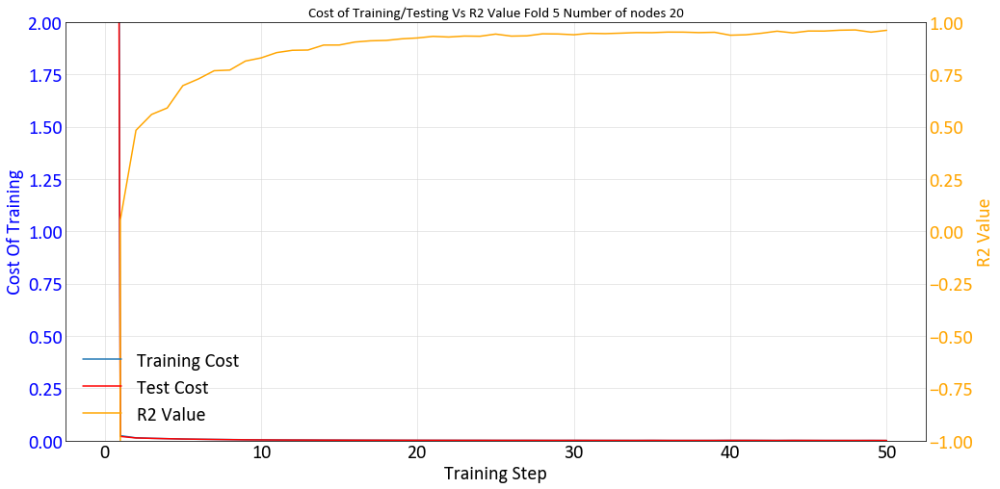

Working on Node 25 fold 5 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp2pmhaq75', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F12C40E80>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 61.61342430114746
Cost_test : 54.76753
R^2:-2422.6590576171875
Epoch: 100/5000 err = 0.062362879514694214
Cost_test : 0.04837574
R^2:-1.6453830003738403
Epoch: 200/5000 err = 0.02858508564531803
Cost_test : 0.023635633
R^2:-0.14327239990234375
Epoch: 300/5000 err = 0.018590785562992096
Cost_test : 0.016374893
R^2:0.24256721138954163
Epoch: 400/5000 err = 0.013382581062614918
Cost_test : 0.0122692175
R^2:0.47553083300590515
Epoch: 500/5000 err = 0.010309174656867981
Cost_test : 0.009666537
R^2:0.591670572757721
Epoch: 600/5000 err = 0.007609583204612136
Cost_test : 0.007825696
R^2:0.6973598301410675
Epoch: 700/5000 err = 0.006910397903993726
Cost_test : 0.006426735
R^2:0.7209505438804626
Epoch: 800/5000 err = 0.0059597531799227
Cost_test : 0.0052581723
R^2:0.7705037593841553
Epoch: 900/5000 err = 0.00468691042624414
Cost_test : 0.0044969036
R^2:0.8140376508235931
Epoch: 1000/5000 err = 0.004027597839012742
Cost_test : 0.003937159
R^2:0.8440091609954834
Epoch: 1100/50

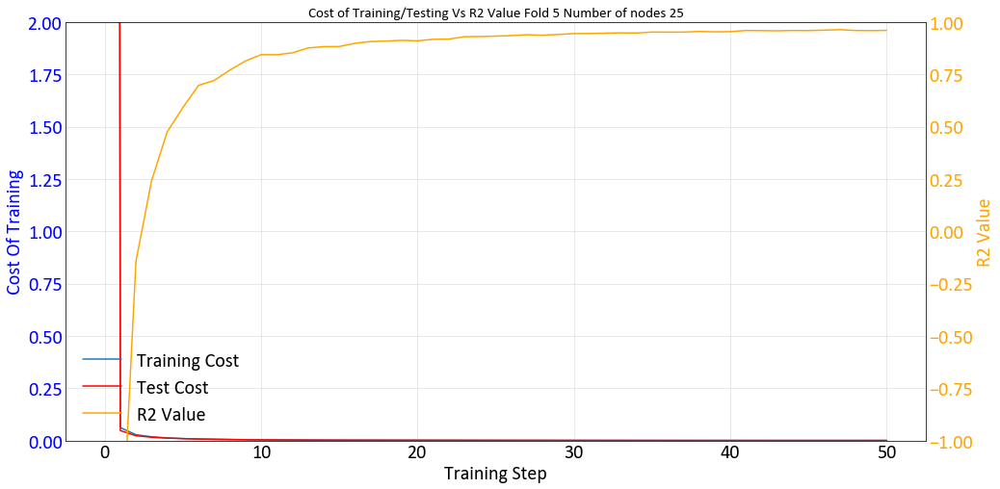

-1.7424
2.5579
6
Working on Node 10 fold 6 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmplkyl7bi0', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F12DD2F98>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 34.37297058105469
Cost_test : 32.570786
R^2:-1247.6473999023438
Epoch: 100/5000 err = 0.056916266679763794
Cost_test : 0.04614732
R^2:-0.9787652492523193
Epoch: 200/5000 err = 0.018117042258381844
Cost_test : 0.018450458
R^2:0.30365920066833496
Epoch: 300/5000 err = 0.014437992591410875
Cost_test : 0.015174686
R^2:0.47605660557746887
Epoch: 400/5000 err = 0.014000626280903816
Cost_test : 0.013359625
R^2:0.507453590631485
Epoch: 500/5000 err = 0.011223942041397095
Cost_test : 0.01214758
R^2:0.577340692281723
Epoch: 600/5000 err = 0.010651428252458572
Cost_test : 0.01124048
R^2:0.6387162804603577
Epoch: 700/5000 err = 0.010121858213096857
Cost_test : 0.01052495
R^2:0.5994971990585327
Epoch: 800/5000 err = 0.008595333900302649
Cost_test : 0.009937207
R^2:0.6856259107589722
Epoch: 900/5000 err = 0.008910569828003645
Cost_test : 0.0094766375
R^2:0.6661809682846069
Epoch: 1000/5000 err = 0.00806704256683588
Cost_test : 0.009050162
R^2:0.6950762569904327
Epoch: 1100/5000 e

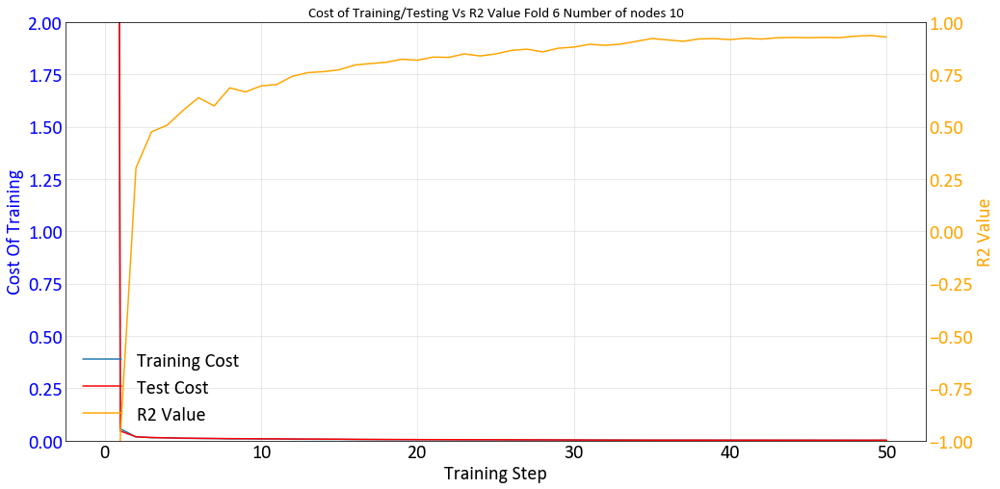

Working on Node 15 fold 6 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpb0htlzm3', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0CFD8358>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 41.386959075927734
Cost_test : 38.759716
R^2:-1481.5755615234375
Epoch: 100/5000 err = 0.04697190597653389
Cost_test : 0.04878032
R^2:-0.8634701371192932
Epoch: 200/5000 err = 0.019535918720066547
Cost_test : 0.019885369
R^2:0.2893059551715851
Epoch: 300/5000 err = 0.01476291473954916
Cost_test : 0.016017454
R^2:0.44062498211860657
Epoch: 400/5000 err = 0.011634840164333582
Cost_test : 0.014016276
R^2:0.5396637916564941
Epoch: 500/5000 err = 0.010044852271676064
Cost_test : 0.012405404
R^2:0.6252489686012268
Epoch: 600/5000 err = 0.009223256260156631
Cost_test : 0.01129491
R^2:0.6419325172901154
Epoch: 700/5000 err = 0.008543896488845348
Cost_test : 0.010235767
R^2:0.688716322183609
Epoch: 800/5000 err = 0.007624235702678561
Cost_test : 0.009517711
R^2:0.7224821448326111
Epoch: 900/5000 err = 0.006721704034134746
Cost_test : 0.008809513
R^2:0.7439155280590057
Epoch: 1000/5000 err = 0.006398808443918824
Cost_test : 0.008173988
R^2:0.7738683819770813
Epoch: 1100/5000 

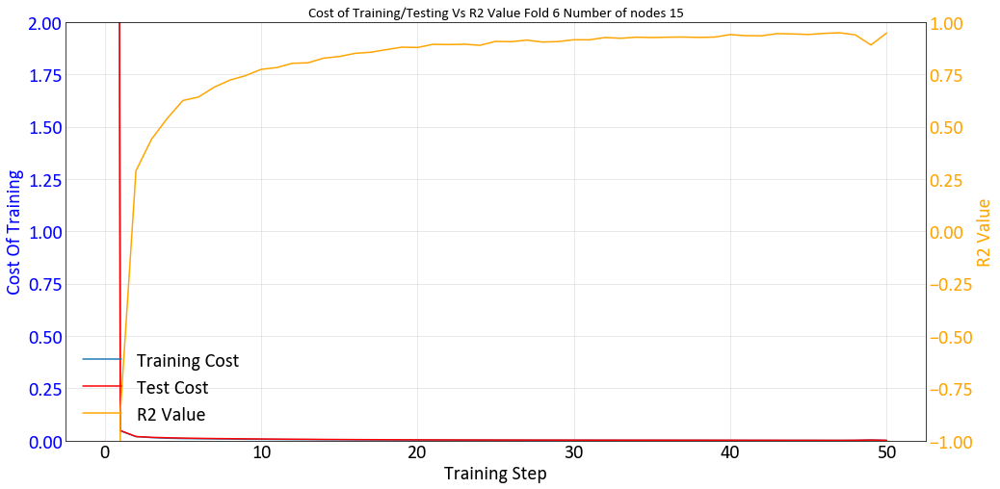

Working on Node 20 fold 6 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpf3565fqq', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022ED95CE860>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 48.40069007873535
Cost_test : 44.239613
R^2:-1744.2261352539062
Epoch: 100/5000 err = 0.031209128908813
Cost_test : 0.031488415
R^2:-0.17687219381332397
Epoch: 200/5000 err = 0.019259128719568253
Cost_test : 0.018354598
R^2:0.3076748251914978
Epoch: 300/5000 err = 0.014648077078163624
Cost_test : 0.015574826
R^2:0.4589606523513794
Epoch: 400/5000 err = 0.012173278257250786
Cost_test : 0.013367363
R^2:0.5540204048156738
Epoch: 500/5000 err = 0.009961378760635853
Cost_test : 0.011654761
R^2:0.6433466374874115
Epoch: 600/5000 err = 0.008433090522885323
Cost_test : 0.010246296
R^2:0.6850061416625977
Epoch: 700/5000 err = 0.007267112378031015
Cost_test : 0.009026041
R^2:0.7275407910346985
Epoch: 800/5000 err = 0.006772591266781092
Cost_test : 0.007938396
R^2:0.7529944777488708
Epoch: 900/5000 err = 0.005843778606504202
Cost_test : 0.0069124117
R^2:0.7787128686904907
Epoch: 1000/5000 err = 0.005881772842258215
Cost_test : 0.006090788
R^2:0.7953571081161499
Epoch: 1100/500

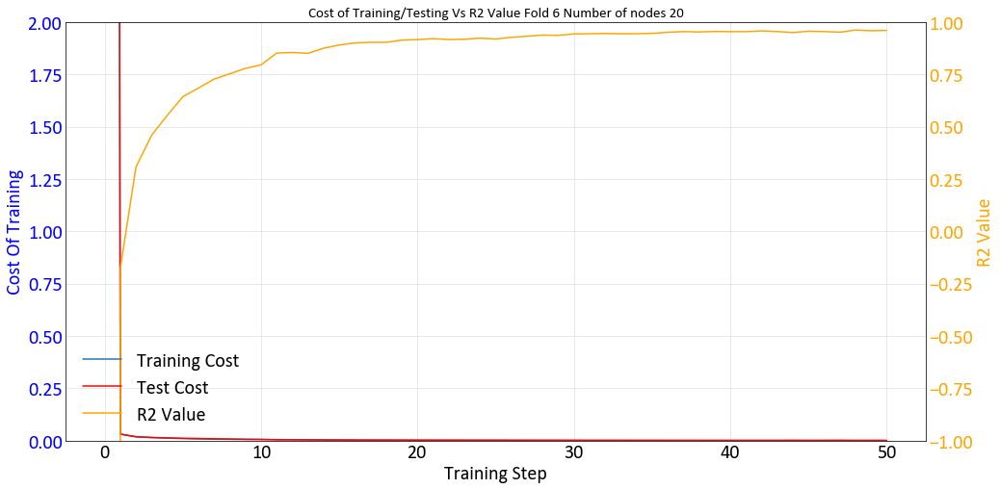

Working on Node 25 fold 6 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmptuesdl3o', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022ED96A27F0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 143.2800064086914
Cost_test : 135.02953
R^2:-5308.018798828125
Epoch: 100/5000 err = 0.1393187865614891
Cost_test : 0.13096552
R^2:-4.081141948699951
Epoch: 200/5000 err = 0.02848472911864519
Cost_test : 0.026234098
R^2:-0.0778656005859375
Epoch: 300/5000 err = 0.018573638051748276
Cost_test : 0.018533329
R^2:0.3477208614349365
Epoch: 400/5000 err = 0.013180258218199015
Cost_test : 0.015255639
R^2:0.5077804028987885
Epoch: 500/5000 err = 0.011795269791036844
Cost_test : 0.013122691
R^2:0.5556841194629669
Epoch: 600/5000 err = 0.011023018043488264
Cost_test : 0.01159853
R^2:0.5801467001438141
Epoch: 700/5000 err = 0.009411596693098545
Cost_test : 0.010387096
R^2:0.6703265905380249
Epoch: 800/5000 err = 0.008258878253400326
Cost_test : 0.009350017
R^2:0.6859291195869446
Epoch: 900/5000 err = 0.007151206023991108
Cost_test : 0.008448464
R^2:0.7486271560192108
Epoch: 1000/5000 err = 0.006687467452138662
Cost_test : 0.0076822513
R^2:0.7567682266235352
Epoch: 1100/5000 er

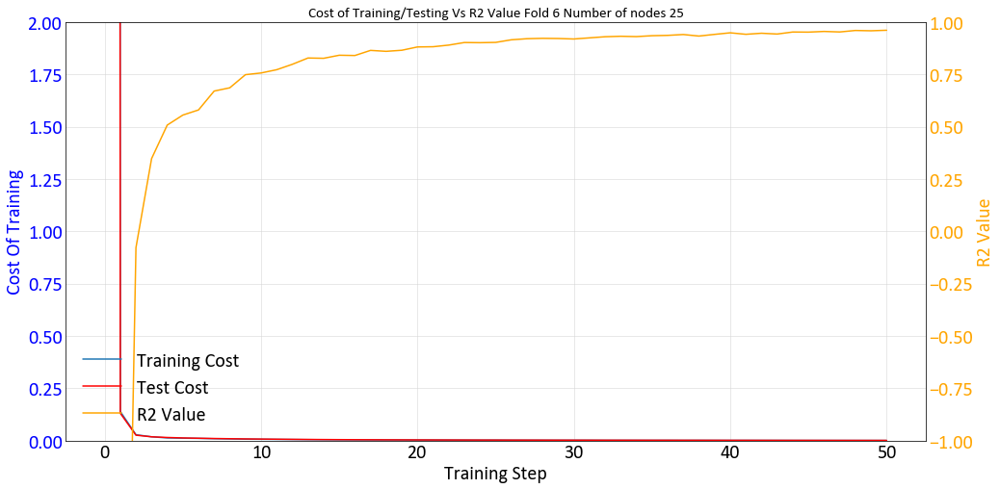

-1.7424
2.5579
7
Working on Node 10 fold 7 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp_15kgivk', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F718E80>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 41.328115463256836
Cost_test : 39.271687
R^2:-1562.315673828125
Epoch: 100/5000 err = 0.0467502698302269
Cost_test : 0.048188657
R^2:-0.6653868556022644
Epoch: 200/5000 err = 0.026045314967632294
Cost_test : 0.030269703
R^2:0.06945762038230896
Epoch: 300/5000 err = 0.02196194976568222
Cost_test : 0.024380593
R^2:0.16978010535240173
Epoch: 400/5000 err = 0.017672100104391575
Cost_test : 0.020235272
R^2:0.3376185894012451
Epoch: 500/5000 err = 0.013553335797041655
Cost_test : 0.01715695
R^2:0.4900987148284912
Epoch: 600/5000 err = 0.013547005597501993
Cost_test : 0.014878516
R^2:0.525396466255188
Epoch: 700/5000 err = 0.012319010216742754
Cost_test : 0.013279207
R^2:0.519275426864624
Epoch: 800/5000 err = 0.010072468314319849
Cost_test : 0.011877087
R^2:0.6264531910419464
Epoch: 900/5000 err = 0.009569393936544657
Cost_test : 0.010857846
R^2:0.6639890074729919
Epoch: 1000/5000 err = 0.008054063189774752
Cost_test : 0.010070877
R^2:0.6864363253116608
Epoch: 1100/5000 e

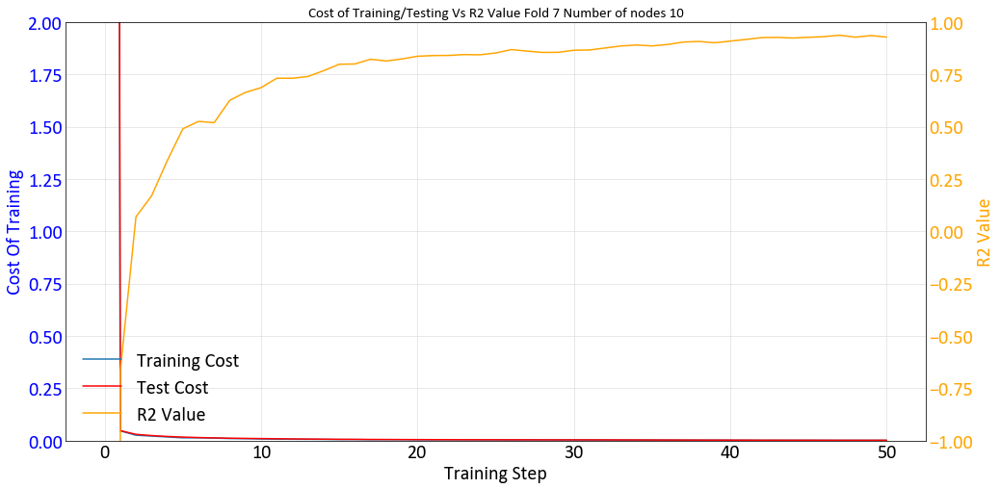

Working on Node 15 fold 7 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp4crrq0jx', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0D8270B8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 103.67251205444336
Cost_test : 99.04974
R^2:-3694.2667236328125
Epoch: 100/5000 err = 0.1209380216896534
Cost_test : 0.13647237
R^2:-3.333972692489624
Epoch: 200/5000 err = 0.034383127465844154
Cost_test : 0.03510222
R^2:-0.23737049102783203
Epoch: 300/5000 err = 0.018871516920626163
Cost_test : 0.02134089
R^2:0.2664986252784729
Epoch: 400/5000 err = 0.01454606419429183
Cost_test : 0.016566748
R^2:0.42772528529167175
Epoch: 500/5000 err = 0.012078483123332262
Cost_test : 0.013925572
R^2:0.5399202704429626
Epoch: 600/5000 err = 0.011786795686930418
Cost_test : 0.012001056
R^2:0.5641989707946777
Epoch: 700/5000 err = 0.010200542863458395
Cost_test : 0.010562092
R^2:0.6250243484973907
Epoch: 800/5000 err = 0.0081543386913836
Cost_test : 0.009535289
R^2:0.6691426634788513
Epoch: 900/5000 err = 0.00786691578105092
Cost_test : 0.0086869085
R^2:0.7119970917701721
Epoch: 1000/5000 err = 0.007226710673421621
Cost_test : 0.007971503
R^2:0.7197554111480713
Epoch: 1100/5000 err

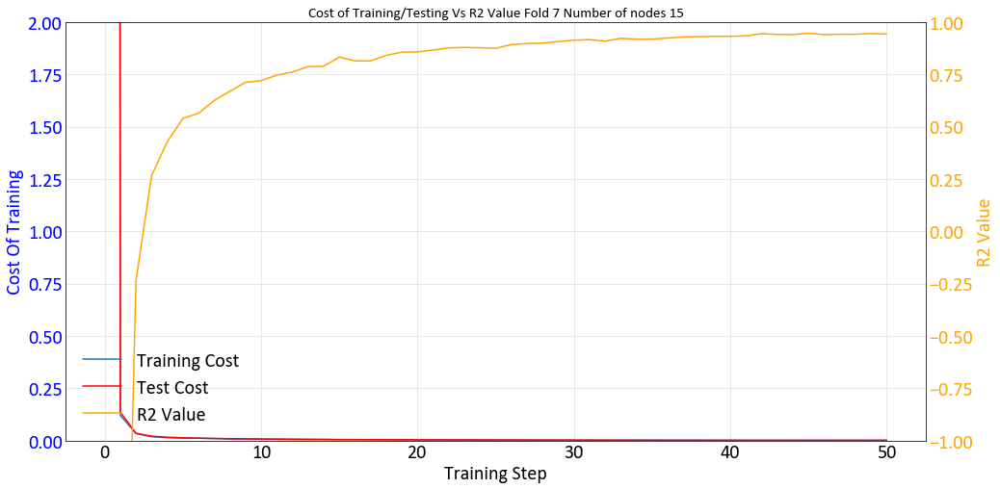

Working on Node 20 fold 7 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp766eq7lr', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E80AD8BE0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 56.17317199707031
Cost_test : 51.67427
R^2:-2213.4214477539062
Epoch: 100/5000 err = 0.04340907000005245
Cost_test : 0.05134358
R^2:-0.6430683732032776
Epoch: 200/5000 err = 0.02195592224597931
Cost_test : 0.025251452
R^2:0.23008683323860168
Epoch: 300/5000 err = 0.017972503788769245
Cost_test : 0.020147212
R^2:0.2831462323665619
Epoch: 400/5000 err = 0.014293643645942211
Cost_test : 0.01693966
R^2:0.4784291982650757
Epoch: 500/5000 err = 0.01157268462702632
Cost_test : 0.014099471
R^2:0.5481845438480377
Epoch: 600/5000 err = 0.01026481855660677
Cost_test : 0.011604758
R^2:0.617361843585968
Epoch: 700/5000 err = 0.008740592747926712
Cost_test : 0.009824195
R^2:0.66071617603302
Epoch: 800/5000 err = 0.007758874678984284
Cost_test : 0.0084332675
R^2:0.7091505825519562
Epoch: 900/5000 err = 0.0064997924491763115
Cost_test : 0.0074963532
R^2:0.75723996758461
Epoch: 1000/5000 err = 0.005697689484804869
Cost_test : 0.0067037083
R^2:0.785493403673172
Epoch: 1100/5000 err =

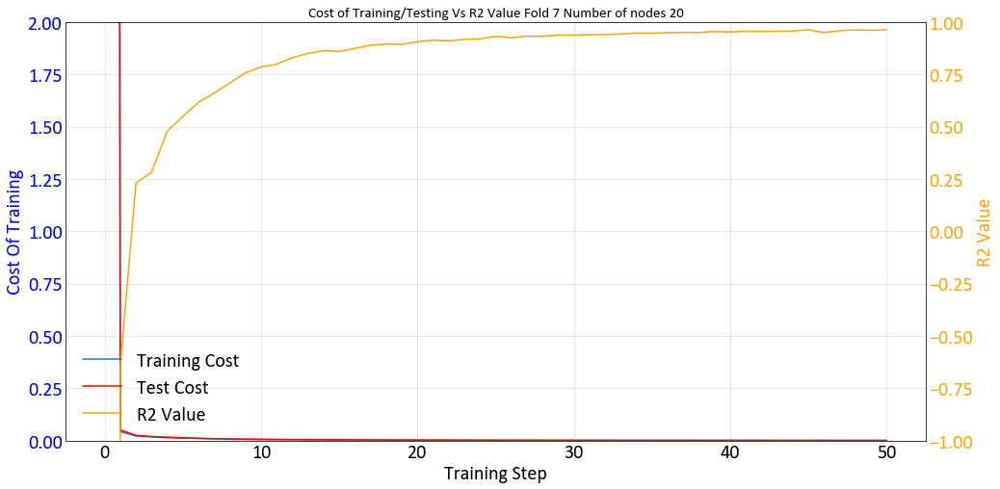

Working on Node 25 fold 7 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpy0ptgrxc', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F131653C8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 31.79012680053711
Cost_test : 27.760752
R^2:-1192.5506591796875
Epoch: 100/5000 err = 0.033328790217638016
Cost_test : 0.039047975
R^2:-0.17999082803726196
Epoch: 200/5000 err = 0.016730593983083963
Cost_test : 0.020071788
R^2:0.3888547420501709
Epoch: 300/5000 err = 0.013662525918334723
Cost_test : 0.015106207
R^2:0.4871220588684082
Epoch: 400/5000 err = 0.011072002816945314
Cost_test : 0.013053317
R^2:0.5905764997005463
Epoch: 500/5000 err = 0.008984499610960484
Cost_test : 0.0114859175
R^2:0.6533297002315521
Epoch: 600/5000 err = 0.007469084579497576
Cost_test : 0.010350419
R^2:0.7021164894104004
Epoch: 700/5000 err = 0.006358756683766842
Cost_test : 0.009312956
R^2:0.764408677816391
Epoch: 800/5000 err = 0.005715806502848864
Cost_test : 0.008036618
R^2:0.7923862636089325
Epoch: 900/5000 err = 0.004524248652160168
Cost_test : 0.0070127537
R^2:0.8312086760997772
Epoch: 1000/5000 err = 0.0038857540348544717
Cost_test : 0.005936416
R^2:0.8552380502223969
Epoch: 1100

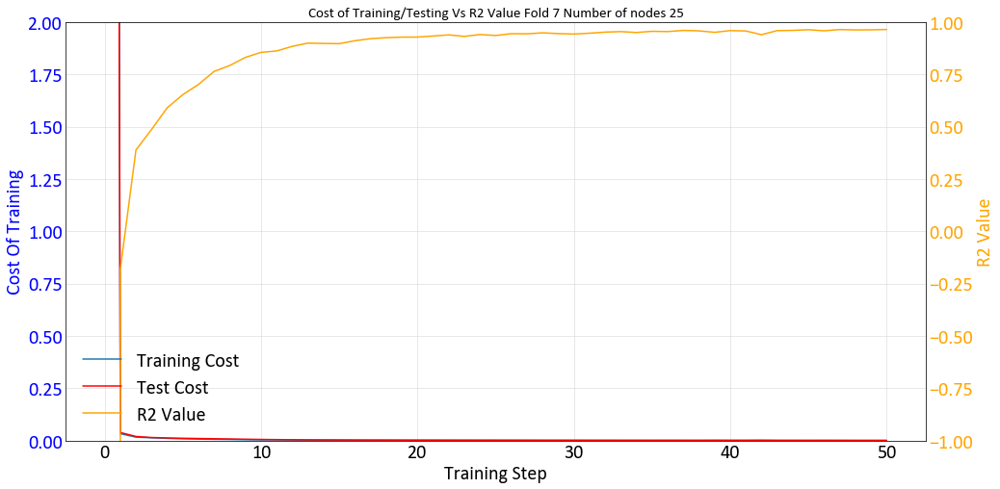

-1.7424
2.5579
8
Working on Node 10 fold 8 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp6mnbk2tu', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F129C7B70>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 37.34035873413086
Cost_test : 36.583958
R^2:-1242.5421142578125
Epoch: 100/5000 err = 0.05063656345009804
Cost_test : 0.05172267
R^2:-0.8074796199798584
Epoch: 200/5000 err = 0.02809301484376192
Cost_test : 0.02842087
R^2:-0.03726854920387268
Epoch: 300/5000 err = 0.019728814251720905
Cost_test : 0.022184344
R^2:0.30779969692230225
Epoch: 400/5000 err = 0.017109218053519726
Cost_test : 0.01800138
R^2:0.43791282176971436
Epoch: 500/5000 err = 0.013161212671548128
Cost_test : 0.014772272
R^2:0.4922284781932831
Epoch: 600/5000 err = 0.011614392511546612
Cost_test : 0.012995972
R^2:0.574383020401001
Epoch: 700/5000 err = 0.010692475363612175
Cost_test : 0.011498877
R^2:0.6172538101673126
Epoch: 800/5000 err = 0.009455515071749687
Cost_test : 0.010353853
R^2:0.657882809638977
Epoch: 900/5000 err = 0.008772703818976879
Cost_test : 0.009355764
R^2:0.6774332821369171
Epoch: 1000/5000 err = 0.007917564362287521
Cost_test : 0.008674724
R^2:0.7201443016529083
Epoch: 1100/5000 

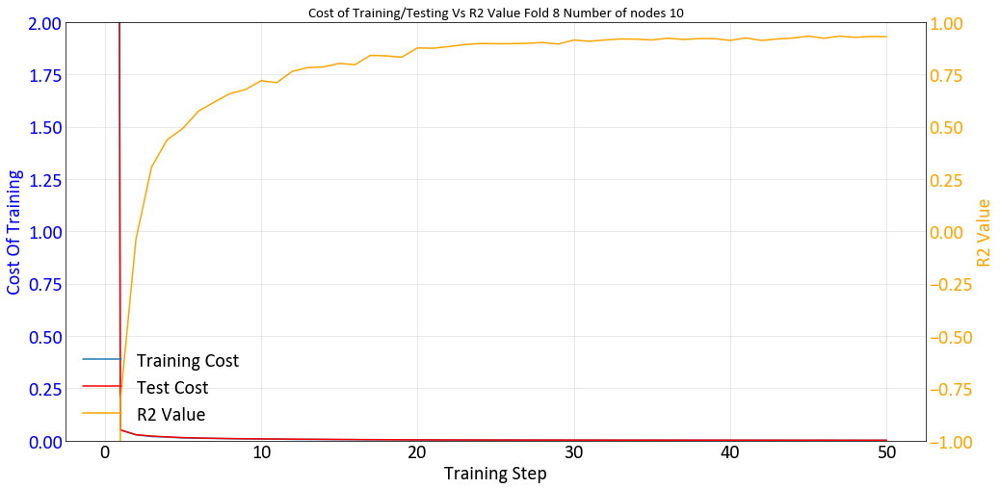

Working on Node 15 fold 8 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp03fasj6a', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022ED96A0F28>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 47.03371047973633
Cost_test : 44.971794
R^2:-1742.3157958984375
Epoch: 100/5000 err = 0.04423387907445431
Cost_test : 0.049599905
R^2:-0.6475739479064941
Epoch: 200/5000 err = 0.021511927247047424
Cost_test : 0.026512066
R^2:0.23382291197776794
Epoch: 300/5000 err = 0.01565410615876317
Cost_test : 0.019761592
R^2:0.43363019824028015
Epoch: 400/5000 err = 0.014627949800342321
Cost_test : 0.015035875
R^2:0.4941970407962799
Epoch: 500/5000 err = 0.010435393545776606
Cost_test : 0.011877258
R^2:0.6407871544361115
Epoch: 600/5000 err = 0.00906490022316575
Cost_test : 0.009956665
R^2:0.6806076765060425
Epoch: 700/5000 err = 0.008400424383580685
Cost_test : 0.008746586
R^2:0.699212908744812
Epoch: 800/5000 err = 0.007781927241012454
Cost_test : 0.007827862
R^2:0.7246092855930328
Epoch: 900/5000 err = 0.006519546499475837
Cost_test : 0.007135774
R^2:0.7639738619327545
Epoch: 1000/5000 err = 0.005972030106931925
Cost_test : 0.006449039
R^2:0.7733862996101379
Epoch: 1100/5000

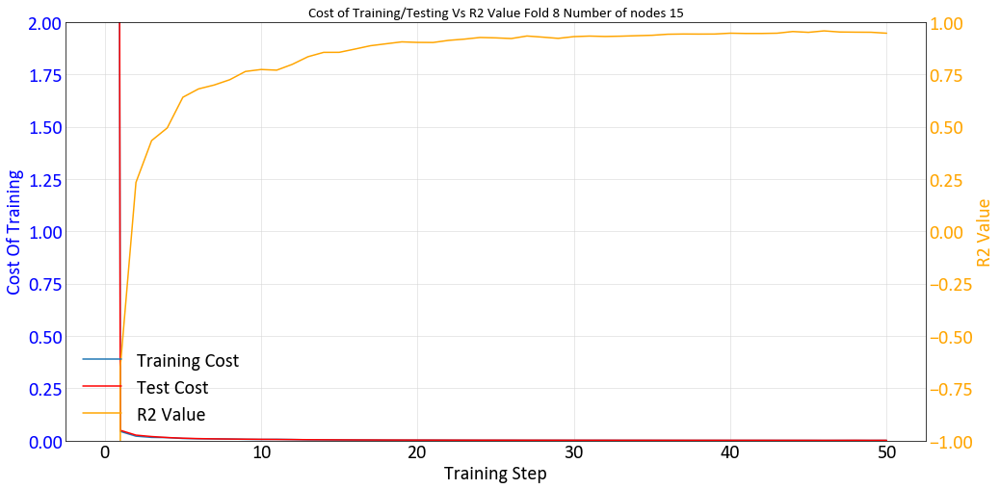

Working on Node 20 fold 8 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpl4ho_7ll', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F9B1160>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 78.45190811157227
Cost_test : 74.46003
R^2:-2878.827392578125
Epoch: 100/5000 err = 0.06456176936626434
Cost_test : 0.0604012
R^2:-1.3093949556350708
Epoch: 200/5000 err = 0.02257305383682251
Cost_test : 0.022272224
R^2:0.15061110258102417
Epoch: 300/5000 err = 0.01640231814235449
Cost_test : 0.017266551
R^2:0.401754230260849
Epoch: 400/5000 err = 0.013105497695505619
Cost_test : 0.014122671
R^2:0.5343816578388214
Epoch: 500/5000 err = 0.010473065078258514
Cost_test : 0.011713777
R^2:0.620095282793045
Epoch: 600/5000 err = 0.008658973965793848
Cost_test : 0.009903017
R^2:0.6718162596225739
Epoch: 700/5000 err = 0.00735331722535193
Cost_test : 0.008608787
R^2:0.7476152181625366
Epoch: 800/5000 err = 0.006733430549502373
Cost_test : 0.0076443064
R^2:0.7550257444381714
Epoch: 900/5000 err = 0.005845342064276338
Cost_test : 0.006899149
R^2:0.7891370058059692
Epoch: 1000/5000 err = 0.005232425639405847
Cost_test : 0.006141752
R^2:0.8111961483955383
Epoch: 1100/5000 err =

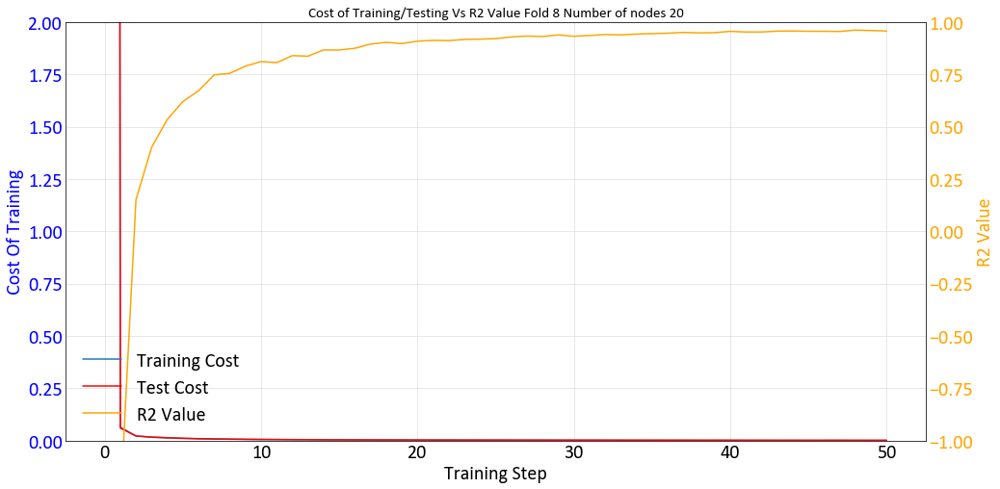

Working on Node 25 fold 8 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpp6bd9bla', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F15BAC278>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 75.56969451904297
Cost_test : 69.90906
R^2:-2807.0653076171875
Epoch: 100/5000 err = 0.07225936278700829
Cost_test : 0.073400624
R^2:-1.717910885810852
Epoch: 200/5000 err = 0.022842944599688053
Cost_test : 0.023779774
R^2:0.13492462038993835
Epoch: 300/5000 err = 0.016553650610148907
Cost_test : 0.016591
R^2:0.4140242636203766
Epoch: 400/5000 err = 0.011707996483892202
Cost_test : 0.013012119
R^2:0.5679703950881958
Epoch: 500/5000 err = 0.009748007170855999
Cost_test : 0.010198991
R^2:0.6751432418823242
Epoch: 600/5000 err = 0.007195658050477505
Cost_test : 0.00798424
R^2:0.7441540360450745
Epoch: 700/5000 err = 0.005426390562206507
Cost_test : 0.00634649
R^2:0.7834584414958954
Epoch: 800/5000 err = 0.004840008681640029
Cost_test : 0.005134217
R^2:0.8306112885475159
Epoch: 900/5000 err = 0.003992725512944162
Cost_test : 0.0044450783
R^2:0.8614575862884521
Epoch: 1000/5000 err = 0.0037790362257510424
Cost_test : 0.0038276957
R^2:0.8675131797790527
Epoch: 1100/5000 e

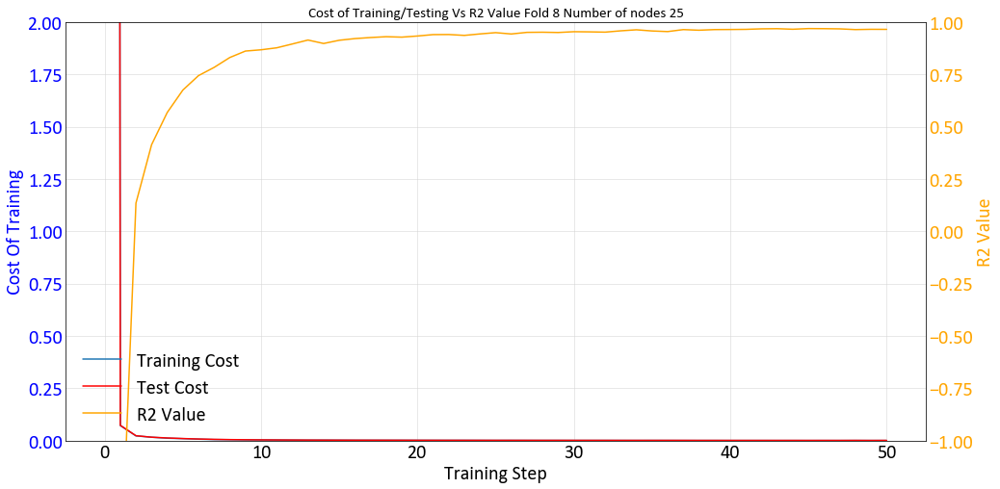

-1.7424
2.5579
9
Working on Node 10 fold 9 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpxp57f41_', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F9EE320>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done call

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 48.21504020690918
Cost_test : 45.85331
R^2:-1912.1741943359375
Epoch: 100/5000 err = 0.05390557833015919
Cost_test : 0.052312523
R^2:-1.0333155989646912
Epoch: 200/5000 err = 0.023083371110260487
Cost_test : 0.023678785
R^2:0.10846564173698425
Epoch: 300/5000 err = 0.01789200399070978
Cost_test : 0.018978884
R^2:0.31462106108665466
Epoch: 400/5000 err = 0.015058465301990509
Cost_test : 0.016424207
R^2:0.42895713448524475
Epoch: 500/5000 err = 0.012481876648962498
Cost_test : 0.014459323
R^2:0.506584882736206
Epoch: 600/5000 err = 0.010776440612971783
Cost_test : 0.012710753
R^2:0.6345934867858887
Epoch: 700/5000 err = 0.009421026799827814
Cost_test : 0.011537387
R^2:0.6654797196388245
Epoch: 800/5000 err = 0.00835536327213049
Cost_test : 0.010507596
R^2:0.6858946979045868
Epoch: 900/5000 err = 0.007743521593511105
Cost_test : 0.009537499
R^2:0.7030914425849915
Epoch: 1000/5000 err = 0.006937983212992549
Cost_test : 0.008732945
R^2:0.7504526078701019
Epoch: 1100/5000

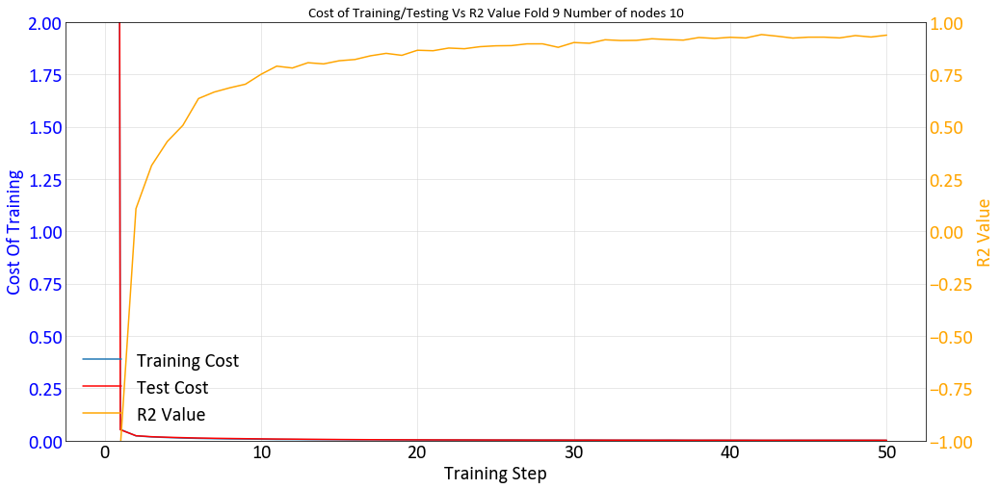

Working on Node 15 fold 9 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmphg54f9ns', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F12D25F28>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 95.34512710571289
Cost_test : 91.49283
R^2:-3573.1478271484375
Epoch: 100/5000 err = 0.11022313311696053
Cost_test : 0.10811101
R^2:-3.314204216003418
Epoch: 200/5000 err = 0.028266909532248974
Cost_test : 0.026924588
R^2:0.02025371789932251
Epoch: 300/5000 err = 0.017773215658962727
Cost_test : 0.019473214
R^2:0.33612680435180664
Epoch: 400/5000 err = 0.014035965781658888
Cost_test : 0.016215496
R^2:0.46383005380630493
Epoch: 500/5000 err = 0.012841974850744009
Cost_test : 0.014142626
R^2:0.5611853003501892
Epoch: 600/5000 err = 0.011020374950021505
Cost_test : 0.0125536965
R^2:0.5925948321819305
Epoch: 700/5000 err = 0.00945363100618124
Cost_test : 0.011157034
R^2:0.6149142980575562
Epoch: 800/5000 err = 0.008531125262379646
Cost_test : 0.009857891
R^2:0.6839895248413086
Epoch: 900/5000 err = 0.007562546292319894
Cost_test : 0.0087268315
R^2:0.6856802105903625
Epoch: 1000/5000 err = 0.006735592149198055
Cost_test : 0.007793185
R^2:0.7355660498142242
Epoch: 1100/50

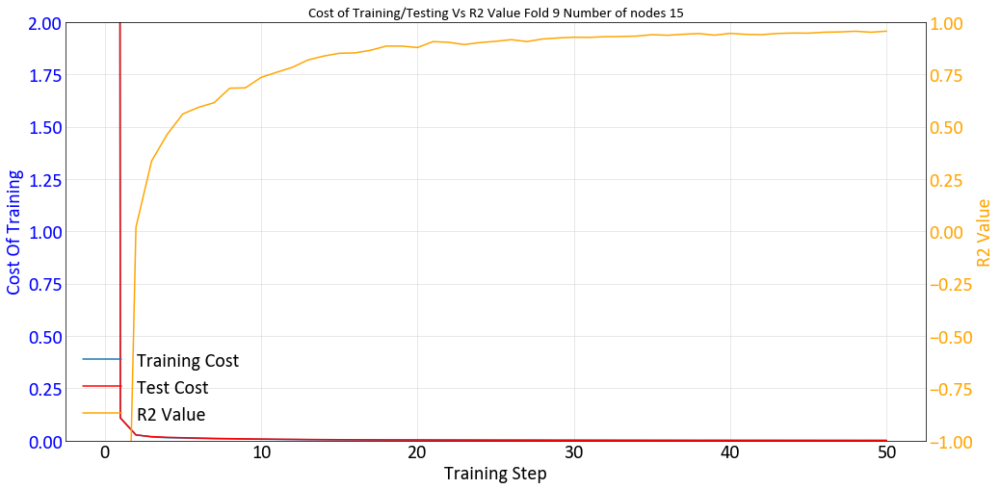

Working on Node 20 fold 9 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpdwv33lyf', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F12BDF2E8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 55.58251190185547
Cost_test : 50.383873
R^2:-2103.2599487304688
Epoch: 100/5000 err = 0.04885868728160858
Cost_test : 0.050784685
R^2:-0.8642098903656006
Epoch: 200/5000 err = 0.024387951008975506
Cost_test : 0.026339274
R^2:0.06692308187484741
Epoch: 300/5000 err = 0.017516429536044598
Cost_test : 0.020863423
R^2:0.325923889875412
Epoch: 400/5000 err = 0.01498102629557252
Cost_test : 0.017420044
R^2:0.4049344062805176
Epoch: 500/5000 err = 0.011709317099303007
Cost_test : 0.015136702
R^2:0.5656760931015015
Epoch: 600/5000 err = 0.010813468601554632
Cost_test : 0.013378781
R^2:0.5639640986919403
Epoch: 700/5000 err = 0.00973957497626543
Cost_test : 0.011985247
R^2:0.6409030258655548
Epoch: 800/5000 err = 0.008405701722949743
Cost_test : 0.010790748
R^2:0.6938928365707397
Epoch: 900/5000 err = 0.007363136159256101
Cost_test : 0.009539235
R^2:0.7043081223964691
Epoch: 1000/5000 err = 0.006266002310439944
Cost_test : 0.008434474
R^2:0.7661807239055634
Epoch: 1100/5000 

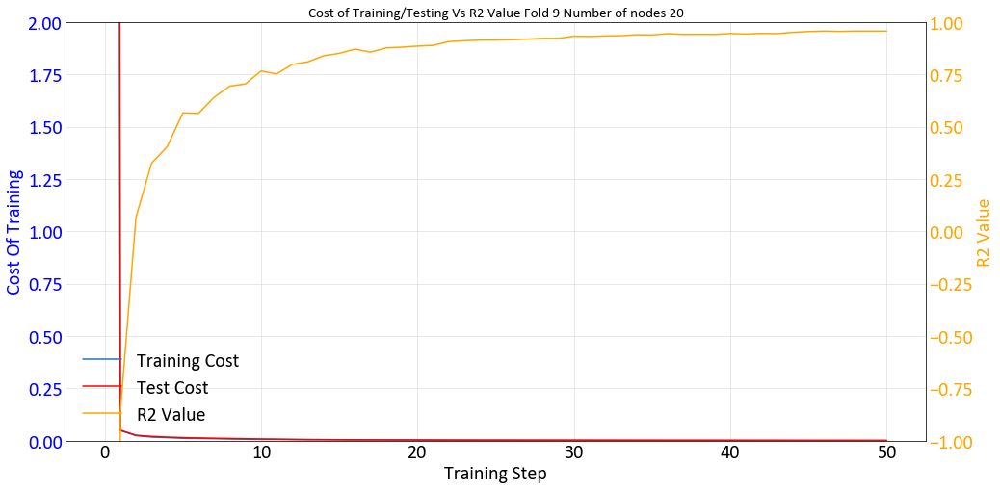

Working on Node 25 fold 9 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpzgi536mz', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0AC394A8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INF

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 23.440595626831055
Cost_test : 20.607327
R^2:-866.1914978027344
Epoch: 100/5000 err = 0.03745691850781441
Cost_test : 0.038556933
R^2:-0.4540083408355713
Epoch: 200/5000 err = 0.021198932081460953
Cost_test : 0.023320572
R^2:0.2126249074935913
Epoch: 300/5000 err = 0.015633427072316408
Cost_test : 0.015567879
R^2:0.4230045676231384
Epoch: 400/5000 err = 0.010251042433083057
Cost_test : 0.010298185
R^2:0.6164224743843079
Epoch: 500/5000 err = 0.007024995982646942
Cost_test : 0.008399584
R^2:0.7340323030948639
Epoch: 600/5000 err = 0.005657931789755821
Cost_test : 0.0067527993
R^2:0.779784619808197
Epoch: 700/5000 err = 0.004613972036167979
Cost_test : 0.0060437657
R^2:0.8247425556182861
Epoch: 800/5000 err = 0.003943849820643663
Cost_test : 0.0054117683
R^2:0.856579065322876
Epoch: 900/5000 err = 0.003711234894581139
Cost_test : 0.0046539763
R^2:0.8426531255245209
Epoch: 1000/5000 err = 0.0034272995544597507
Cost_test : 0.004523311
R^2:0.8742054998874664
Epoch: 1100/

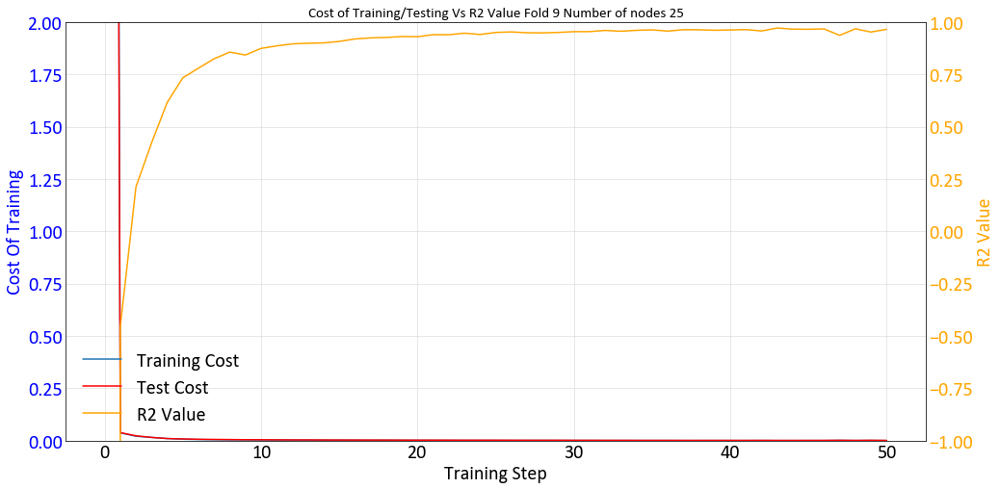

-1.7424
2.5579
10
Working on Node 10 fold 10 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp8f287r37', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0EE0F4E0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 33.460206031799316
Cost_test : 31.14051
R^2:-1186.12890625
Epoch: 100/5000 err = 0.07956667616963387
Cost_test : 0.0691085
R^2:-1.8467631340026855
Epoch: 200/5000 err = 0.03229944407939911
Cost_test : 0.034750044
R^2:-0.23886269330978394
Epoch: 300/5000 err = 0.02426664624363184
Cost_test : 0.02292223
R^2:0.04778629541397095
Epoch: 400/5000 err = 0.019599572755396366
Cost_test : 0.017775962
R^2:0.3241426348686218
Epoch: 500/5000 err = 0.014545031357556581
Cost_test : 0.014637564
R^2:0.4876854419708252
Epoch: 600/5000 err = 0.015616901218891144
Cost_test : 0.012459807
R^2:0.43172359466552734
Epoch: 700/5000 err = 0.012077693361788988
Cost_test : 0.010959751
R^2:0.5549579560756683
Epoch: 800/5000 err = 0.009612653870135546
Cost_test : 0.009791079
R^2:0.6617119312286377
Epoch: 900/5000 err = 0.010107696522027254
Cost_test : 0.008876978
R^2:0.6306345462799072
Epoch: 1000/5000 err = 0.00836875569075346
Cost_test : 0.008108746
R^2:0.6713652908802032
Epoch: 1100/5000 err =

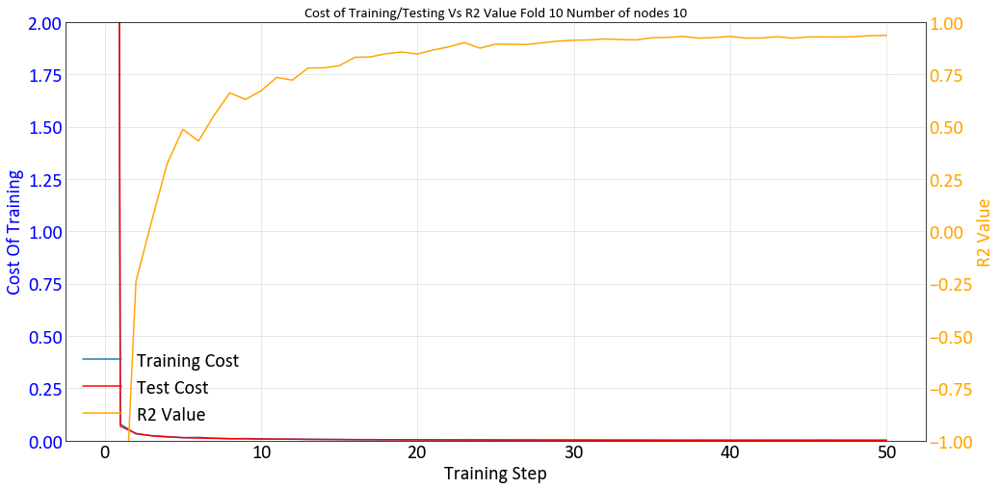

Working on Node 15 fold 10 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpnn953cvj', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F12948A20>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 45.562557220458984
Cost_test : 42.01646
R^2:-1615.0924682617188
Epoch: 100/5000 err = 0.05204372853040695
Cost_test : 0.050238147
R^2:-0.9851846098899841
Epoch: 200/5000 err = 0.026470286771655083
Cost_test : 0.024868494
R^2:0.010806888341903687
Epoch: 300/5000 err = 0.017527219839394093
Cost_test : 0.016638797
R^2:0.32060155272483826
Epoch: 400/5000 err = 0.013097443152219057
Cost_test : 0.012754073
R^2:0.5146066248416901
Epoch: 500/5000 err = 0.012619198765605688
Cost_test : 0.010775684
R^2:0.56841641664505
Epoch: 600/5000 err = 0.010500351432710886
Cost_test : 0.0096196085
R^2:0.5843901038169861
Epoch: 700/5000 err = 0.009310079272836447
Cost_test : 0.008796082
R^2:0.6363824307918549
Epoch: 800/5000 err = 0.008547201287001371
Cost_test : 0.008174527
R^2:0.6877412497997284
Epoch: 900/5000 err = 0.0066923233680427074
Cost_test : 0.0075738127
R^2:0.7651064395904541
Epoch: 1000/5000 err = 0.006125064333900809
Cost_test : 0.0071130376
R^2:0.7651992738246918
Epoch: 110

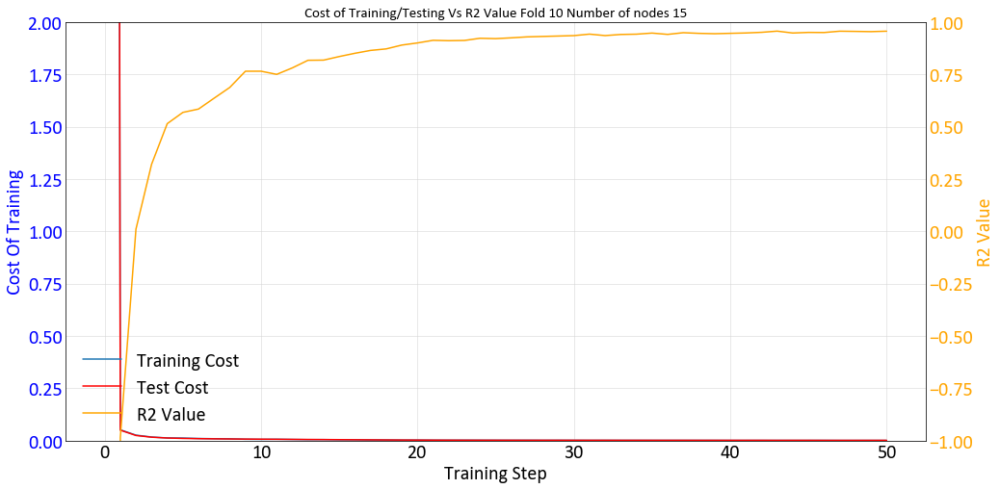

Working on Node 20 fold 10 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpy7ji2ejs', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E886864E0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 169.5643081665039
Cost_test : 159.52507
R^2:-6422.42138671875
Epoch: 100/5000 err = 0.17396357655525208
Cost_test : 0.17201044
R^2:-5.542668342590332
Epoch: 200/5000 err = 0.03845158405601978
Cost_test : 0.0358295
R^2:-0.46911394596099854
Epoch: 300/5000 err = 0.02051327470690012
Cost_test : 0.020017548
R^2:0.17552122473716736
Epoch: 400/5000 err = 0.013905571307986975
Cost_test : 0.014807124
R^2:0.49807628989219666
Epoch: 500/5000 err = 0.011995363514870405
Cost_test : 0.0124725355
R^2:0.5210994184017181
Epoch: 600/5000 err = 0.011099628172814846
Cost_test : 0.01092174
R^2:0.5747900605201721
Epoch: 700/5000 err = 0.009123059920966625
Cost_test : 0.009769275
R^2:0.659747838973999
Epoch: 800/5000 err = 0.008674765937030315
Cost_test : 0.008728839
R^2:0.6792344748973846
Epoch: 900/5000 err = 0.007755888858810067
Cost_test : 0.007939801
R^2:0.7013311386108398
Epoch: 1000/5000 err = 0.0068291896022856236
Cost_test : 0.007262302
R^2:0.736539751291275
Epoch: 1100/5000 err

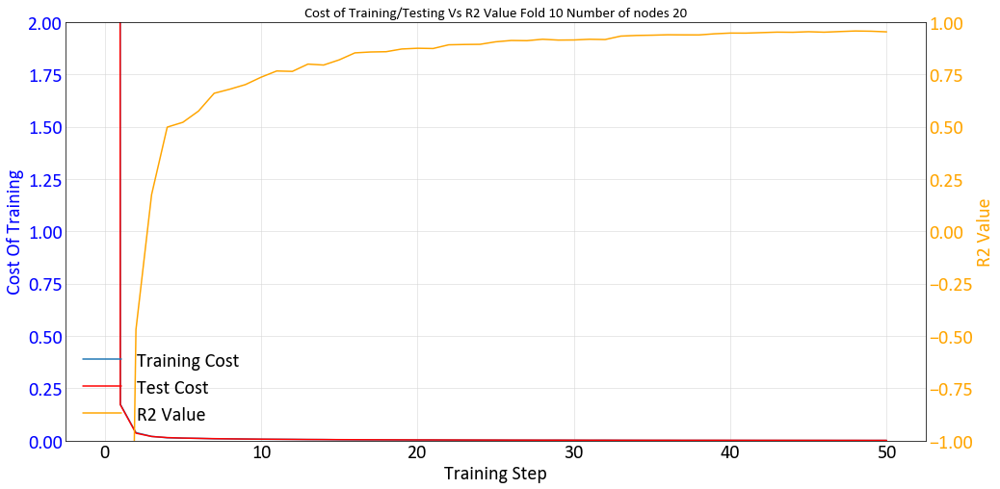

Working on Node 25 fold 10 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp9w1xhblt', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0D883048>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 47.64333534240723
Cost_test : 41.46741
R^2:-1753.88427734375
Epoch: 100/5000 err = 0.04529903270304203
Cost_test : 0.047929794
R^2:-0.6492752432823181
Epoch: 200/5000 err = 0.018088597804307938
Cost_test : 0.020958586
R^2:0.288015753030777
Epoch: 300/5000 err = 0.01224196283146739
Cost_test : 0.013532226
R^2:0.551443487405777
Epoch: 400/5000 err = 0.01026148023083806
Cost_test : 0.011256502
R^2:0.6332740783691406
Epoch: 500/5000 err = 0.0076694844756275415
Cost_test : 0.0096501475
R^2:0.7104521989822388
Epoch: 600/5000 err = 0.007318002404645085
Cost_test : 0.008320397
R^2:0.7290001809597015
Epoch: 700/5000 err = 0.005679472116753459
Cost_test : 0.0071881185
R^2:0.794743001461029
Epoch: 800/5000 err = 0.005247098859399557
Cost_test : 0.006175824
R^2:0.8014309108257294
Epoch: 900/5000 err = 0.004557635867968202
Cost_test : 0.00540811
R^2:0.8243515193462372
Epoch: 1000/5000 err = 0.004124890547245741
Cost_test : 0.0047854297
R^2:0.8399702310562134
Epoch: 1100/5000 err

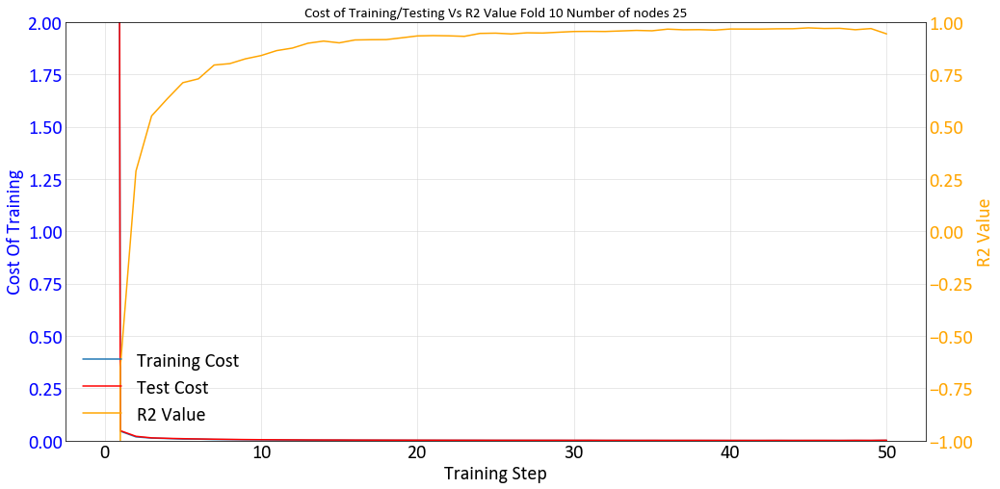

-1.7424
2.5579
11
Working on Node 10 fold 11 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpucc4l7d5', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E8917E860>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 52.74364471435547
Cost_test : 48.198547
R^2:-1995.0828247070312
Epoch: 100/5000 err = 0.06757262349128723
Cost_test : 0.073953964
R^2:-1.490771770477295
Epoch: 200/5000 err = 0.023977356031537056
Cost_test : 0.024795555
R^2:0.08888661861419678
Epoch: 300/5000 err = 0.01497833151370287
Cost_test : 0.015727662
R^2:0.4266551434993744
Epoch: 400/5000 err = 0.011529474053531885
Cost_test : 0.012782042
R^2:0.5775674283504486
Epoch: 500/5000 err = 0.01025989931076765
Cost_test : 0.010929054
R^2:0.6192283928394318
Epoch: 600/5000 err = 0.008094940334558487
Cost_test : 0.009494184
R^2:0.6913749873638153
Epoch: 700/5000 err = 0.007975545944646
Cost_test : 0.008434962
R^2:0.6643922030925751
Epoch: 800/5000 err = 0.006746154278516769
Cost_test : 0.0077498257
R^2:0.7415105104446411
Epoch: 900/5000 err = 0.006117931799963117
Cost_test : 0.0071697184
R^2:0.7789989709854126
Epoch: 1000/5000 err = 0.006350257666781545
Cost_test : 0.0068759355
R^2:0.7571223378181458
Epoch: 1100/5000 

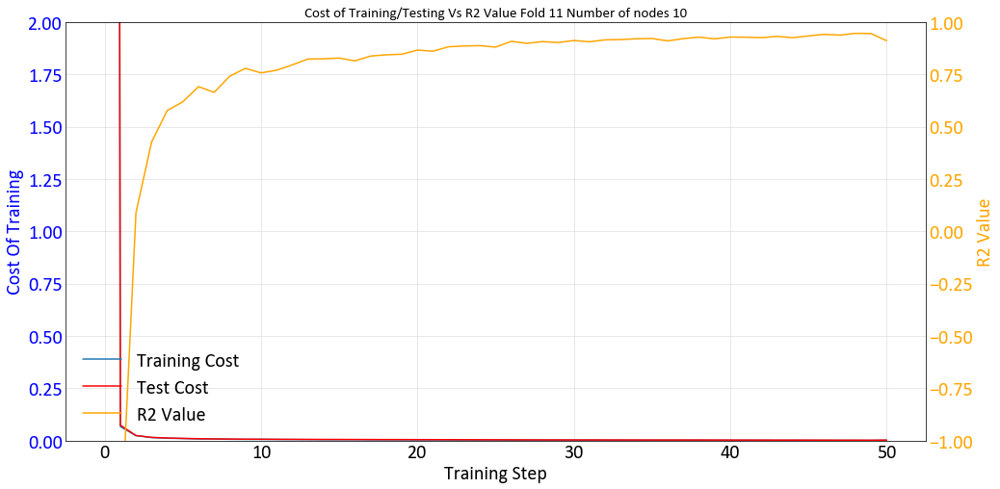

Working on Node 15 fold 11 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpili4keqy', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022ED9592160>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 79.35209274291992
Cost_test : 70.45674
R^2:-2928.2420654296875
Epoch: 100/5000 err = 0.09999575838446617
Cost_test : 0.09847403
R^2:-2.8967196941375732
Epoch: 200/5000 err = 0.0263986699283123
Cost_test : 0.025238076
R^2:-0.0163935124874115
Epoch: 300/5000 err = 0.016309207770973444
Cost_test : 0.016176017
R^2:0.3905198276042938
Epoch: 400/5000 err = 0.012450313661247492
Cost_test : 0.013574976
R^2:0.5586570799350739
Epoch: 500/5000 err = 0.010865294840186834
Cost_test : 0.011755912
R^2:0.5950039327144623
Epoch: 600/5000 err = 0.008921780623495579
Cost_test : 0.010388106
R^2:0.6176513731479645
Epoch: 700/5000 err = 0.00829700194299221
Cost_test : 0.009401777
R^2:0.6866000890731812
Epoch: 800/5000 err = 0.0077484173234552145
Cost_test : 0.00857698
R^2:0.7122541666030884
Epoch: 900/5000 err = 0.007049528649076819
Cost_test : 0.007897433
R^2:0.7373868823051453
Epoch: 1000/5000 err = 0.005727700423449278
Cost_test : 0.0073464643
R^2:0.791887104511261
Epoch: 1100/5000 er

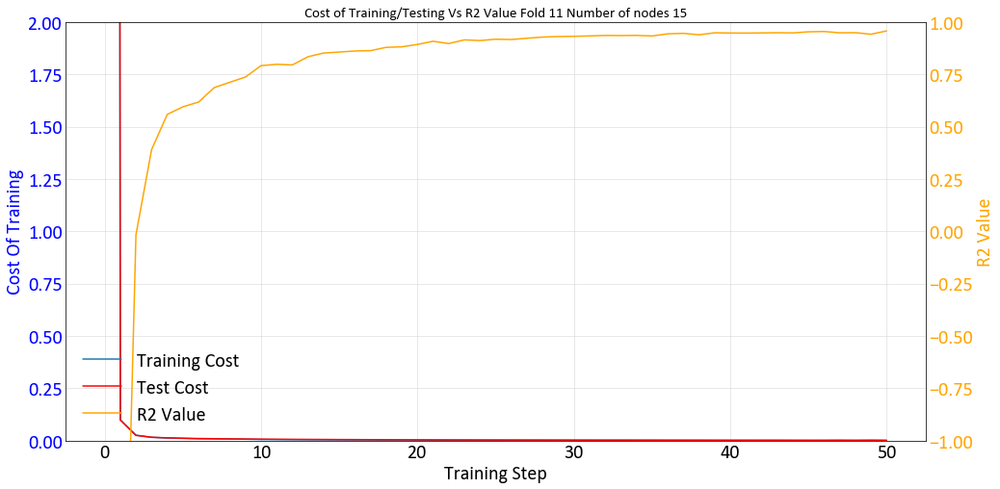

Working on Node 20 fold 11 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp3kxvdej7', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F122D09E8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 52.8546028137207
Cost_test : 46.444923
R^2:-2051.5822143554688
Epoch: 100/5000 err = 0.06050797179341316
Cost_test : 0.058673702
R^2:-1.491666316986084
Epoch: 200/5000 err = 0.021844548173248768
Cost_test : 0.019345565
R^2:0.19001168012619019
Epoch: 300/5000 err = 0.016366510652005672
Cost_test : 0.014413266
R^2:0.3705092966556549
Epoch: 400/5000 err = 0.012711960356682539
Cost_test : 0.01186047
R^2:0.5270299911499023
Epoch: 500/5000 err = 0.010899319313466549
Cost_test : 0.01015402
R^2:0.6144310235977173
Epoch: 600/5000 err = 0.008875628467649221
Cost_test : 0.008919686
R^2:0.6528272330760956
Epoch: 700/5000 err = 0.007669879822060466
Cost_test : 0.007961812
R^2:0.7174919247627258
Epoch: 800/5000 err = 0.006806835997849703
Cost_test : 0.0071179112
R^2:0.7341896891593933
Epoch: 900/5000 err = 0.005400422960519791
Cost_test : 0.006430417
R^2:0.8061298727989197
Epoch: 1000/5000 err = 0.004554505692794919
Cost_test : 0.00578125
R^2:0.8302585780620575
Epoch: 1100/5000 e

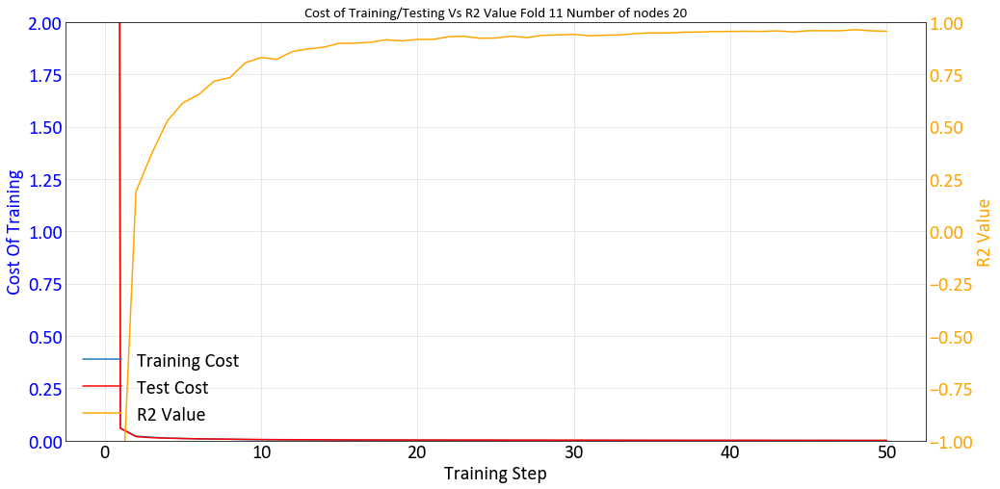

Working on Node 25 fold 11 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpkjtaz7r0', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F127D8710>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 37.93876266479492
Cost_test : 31.737247
R^2:-1517.7861328125
Epoch: 100/5000 err = 0.03973012790083885
Cost_test : 0.038135465
R^2:-0.5903385877609253
Epoch: 200/5000 err = 0.018116523511707783
Cost_test : 0.01675644
R^2:0.32694223523139954
Epoch: 300/5000 err = 0.012046611402183771
Cost_test : 0.012542536
R^2:0.5430970191955566
Epoch: 400/5000 err = 0.010007990058511496
Cost_test : 0.0103034265
R^2:0.62418994307518
Epoch: 500/5000 err = 0.008385047316551208
Cost_test : 0.0090197865
R^2:0.6824244856834412
Epoch: 600/5000 err = 0.006590401055291295
Cost_test : 0.007961837
R^2:0.7354950308799744
Epoch: 700/5000 err = 0.00569913350045681
Cost_test : 0.00725347
R^2:0.7810034155845642
Epoch: 800/5000 err = 0.00530908303335309
Cost_test : 0.0066758585
R^2:0.7872644364833832
Epoch: 900/5000 err = 0.004563344409689307
Cost_test : 0.0062987152
R^2:0.8334679901599884
Epoch: 1000/5000 err = 0.003958980785682797
Cost_test : 0.005629206
R^2:0.8472495675086975
Epoch: 1100/5000 er

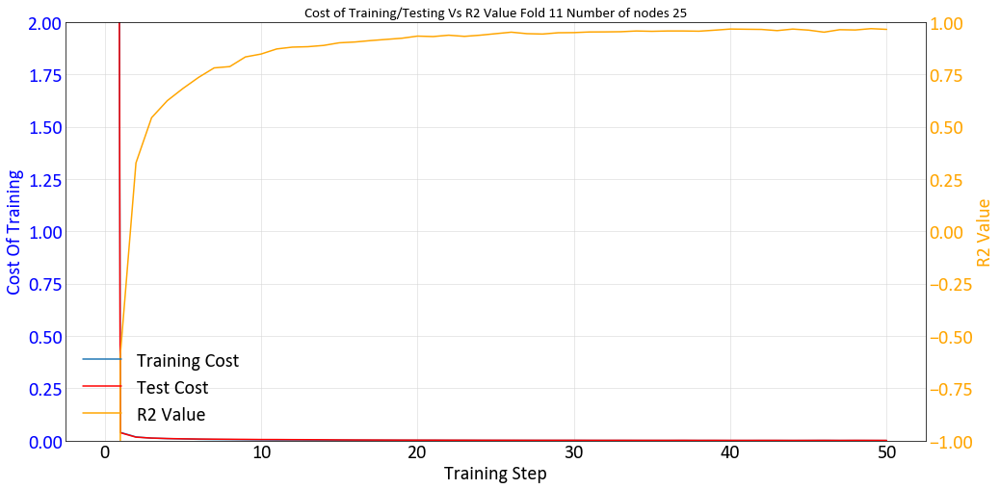

-1.7424
2.4504
12
Working on Node 10 fold 12 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp3q2fpk9n', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0FF7D6A0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 37.25952911376953
Cost_test : 36.17125
R^2:-1374.0111694335938
Epoch: 100/5000 err = 0.049208683893084526
Cost_test : 0.05382763
R^2:-0.9876713752746582
Epoch: 200/5000 err = 0.0285333264619112
Cost_test : 0.03350607
R^2:-0.11845993995666504
Epoch: 300/5000 err = 0.020128789357841015
Cost_test : 0.025307937
R^2:0.24544116854667664
Epoch: 400/5000 err = 0.01599135436117649
Cost_test : 0.020409632
R^2:0.3986177444458008
Epoch: 500/5000 err = 0.013725279830396175
Cost_test : 0.017333645
R^2:0.5240457355976105
Epoch: 600/5000 err = 0.009896641597151756
Cost_test : 0.014795726
R^2:0.6294905841350555
Epoch: 700/5000 err = 0.008966336958110332
Cost_test : 0.012742802
R^2:0.6589640378952026
Epoch: 800/5000 err = 0.007903252961114049
Cost_test : 0.01106356
R^2:0.722129225730896
Epoch: 900/5000 err = 0.006990008754655719
Cost_test : 0.009705589
R^2:0.7465710341930389
Epoch: 1000/5000 err = 0.0055329264141619205
Cost_test : 0.008555885
R^2:0.7831244468688965
Epoch: 1100/5000 e

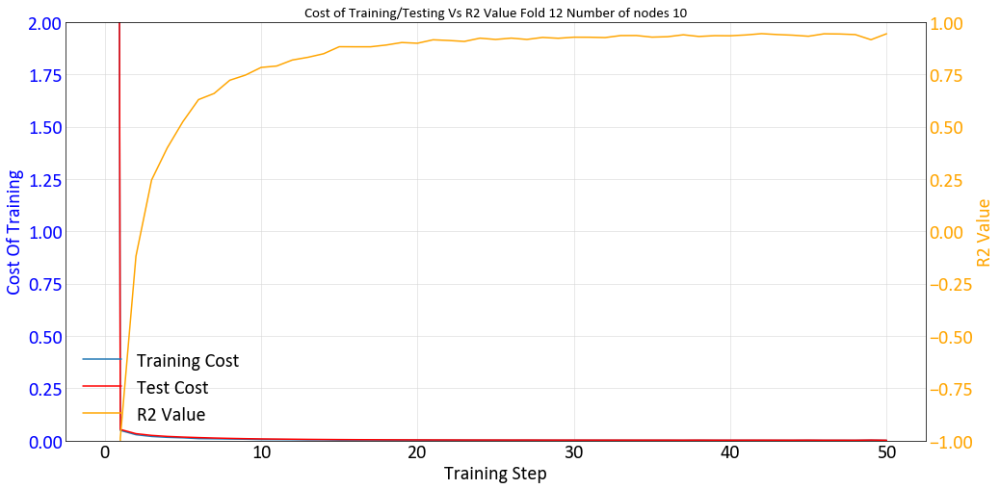

Working on Node 15 fold 12 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp1w54ebr3', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0FF7D390>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 45.82698631286621
Cost_test : 44.21616
R^2:-1781.8363647460938
Epoch: 100/5000 err = 0.06620066985487938
Cost_test : 0.06555504
R^2:-1.5354055166244507
Epoch: 200/5000 err = 0.02422099933028221
Cost_test : 0.02842501
R^2:0.03721362352371216
Epoch: 300/5000 err = 0.019437968730926514
Cost_test : 0.021761112
R^2:0.25351089239120483
Epoch: 400/5000 err = 0.014594341162592173
Cost_test : 0.017458376
R^2:0.4188404977321625
Epoch: 500/5000 err = 0.011889358516782522
Cost_test : 0.014258336
R^2:0.5671012699604034
Epoch: 600/5000 err = 0.010335068684071302
Cost_test : 0.012050463
R^2:0.5845238864421844
Epoch: 700/5000 err = 0.008847641292959452
Cost_test : 0.010569036
R^2:0.6707157790660858
Epoch: 800/5000 err = 0.008084945613518357
Cost_test : 0.009228093
R^2:0.683733344078064
Epoch: 900/5000 err = 0.007270003203302622
Cost_test : 0.008365733
R^2:0.7244364619255066
Epoch: 1000/5000 err = 0.005744456313550472
Cost_test : 0.0076961243
R^2:0.7811397314071655
Epoch: 1100/5000 

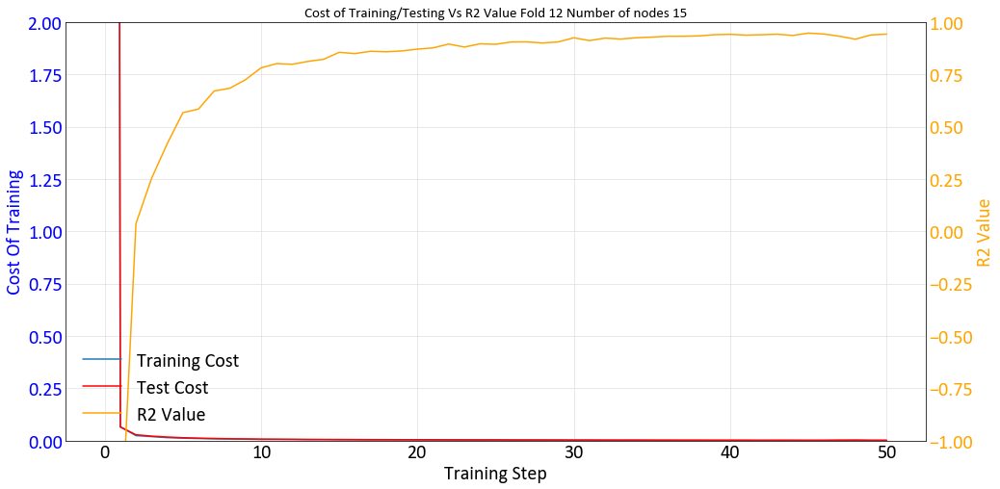

Working on Node 20 fold 12 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpl4pfepyi', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0A0B4F98>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 51.97979927062988
Cost_test : 49.276768
R^2:-1928.0305786132812
Epoch: 100/5000 err = 0.05000796541571617
Cost_test : 0.05655958
R^2:-0.8685656189918518
Epoch: 200/5000 err = 0.01855873316526413
Cost_test : 0.02747874
R^2:0.24480661749839783
Epoch: 300/5000 err = 0.014065501280128956
Cost_test : 0.020875009
R^2:0.44101640582084656
Epoch: 400/5000 err = 0.01206748140975833
Cost_test : 0.017524702
R^2:0.5652296543121338
Epoch: 500/5000 err = 0.010060266591608524
Cost_test : 0.015045027
R^2:0.6072934567928314
Epoch: 600/5000 err = 0.009326748084276915
Cost_test : 0.013168962
R^2:0.657507449388504
Epoch: 700/5000 err = 0.008181866258382797
Cost_test : 0.011621601
R^2:0.6999853849411011
Epoch: 800/5000 err = 0.006846379255875945
Cost_test : 0.010520207
R^2:0.7380414605140686
Epoch: 900/5000 err = 0.006047629518434405
Cost_test : 0.009411206
R^2:0.7818712890148163
Epoch: 1000/5000 err = 0.005703903269022703
Cost_test : 0.008523985
R^2:0.7809686064720154
Epoch: 1100/5000 e

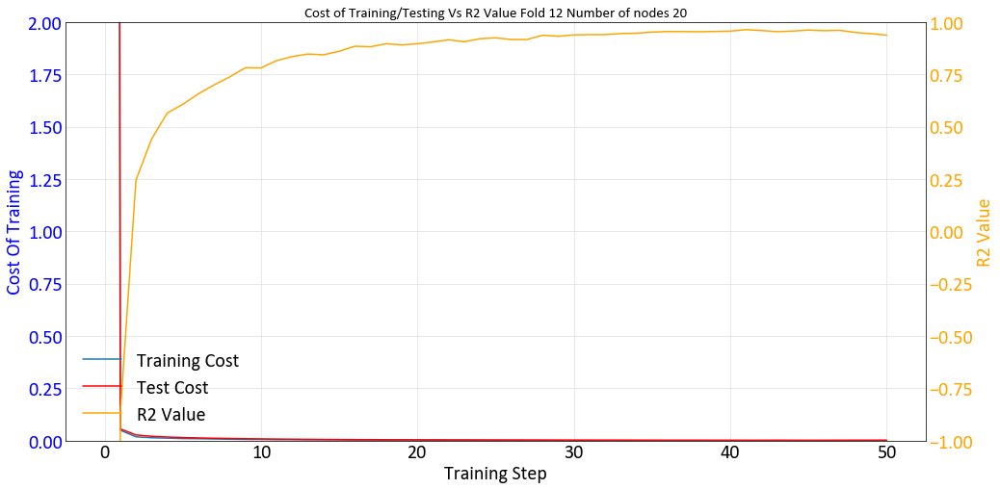

Working on Node 25 fold 12 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpl1veulhb', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0ABF9860>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 109.77928924560547
Cost_test : 109.302765
R^2:-4007.76513671875
Epoch: 100/5000 err = 0.1251329444348812
Cost_test : 0.11843656
R^2:-3.8939921855926514
Epoch: 200/5000 err = 0.032638778910040855
Cost_test : 0.042514373
R^2:-0.2784880995750427
Epoch: 300/5000 err = 0.021366437897086143
Cost_test : 0.028943464
R^2:0.17836135625839233
Epoch: 400/5000 err = 0.014855698216706514
Cost_test : 0.022817232
R^2:0.3927237093448639
Epoch: 500/5000 err = 0.01370500773191452
Cost_test : 0.019253867
R^2:0.48734790086746216
Epoch: 600/5000 err = 0.010863347444683313
Cost_test : 0.017163314
R^2:0.5963293313980103
Epoch: 700/5000 err = 0.010268361773341894
Cost_test : 0.015774563
R^2:0.603379637002945
Epoch: 800/5000 err = 0.009163225069642067
Cost_test : 0.014683602
R^2:0.6584374010562897
Epoch: 900/5000 err = 0.007916803937405348
Cost_test : 0.013692067
R^2:0.713807076215744
Epoch: 1000/5000 err = 0.0071139088831841946
Cost_test : 0.012629547
R^2:0.7221711277961731
Epoch: 1100/5000

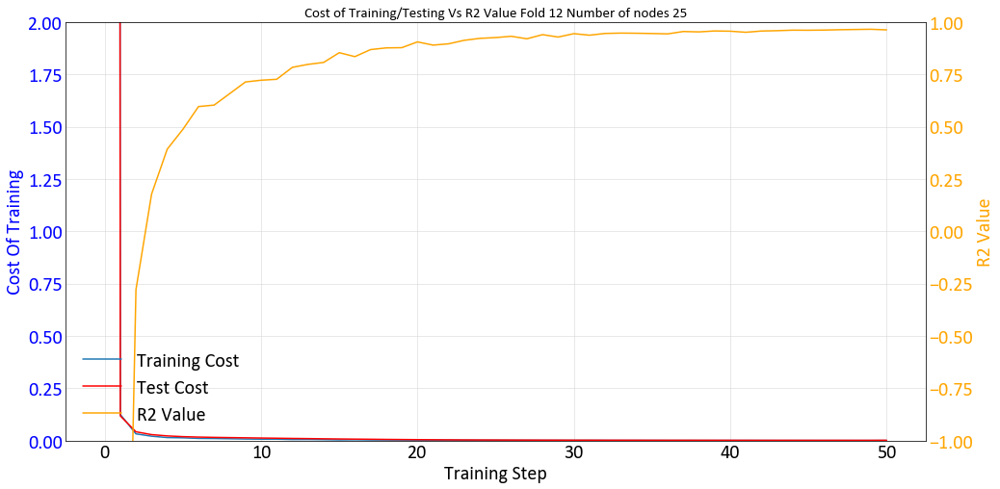

-1.7424
2.4504
13
Working on Node 10 fold 13 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpxrnvfmqp', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0FF5ED30>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 39.41973686218262
Cost_test : 37.97506
R^2:-1577.2080078125
Epoch: 100/5000 err = 0.04829680360853672
Cost_test : 0.039698113
R^2:-0.8916037082672119
Epoch: 200/5000 err = 0.025926919654011726
Cost_test : 0.024445951
R^2:-0.020836442708969116
Epoch: 300/5000 err = 0.021716684103012085
Cost_test : 0.019799912
R^2:0.18696662783622742
Epoch: 400/5000 err = 0.014676419086754322
Cost_test : 0.016409649
R^2:0.4343562424182892
Epoch: 500/5000 err = 0.012900078669190407
Cost_test : 0.013691735
R^2:0.5121120810508728
Epoch: 600/5000 err = 0.01011334452778101
Cost_test : 0.011275443
R^2:0.5840621292591095
Epoch: 700/5000 err = 0.009430129546672106
Cost_test : 0.009363292
R^2:0.646014392375946
Epoch: 800/5000 err = 0.00789573509246111
Cost_test : 0.0081866495
R^2:0.7113488614559174
Epoch: 900/5000 err = 0.0066572309006005526
Cost_test : 0.0073770913
R^2:0.7459103167057037
Epoch: 1000/5000 err = 0.006840843008831143
Cost_test : 0.006597776
R^2:0.7286403179168701
Epoch: 1100/500

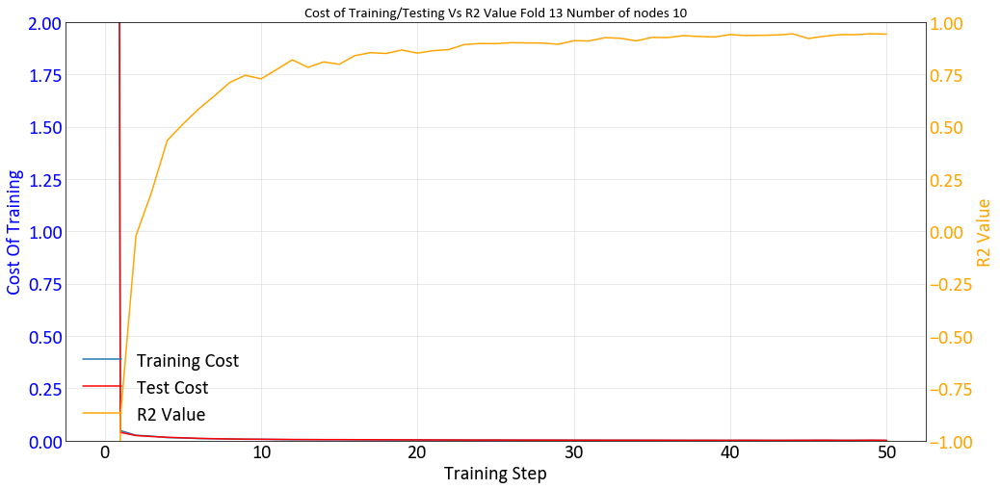

Working on Node 15 fold 13 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpes0bzv77', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E81ACB160>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 59.3784294128418
Cost_test : 59.398224
R^2:-2559.9610595703125
Epoch: 100/5000 err = 0.1019897535443306
Cost_test : 0.09270716
R^2:-2.685793399810791
Epoch: 200/5000 err = 0.0355945723131299
Cost_test : 0.04094087
R^2:-0.38839519023895264
Epoch: 300/5000 err = 0.02512181643396616
Cost_test : 0.024943292
R^2:0.0990644097328186
Epoch: 400/5000 err = 0.015122313518077135
Cost_test : 0.01678843
R^2:0.40002018213272095
Epoch: 500/5000 err = 0.011727418750524521
Cost_test : 0.012225293
R^2:0.5389910936355591
Epoch: 600/5000 err = 0.011324170976877213
Cost_test : 0.00961471
R^2:0.561040610074997
Epoch: 700/5000 err = 0.008504089433699846
Cost_test : 0.008116498
R^2:0.7005381882190704
Epoch: 800/5000 err = 0.007296120282262564
Cost_test : 0.0070295185
R^2:0.7313851714134216
Epoch: 900/5000 err = 0.00705428933724761
Cost_test : 0.006246614
R^2:0.7389951944351196
Epoch: 1000/5000 err = 0.004884751047939062
Cost_test : 0.0057146386
R^2:0.8213927447795868
Epoch: 1100/5000 err =

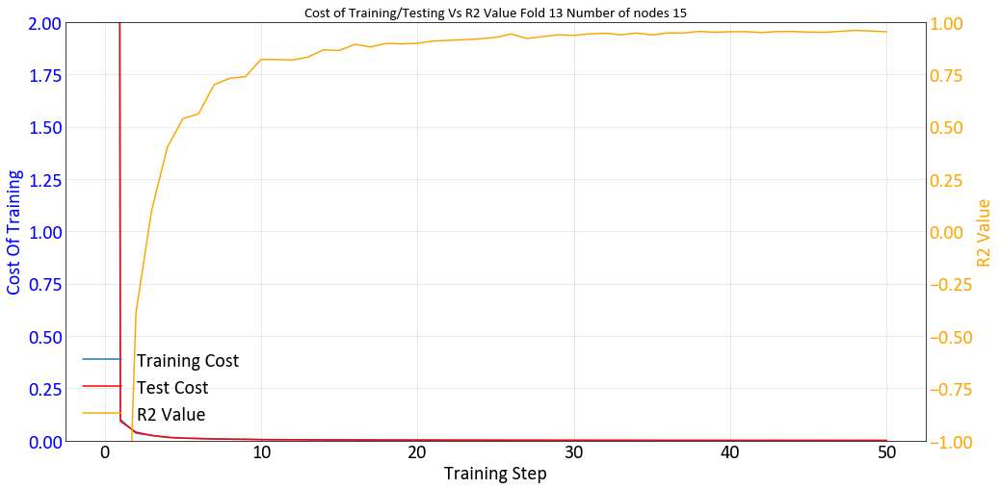

Working on Node 20 fold 13 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp3qp0ls8e', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F124FDDA0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 141.43595123291016
Cost_test : 137.14592
R^2:-5330.60009765625
Epoch: 100/5000 err = 0.2014910876750946
Cost_test : 0.1847138
R^2:-6.600224018096924
Epoch: 200/5000 err = 0.04431702196598053
Cost_test : 0.04095337
R^2:-0.7602688074111938
Epoch: 300/5000 err = 0.022764457389712334
Cost_test : 0.020989062
R^2:0.13622406125068665
Epoch: 400/5000 err = 0.017602612264454365
Cost_test : 0.015656415
R^2:0.33722564578056335
Epoch: 500/5000 err = 0.013685606885701418
Cost_test : 0.0130620925
R^2:0.4614853858947754
Epoch: 600/5000 err = 0.011701472103595734
Cost_test : 0.011255833
R^2:0.5289677679538727
Epoch: 700/5000 err = 0.01032991148531437
Cost_test : 0.009980177
R^2:0.5793838202953339
Epoch: 800/5000 err = 0.009306890424340963
Cost_test : 0.008908088
R^2:0.6405469179153442
Epoch: 900/5000 err = 0.008742665871977806
Cost_test : 0.007959968
R^2:0.6516503393650055
Epoch: 1000/5000 err = 0.008235725807026029
Cost_test : 0.0073045627
R^2:0.6838057041168213
Epoch: 1100/5000 e

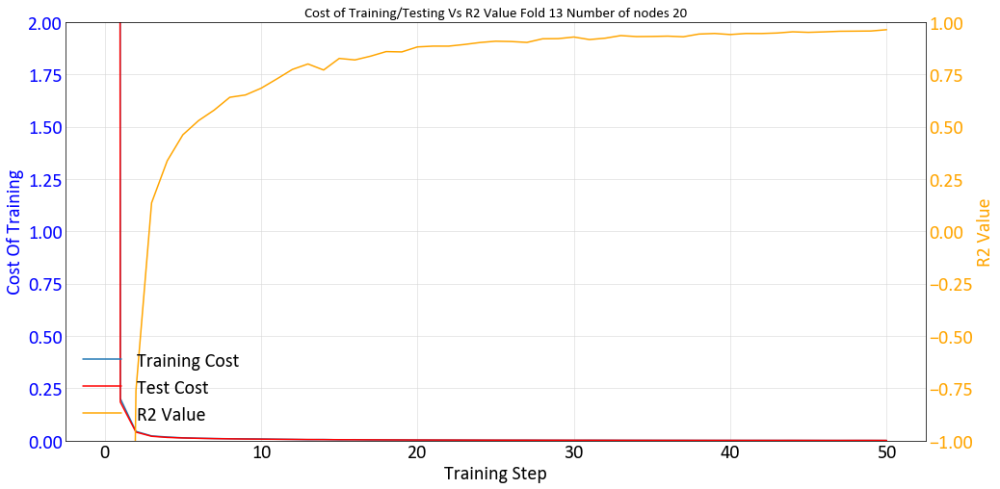

Working on Node 25 fold 13 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpp9slx4ll', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F8F2F98>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 96.65156173706055
Cost_test : 91.85886
R^2:-4270.4512939453125
Epoch: 100/5000 err = 0.09619193524122238
Cost_test : 0.08622887
R^2:-2.650235652923584
Epoch: 200/5000 err = 0.028512856923043728
Cost_test : 0.024917772
R^2:-0.02601754665374756
Epoch: 300/5000 err = 0.01504498952999711
Cost_test : 0.018070204
R^2:0.4441833198070526
Epoch: 400/5000 err = 0.013719580601900816
Cost_test : 0.014161736
R^2:0.48629623651504517
Epoch: 500/5000 err = 0.011790163815021515
Cost_test : 0.011582725
R^2:0.5163533985614777
Epoch: 600/5000 err = 0.00947492616251111
Cost_test : 0.0097495355
R^2:0.6289666295051575
Epoch: 700/5000 err = 0.00862930342555046
Cost_test : 0.008449026
R^2:0.6778759360313416
Epoch: 800/5000 err = 0.007431309437379241
Cost_test : 0.0074831396
R^2:0.7091218829154968
Epoch: 900/5000 err = 0.006076917750760913
Cost_test : 0.00672397
R^2:0.7629925906658173
Epoch: 1000/5000 err = 0.005532419309020042
Cost_test : 0.0061728437
R^2:0.7906128168106079
Epoch: 1100/5000

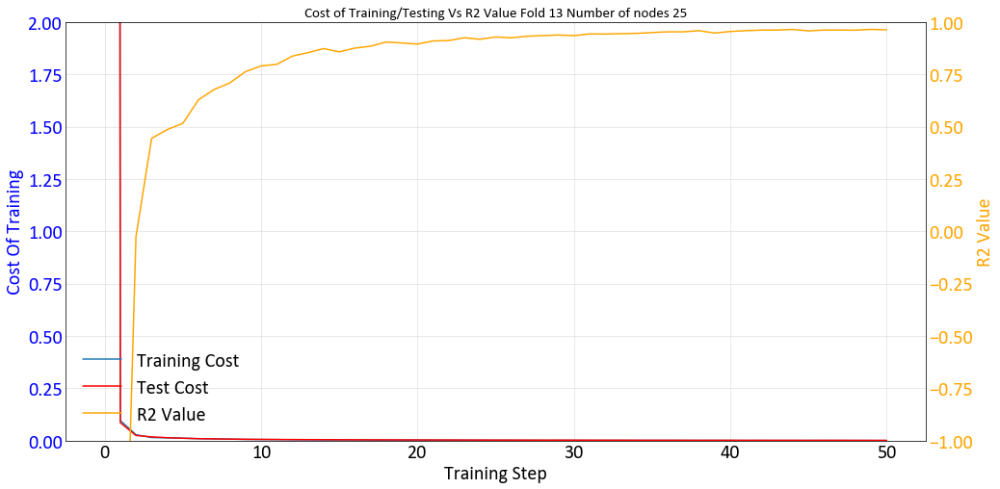

-1.7424
2.4504
14
Working on Node 10 fold 14 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpnh33f6bu', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F13A0FE80>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 44.51811408996582
Cost_test : 43.429085
R^2:-1807.1824340820312
Epoch: 100/5000 err = 0.07968657463788986
Cost_test : 0.08591978
R^2:-2.1698611974716187
Epoch: 200/5000 err = 0.04869476892054081
Cost_test : 0.04836152
R^2:-0.7691702842712402
Epoch: 300/5000 err = 0.030405834317207336
Cost_test : 0.03188984
R^2:-0.2384926676750183
Epoch: 400/5000 err = 0.022219096310436726
Cost_test : 0.02149584
R^2:0.13517212867736816
Epoch: 500/5000 err = 0.015038834419101477
Cost_test : 0.016100189
R^2:0.41624489426612854
Epoch: 600/5000 err = 0.012190123088657856
Cost_test : 0.013564618
R^2:0.5276766419410706
Epoch: 700/5000 err = 0.010816813446581364
Cost_test : 0.012125088
R^2:0.5590125322341919
Epoch: 800/5000 err = 0.009243419393897057
Cost_test : 0.0109868925
R^2:0.6450929939746857
Epoch: 900/5000 err = 0.009007724467664957
Cost_test : 0.010165846
R^2:0.6642109751701355
Epoch: 1000/5000 err = 0.007717661093920469
Cost_test : 0.009450081
R^2:0.6642188429832458
Epoch: 1100/500

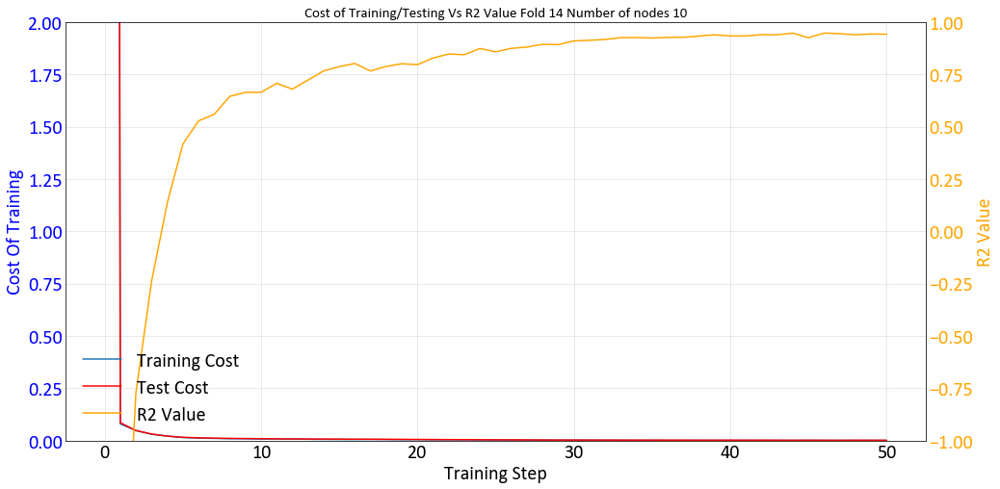

Working on Node 15 fold 14 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpx7ipdd34', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E810007B8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 36.630048751831055
Cost_test : 35.06938
R^2:-1436.6775512695312
Epoch: 100/5000 err = 0.07336267083883286
Cost_test : 0.059021518
R^2:-1.553323745727539
Epoch: 200/5000 err = 0.028862307779490948
Cost_test : 0.030549467
R^2:-0.20910388231277466
Epoch: 300/5000 err = 0.021984818391501904
Cost_test : 0.02248441
R^2:0.25255081057548523
Epoch: 400/5000 err = 0.01602709572762251
Cost_test : 0.017807096
R^2:0.3579082787036896
Epoch: 500/5000 err = 0.013321504462510347
Cost_test : 0.014503311
R^2:0.46114933490753174
Epoch: 600/5000 err = 0.011698225047439337
Cost_test : 0.01214423
R^2:0.5435766577720642
Epoch: 700/5000 err = 0.009699482005089521
Cost_test : 0.0104955835
R^2:0.5954561531543732
Epoch: 800/5000 err = 0.009662441909313202
Cost_test : 0.0091672465
R^2:0.633680671453476
Epoch: 900/5000 err = 0.007166591240093112
Cost_test : 0.008201804
R^2:0.7099165320396423
Epoch: 1000/5000 err = 0.00690712733194232
Cost_test : 0.007350216
R^2:0.7490240335464478
Epoch: 1100/500

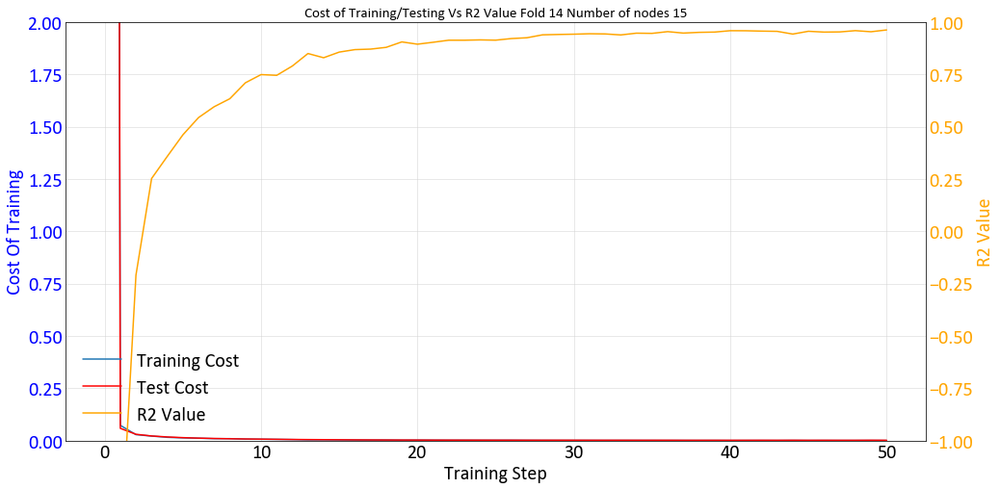

Working on Node 20 fold 14 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp767v4abd', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022ED97057F0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 96.61357498168945
Cost_test : 92.71953
R^2:-3698.653076171875
Epoch: 100/5000 err = 0.12823976576328278
Cost_test : 0.12707965
R^2:-3.721531629562378
Epoch: 200/5000 err = 0.044135576114058495
Cost_test : 0.047173508
R^2:-0.77145916223526
Epoch: 300/5000 err = 0.0259780315682292
Cost_test : 0.029600197
R^2:-0.03621548414230347
Epoch: 400/5000 err = 0.018225827254354954
Cost_test : 0.021929547
R^2:0.2958289086818695
Epoch: 500/5000 err = 0.015303676016628742
Cost_test : 0.017178252
R^2:0.3943292796611786
Epoch: 600/5000 err = 0.01285264641046524
Cost_test : 0.014051646
R^2:0.42554381489753723
Epoch: 700/5000 err = 0.010781204793602228
Cost_test : 0.011854779
R^2:0.575380265712738
Epoch: 800/5000 err = 0.008106136694550514
Cost_test : 0.010058743
R^2:0.6738407909870148
Epoch: 900/5000 err = 0.0073809511959552765
Cost_test : 0.008642534
R^2:0.7119676470756531
Epoch: 1000/5000 err = 0.006554391235113144
Cost_test : 0.0076101134
R^2:0.7233668565750122
Epoch: 1100/5000 er

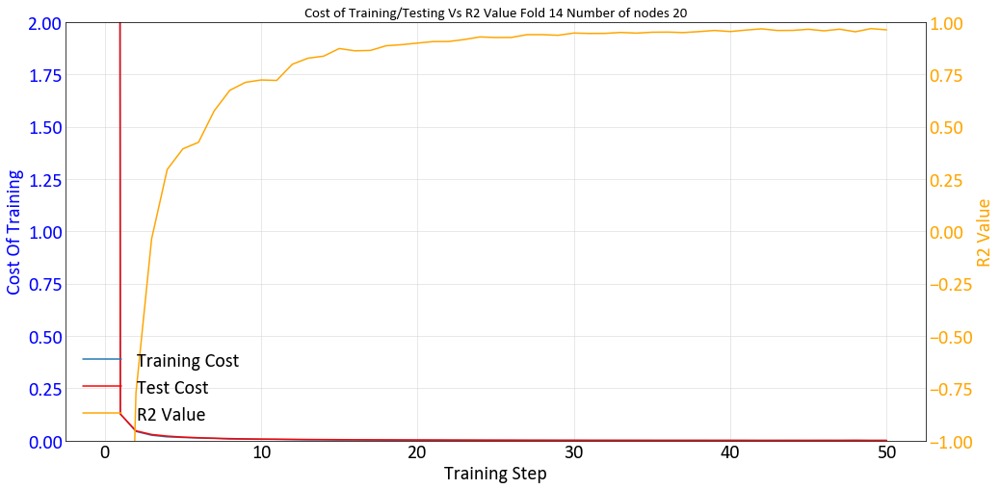

Working on Node 25 fold 14 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpm4vuxik1', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E816CBA20>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 197.97965240478516
Cost_test : 197.14006
R^2:-8021.966064453125
Epoch: 100/5000 err = 0.3364686220884323
Cost_test : 0.2923675
R^2:-13.455734729766846
Epoch: 200/5000 err = 0.08368778601288795
Cost_test : 0.079348266
R^2:-2.552173137664795
Epoch: 300/5000 err = 0.04226367920637131
Cost_test : 0.040933043
R^2:-0.8048228621482849
Epoch: 400/5000 err = 0.0238407114520669
Cost_test : 0.025482818
R^2:0.13436341285705566
Epoch: 500/5000 err = 0.017793367616832256
Cost_test : 0.018236183
R^2:0.25791457295417786
Epoch: 600/5000 err = 0.014008395373821259
Cost_test : 0.014219297
R^2:0.47771865129470825
Epoch: 700/5000 err = 0.009326754603534937
Cost_test : 0.011635014
R^2:0.593430757522583
Epoch: 800/5000 err = 0.008387317648157477
Cost_test : 0.009784127
R^2:0.6525627076625824
Epoch: 900/5000 err = 0.007926202844828367
Cost_test : 0.008500333
R^2:0.6605289578437805
Epoch: 1000/5000 err = 0.006836515851318836
Cost_test : 0.0075551877
R^2:0.7205744087696075
Epoch: 1100/5000 e

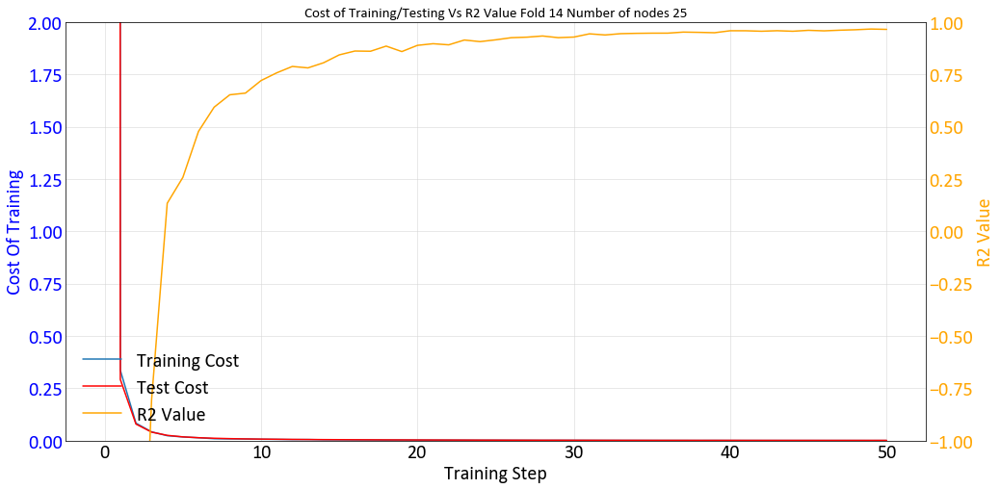

-1.7424
2.4504
15
Working on Node 10 fold 15 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpb_dmly44', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F788898>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 48.068010330200195
Cost_test : 48.073425
R^2:-1976.7468872070312
Epoch: 100/5000 err = 0.06387650594115257
Cost_test : 0.069104075
R^2:-1.7288161516189575
Epoch: 200/5000 err = 0.02349756844341755
Cost_test : 0.027716998
R^2:0.0824500322341919
Epoch: 300/5000 err = 0.01857152860611677
Cost_test : 0.020615034
R^2:0.33758798241615295
Epoch: 400/5000 err = 0.012950299307703972
Cost_test : 0.017744644
R^2:0.5399670004844666
Epoch: 500/5000 err = 0.011087660677731037
Cost_test : 0.015362214
R^2:0.5737994313240051
Epoch: 600/5000 err = 0.011052241083234549
Cost_test : 0.013346478
R^2:0.5646327137947083
Epoch: 700/5000 err = 0.00816444423981011
Cost_test : 0.011747242
R^2:0.6863835453987122
Epoch: 800/5000 err = 0.007324795471504331
Cost_test : 0.0106983865
R^2:0.6994023323059082
Epoch: 900/5000 err = 0.007877207826822996
Cost_test : 0.010300673
R^2:0.6798650622367859
Epoch: 1000/5000 err = 0.007482445100322366
Cost_test : 0.009535981
R^2:0.7293691635131836
Epoch: 1100/500

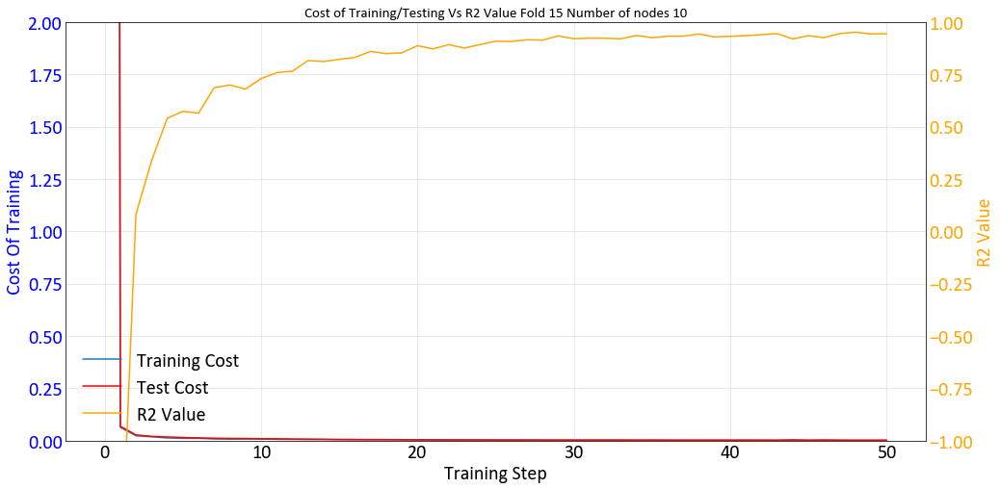

Working on Node 15 fold 15 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp9d4v4820', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E8030AD68>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 76.65340042114258
Cost_test : 73.178406
R^2:-2509.97998046875
Epoch: 100/5000 err = 0.0933772474527359
Cost_test : 0.103633285
R^2:-2.678772211074829
Epoch: 200/5000 err = 0.04072672873735428
Cost_test : 0.04023823
R^2:-0.5886403322219849
Epoch: 300/5000 err = 0.027574473060667515
Cost_test : 0.030445274
R^2:0.030355870723724365
Epoch: 400/5000 err = 0.02168588899075985
Cost_test : 0.026041305
R^2:0.08379289507865906
Epoch: 500/5000 err = 0.017461908981204033
Cost_test : 0.022866352
R^2:0.3754582107067108
Epoch: 600/5000 err = 0.013350991997867823
Cost_test : 0.01973552
R^2:0.5033958256244659
Epoch: 700/5000 err = 0.012927575968205929
Cost_test : 0.01769257
R^2:0.49314287304878235
Epoch: 800/5000 err = 0.01059379382058978
Cost_test : 0.015499163
R^2:0.6006398797035217
Epoch: 900/5000 err = 0.009180841501802206
Cost_test : 0.013928104
R^2:0.6189333498477936
Epoch: 1000/5000 err = 0.008566752076148987
Cost_test : 0.01248173
R^2:0.6836811006069183
Epoch: 1100/5000 err 

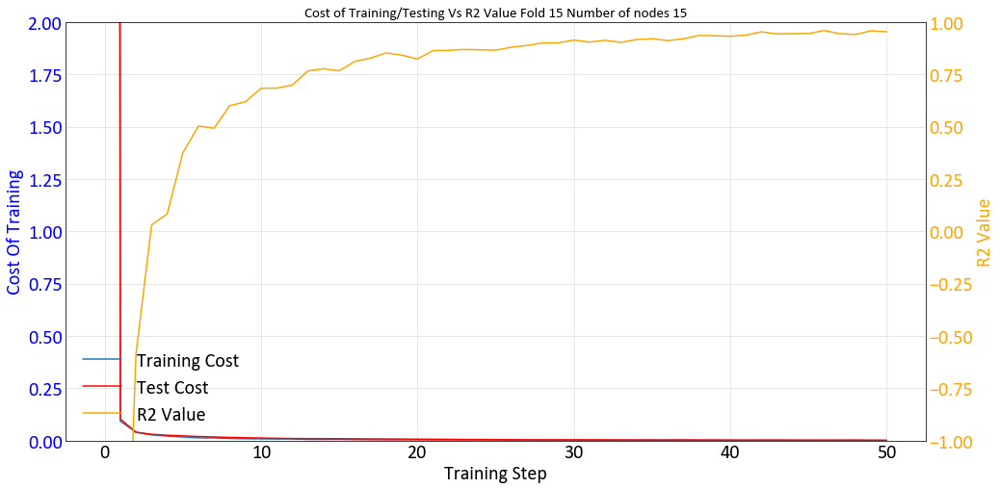

Working on Node 20 fold 15 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp757_r126', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0A1289B0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 93.56170654296875
Cost_test : 90.42098
R^2:-3634.181396484375
Epoch: 100/5000 err = 0.14571358263492584
Cost_test : 0.16456226
R^2:-4.422665119171143
Epoch: 200/5000 err = 0.04449792765080929
Cost_test : 0.04752702
R^2:-0.6530261039733887
Epoch: 300/5000 err = 0.029377128928899765
Cost_test : 0.029622726
R^2:-0.10934042930603027
Epoch: 400/5000 err = 0.021463987417519093
Cost_test : 0.022978017
R^2:0.17019161581993103
Epoch: 500/5000 err = 0.015509581658989191
Cost_test : 0.018171282
R^2:0.41529372334480286
Epoch: 600/5000 err = 0.012923435773700476
Cost_test : 0.014892795
R^2:0.4908737540245056
Epoch: 700/5000 err = 0.010475970339030027
Cost_test : 0.012879273
R^2:0.6263852119445801
Epoch: 800/5000 err = 0.00809864467009902
Cost_test : 0.011547842
R^2:0.6737039387226105
Epoch: 900/5000 err = 0.006815548986196518
Cost_test : 0.0104422895
R^2:0.7534137666225433
Epoch: 1000/5000 err = 0.006719635101035237
Cost_test : 0.009533141
R^2:0.7266350388526917
Epoch: 1100/5000

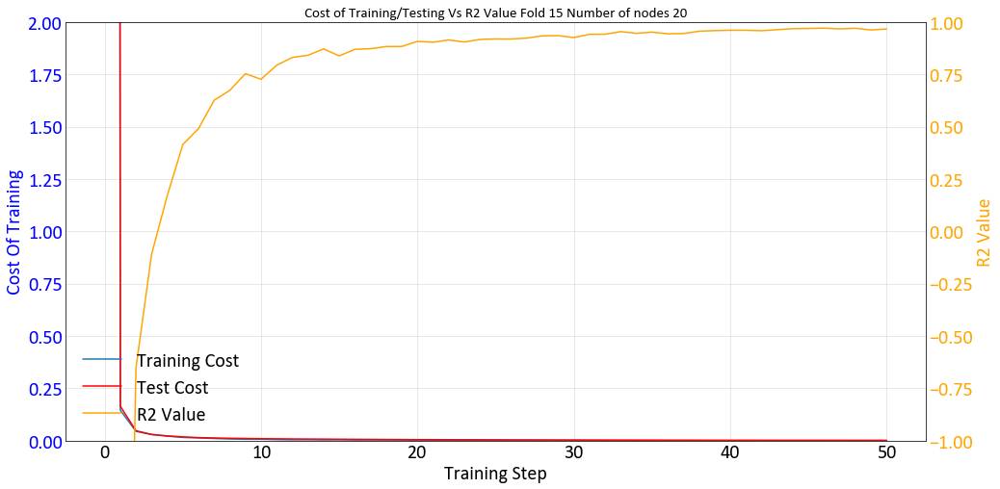

Working on Node 25 fold 15 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp13aqnke4', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0D463588>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 105.50159072875977
Cost_test : 98.29475
R^2:-4427.402587890625
Epoch: 100/5000 err = 0.14765559136867523
Cost_test : 0.16520435
R^2:-4.982800722122192
Epoch: 200/5000 err = 0.0389374103397131
Cost_test : 0.05346309
R^2:-0.5334274768829346
Epoch: 300/5000 err = 0.028765645809471607
Cost_test : 0.035648353
R^2:-0.01585221290588379
Epoch: 400/5000 err = 0.016857078298926353
Cost_test : 0.026621299
R^2:0.3003407418727875
Epoch: 500/5000 err = 0.012780718505382538
Cost_test : 0.020312177
R^2:0.5481445789337158
Epoch: 600/5000 err = 0.011006283108144999
Cost_test : 0.015962435
R^2:0.597551167011261
Epoch: 700/5000 err = 0.007650814251974225
Cost_test : 0.0129029965
R^2:0.7032898366451263
Epoch: 800/5000 err = 0.006543809315189719
Cost_test : 0.010575759
R^2:0.7273402512073517
Epoch: 900/5000 err = 0.006178358802571893
Cost_test : 0.009097547
R^2:0.782392829656601
Epoch: 1000/5000 err = 0.004548798548057675
Cost_test : 0.00787071
R^2:0.8271308243274689
Epoch: 1100/5000 err

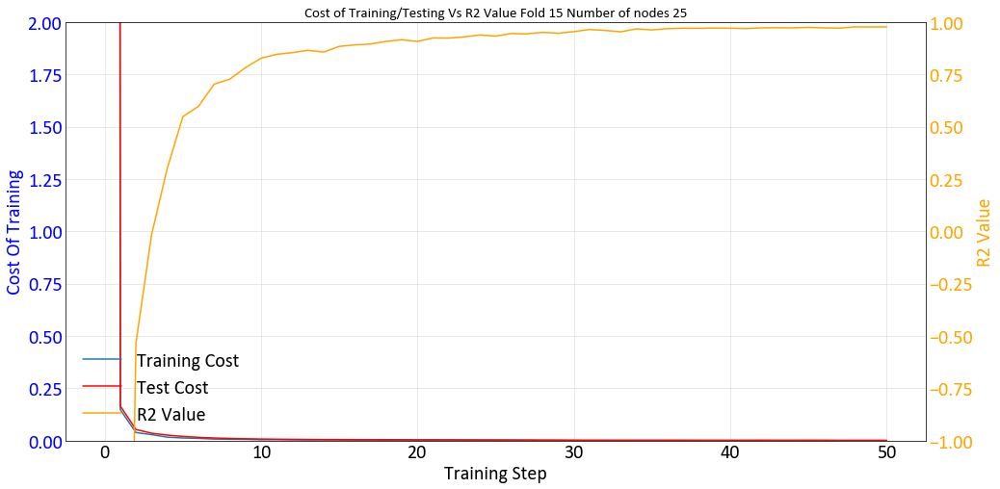

-1.7424
2.4504
16
Working on Node 10 fold 16 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpb4cu67zd', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F1B2F28>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 48.619977951049805
Cost_test : 47.247128
R^2:-2068.6307373046875
Epoch: 100/5000 err = 0.06576243415474892
Cost_test : 0.055488903
R^2:-1.659162163734436
Epoch: 200/5000 err = 0.035331426188349724
Cost_test : 0.026165655
R^2:-0.40213441848754883
Epoch: 300/5000 err = 0.02290447149425745
Cost_test : 0.02099884
R^2:0.12279778718948364
Epoch: 400/5000 err = 0.01593084493651986
Cost_test : 0.018427452
R^2:0.33718377351760864
Epoch: 500/5000 err = 0.013791624456644058
Cost_test : 0.015836442
R^2:0.41713637113571167
Epoch: 600/5000 err = 0.011217993218451738
Cost_test : 0.013881731
R^2:0.5585029721260071
Epoch: 700/5000 err = 0.010150005109608173
Cost_test : 0.012286167
R^2:0.5798657834529877
Epoch: 800/5000 err = 0.009771761950105429
Cost_test : 0.010689248
R^2:0.6242625713348389
Epoch: 900/5000 err = 0.008724881801754236
Cost_test : 0.009596552
R^2:0.6491317749023438
Epoch: 1000/5000 err = 0.006624595727771521
Cost_test : 0.008384252
R^2:0.7032192349433899
Epoch: 1100/5

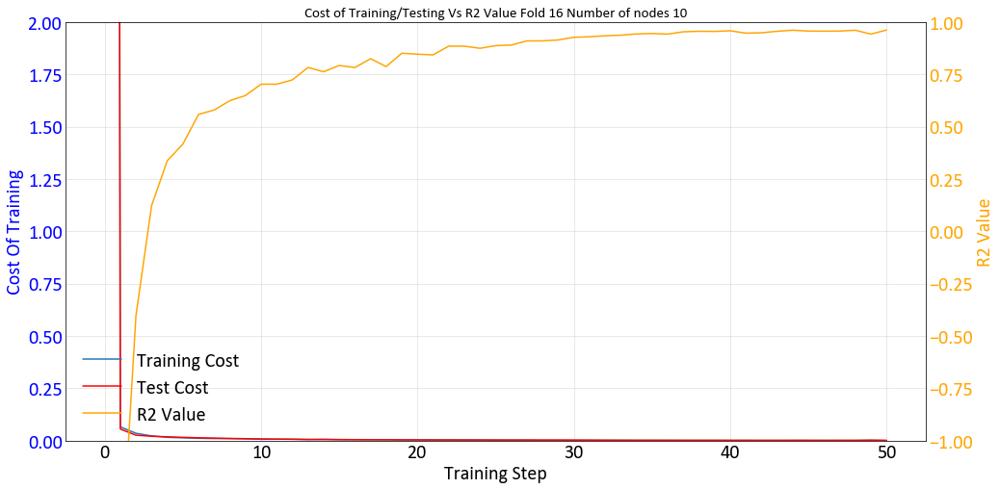

Working on Node 15 fold 16 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpi_er6rgw', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E80FAAEB8>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 101.33885192871094
Cost_test : 97.73656
R^2:-4560.38671875
Epoch: 100/5000 err = 0.2234416976571083
Cost_test : 0.19668947
R^2:-8.33545994758606
Epoch: 200/5000 err = 0.06479468196630478
Cost_test : 0.06215461
R^2:-2.1718032360076904
Epoch: 300/5000 err = 0.03514009341597557
Cost_test : 0.028628802
R^2:-0.35774266719818115
Epoch: 400/5000 err = 0.02057354710996151
Cost_test : 0.017505866
R^2:0.18588998913764954
Epoch: 500/5000 err = 0.01663655275478959
Cost_test : 0.013351594
R^2:0.28827792406082153
Epoch: 600/5000 err = 0.011885248124599457
Cost_test : 0.011485999
R^2:0.4709126651287079
Epoch: 700/5000 err = 0.011902273632586002
Cost_test : 0.010378794
R^2:0.508531391620636
Epoch: 800/5000 err = 0.010578753426671028
Cost_test : 0.009474614
R^2:0.5662544369697571
Epoch: 900/5000 err = 0.008916440885514021
Cost_test : 0.00885034
R^2:0.6068452596664429
Epoch: 1000/5000 err = 0.007190627511590719
Cost_test : 0.008227003
R^2:0.7056712508201599
Epoch: 1100/5000 err = 0.0

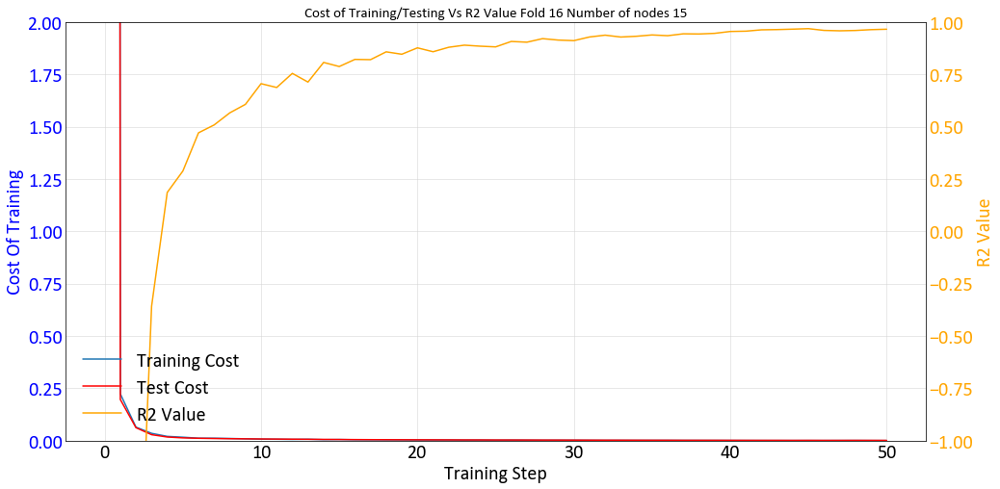

Working on Node 20 fold 16 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpkmzxmlp_', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F12AC5470>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 176.01001739501953
Cost_test : 171.36992
R^2:-5793.195556640625
Epoch: 100/5000 err = 0.3529243618249893
Cost_test : 0.3064934
R^2:-11.820547103881836
Epoch: 200/5000 err = 0.09230160713195801
Cost_test : 0.09589313
R^2:-2.4334017038345337
Epoch: 300/5000 err = 0.04338862560689449
Cost_test : 0.04501776
R^2:-0.9491231441497803
Epoch: 400/5000 err = 0.0280384523794055
Cost_test : 0.027289407
R^2:-0.1702679991722107
Epoch: 500/5000 err = 0.017891956493258476
Cost_test : 0.019821342
R^2:0.2644226849079132
Epoch: 600/5000 err = 0.015528034418821335
Cost_test : 0.015661996
R^2:0.3059096038341522
Epoch: 700/5000 err = 0.01309733185917139
Cost_test : 0.012936634
R^2:0.5061053335666656
Epoch: 800/5000 err = 0.010650804731994867
Cost_test : 0.011015311
R^2:0.5026875734329224
Epoch: 900/5000 err = 0.010385908652096987
Cost_test : 0.00970854
R^2:0.5538425147533417
Epoch: 1000/5000 err = 0.009222738444805145
Cost_test : 0.008508767
R^2:0.6208815276622772
Epoch: 1100/5000 err = 

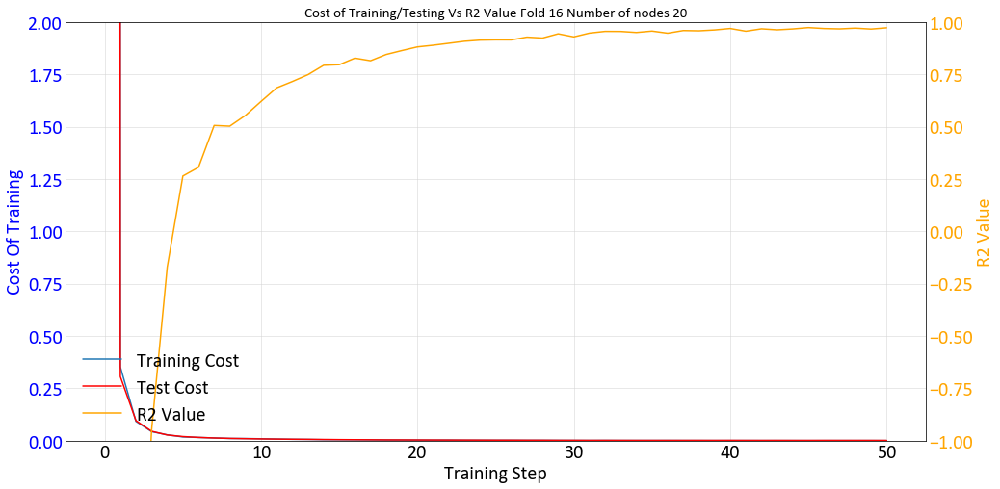

Working on Node 25 fold 16 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpc8hhsscl', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E816E0160>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 59.004228591918945
Cost_test : 50.049236
R^2:-2440.4830322265625
Epoch: 100/5000 err = 0.06416518986225128
Cost_test : 0.08592946
R^2:-1.5508513450622559
Epoch: 200/5000 err = 0.02825211826711893
Cost_test : 0.043527856
R^2:-0.10726362466812134
Epoch: 300/5000 err = 0.014824395067989826
Cost_test : 0.024354646
R^2:0.3290269672870636
Epoch: 400/5000 err = 0.00889290263876319
Cost_test : 0.016406212
R^2:0.6203098297119141
Epoch: 500/5000 err = 0.007242327788844705
Cost_test : 0.012869334
R^2:0.6763738691806793
Epoch: 600/5000 err = 0.00599920516833663
Cost_test : 0.010736951
R^2:0.7588624358177185
Epoch: 700/5000 err = 0.004716981668025255
Cost_test : 0.009353268
R^2:0.7949076294898987
Epoch: 800/5000 err = 0.003317237598821521
Cost_test : 0.008162381
R^2:0.8797634243965149
Epoch: 900/5000 err = 0.0037773954682052135
Cost_test : 0.007202692
R^2:0.8608490228652954
Epoch: 1000/5000 err = 0.002915671677328646
Cost_test : 0.0064547653
R^2:0.8858234584331512
Epoch: 1100/50

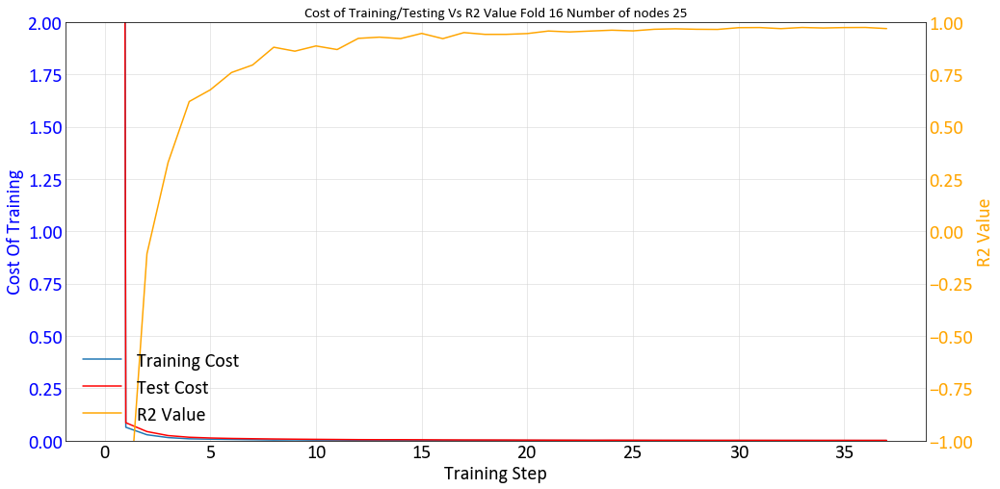

-1.7424
1.9021
17
Working on Node 10 fold 17 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpby8crx_4', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0ACBA5C0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 33.007853507995605
Cost_test : 31.559774
R^2:-1079.646484375
Epoch: 100/5000 err = 0.06229339353740215
Cost_test : 0.06861203
R^2:-1.5530261993408203
Epoch: 200/5000 err = 0.02376189734786749
Cost_test : 0.036503814
R^2:0.2758655846118927
Epoch: 300/5000 err = 0.019751752726733685
Cost_test : 0.025694696
R^2:0.2626209855079651
Epoch: 400/5000 err = 0.013484649825841188
Cost_test : 0.01845398
R^2:0.534537672996521
Epoch: 500/5000 err = 0.00973456772044301
Cost_test : 0.0132818995
R^2:0.6820660531520844
Epoch: 600/5000 err = 0.008704274892807007
Cost_test : 0.009992725
R^2:0.7140374779701233
Epoch: 700/5000 err = 0.005757489241659641
Cost_test : 0.0080727525
R^2:0.7883139848709106
Epoch: 800/5000 err = 0.005089938640594482
Cost_test : 0.0067383484
R^2:0.8042453229427338
Epoch: 900/5000 err = 0.0040249458979815245
Cost_test : 0.00562955
R^2:0.854761004447937
Epoch: 1000/5000 err = 0.00403861200902611
Cost_test : 0.0053430437
R^2:0.8491110503673553
Epoch: 1100/5000 err 

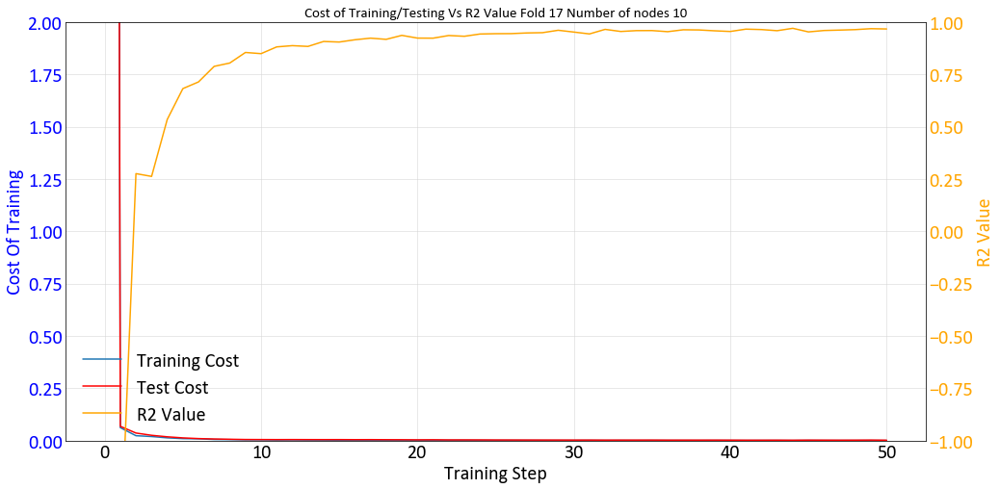

Working on Node 15 fold 17 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmppk1qsuo7', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F8FA208>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 86.82278060913086
Cost_test : 85.22932
R^2:-3089.99560546875
Epoch: 100/5000 err = 0.1434217169880867
Cost_test : 0.18255208
R^2:-4.006121397018433
Epoch: 200/5000 err = 0.046203525736927986
Cost_test : 0.07271424
R^2:-0.4880998134613037
Epoch: 300/5000 err = 0.02609001100063324
Cost_test : 0.040178955
R^2:0.0975601077079773
Epoch: 400/5000 err = 0.01654762402176857
Cost_test : 0.024392722
R^2:0.3989620804786682
Epoch: 500/5000 err = 0.011452456004917622
Cost_test : 0.017482447
R^2:0.5803319811820984
Epoch: 600/5000 err = 0.011751484591513872
Cost_test : 0.015164104
R^2:0.6363674402236938
Epoch: 700/5000 err = 0.00919707678258419
Cost_test : 0.012956831
R^2:0.6727532148361206
Epoch: 800/5000 err = 0.008178807329386473
Cost_test : 0.011392299
R^2:0.7379253506660461
Epoch: 900/5000 err = 0.007474228972569108
Cost_test : 0.0100811245
R^2:0.7449857890605927
Epoch: 1000/5000 err = 0.00500681484118104
Cost_test : 0.008938071
R^2:0.8189261257648468
Epoch: 1100/5000 err = 0

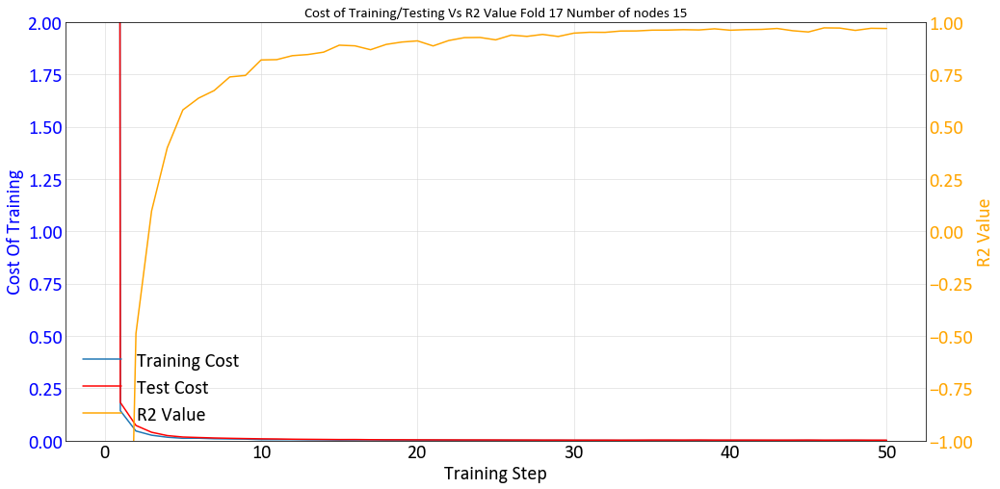

Working on Node 20 fold 17 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmppe2ophpe', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F133705C0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 68.28095245361328
Cost_test : 62.214325
R^2:-2271.5919189453125
Epoch: 100/5000 err = 0.1282266229391098
Cost_test : 0.15611465
R^2:-3.3191516399383545
Epoch: 200/5000 err = 0.03834637254476547
Cost_test : 0.05770381
R^2:-0.26339179277420044
Epoch: 300/5000 err = 0.02178174164146185
Cost_test : 0.03130443
R^2:0.10011273622512817
Epoch: 400/5000 err = 0.015091774519532919
Cost_test : 0.021093687
R^2:0.5112906098365784
Epoch: 500/5000 err = 0.012663143686950207
Cost_test : 0.015997944
R^2:0.5381854176521301
Epoch: 600/5000 err = 0.009354040957987309
Cost_test : 0.012834285
R^2:0.6482439637184143
Epoch: 700/5000 err = 0.008913970785215497
Cost_test : 0.010738432
R^2:0.6934599280357361
Epoch: 800/5000 err = 0.006479552481323481
Cost_test : 0.009298909
R^2:0.7850652933120728
Epoch: 900/5000 err = 0.005020650569349527
Cost_test : 0.006915703
R^2:0.8176257014274597
Epoch: 1000/5000 err = 0.004152840934693813
Cost_test : 0.005772484
R^2:0.8538807034492493
Epoch: 1100/5000 e

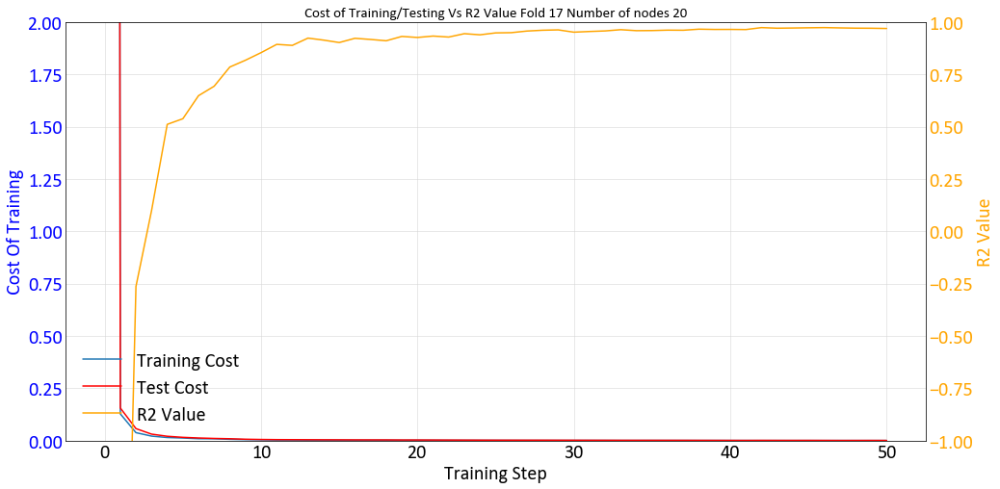

Working on Node 25 fold 17 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmptsxfqhfu', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E887392B0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 177.75617218017578
Cost_test : 170.38702
R^2:-6484.58203125
Epoch: 100/5000 err = 0.35909639298915863
Cost_test : 0.39193082
R^2:-12.542760372161865
Epoch: 200/5000 err = 0.07730554789304733
Cost_test : 0.10956344
R^2:-1.9586399793624878
Epoch: 300/5000 err = 0.03294680081307888
Cost_test : 0.054650474
R^2:-0.2654695510864258
Epoch: 400/5000 err = 0.02001297753304243
Cost_test : 0.03670838
R^2:0.2743228077888489
Epoch: 500/5000 err = 0.01745088677853346
Cost_test : 0.028108785
R^2:0.37799742817878723
Epoch: 600/5000 err = 0.014690154697746038
Cost_test : 0.02328608
R^2:0.48969265818595886
Epoch: 700/5000 err = 0.011491455603390932
Cost_test : 0.019617151
R^2:0.6106508374214172
Epoch: 800/5000 err = 0.010786801110953093
Cost_test : 0.016997466
R^2:0.6060482263565063
Epoch: 900/5000 err = 0.008143262937664986
Cost_test : 0.015098642
R^2:0.7424860000610352
Epoch: 1000/5000 err = 0.007383913267403841
Cost_test : 0.013134447
R^2:0.7424713969230652
Epoch: 1100/5000 err = 

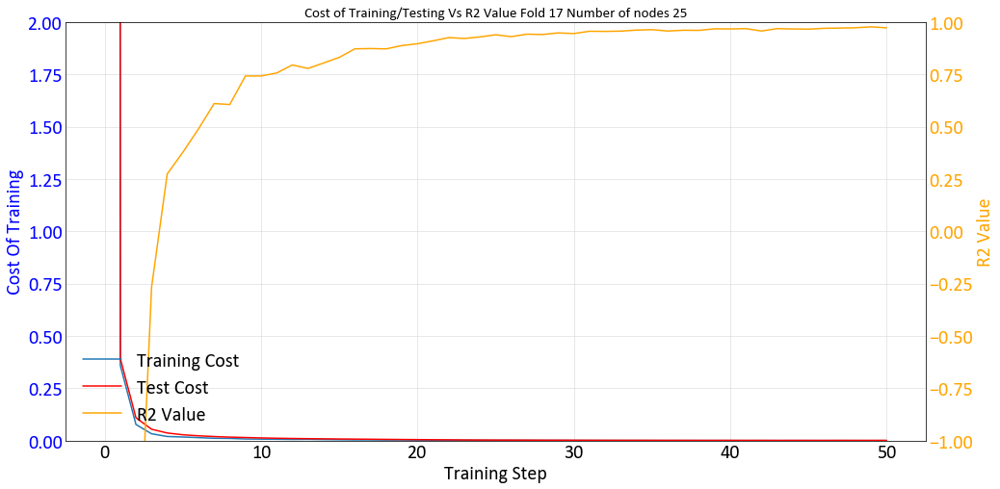

-1.7424
1.8552
18
Working on Node 10 fold 18 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpxyqngd9u', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F36F748>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 36.53196716308594
Cost_test : 34.460526
R^2:-1336.9893798828125
Epoch: 100/5000 err = 0.08432113006711006
Cost_test : 0.10783436
R^2:-2.2375906705856323
Epoch: 200/5000 err = 0.021716956049203873
Cost_test : 0.02810918
R^2:0.17649349570274353
Epoch: 300/5000 err = 0.011971286498010159
Cost_test : 0.014637451
R^2:0.6250481009483337
Epoch: 400/5000 err = 0.010101838503032923
Cost_test : 0.010945347
R^2:0.6136749982833862
Epoch: 500/5000 err = 0.00815507723018527
Cost_test : 0.009338148
R^2:0.7015717029571533
Epoch: 600/5000 err = 0.007370099658146501
Cost_test : 0.008452606
R^2:0.7050805985927582
Epoch: 700/5000 err = 0.006417799508199096
Cost_test : 0.007963107
R^2:0.7491392195224762
Epoch: 800/5000 err = 0.005268392851576209
Cost_test : 0.0074498993
R^2:0.7924507856369019
Epoch: 900/5000 err = 0.005120630608871579
Cost_test : 0.006954204
R^2:0.7798458635807037
Epoch: 1000/5000 err = 0.004621301777660847
Cost_test : 0.006655047
R^2:0.8158903419971466
Epoch: 1100/5000

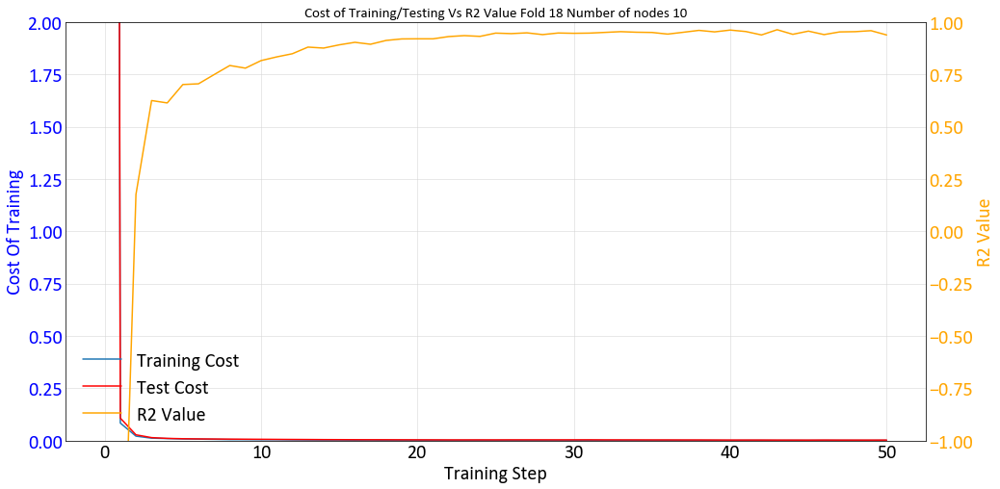

Working on Node 15 fold 18 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpf0ee0t19', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E88491438>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 92.93756866455078
Cost_test : 86.12503
R^2:-3649.06005859375
Epoch: 100/5000 err = 0.17446795105934143
Cost_test : 0.19470349
R^2:-5.65939736366272
Epoch: 200/5000 err = 0.039165178313851357
Cost_test : 0.053812105
R^2:-0.47934967279434204
Epoch: 300/5000 err = 0.017741696909070015
Cost_test : 0.025856983
R^2:0.31698593497276306
Epoch: 400/5000 err = 0.01167623233050108
Cost_test : 0.016534379
R^2:0.5966903567314148
Epoch: 500/5000 err = 0.008273666491732001
Cost_test : 0.012899076
R^2:0.6430680751800537
Epoch: 600/5000 err = 0.007189292926341295
Cost_test : 0.011244651
R^2:0.7103602886199951
Epoch: 700/5000 err = 0.006571451900526881
Cost_test : 0.010222839
R^2:0.7631637454032898
Epoch: 800/5000 err = 0.005916587309911847
Cost_test : 0.010083416
R^2:0.7737377882003784
Epoch: 900/5000 err = 0.005783505737781525
Cost_test : 0.0099002225
R^2:0.7682163715362549
Epoch: 1000/5000 err = 0.0047820876352488995
Cost_test : 0.009565543
R^2:0.8454491198062897
Epoch: 1100/5000 

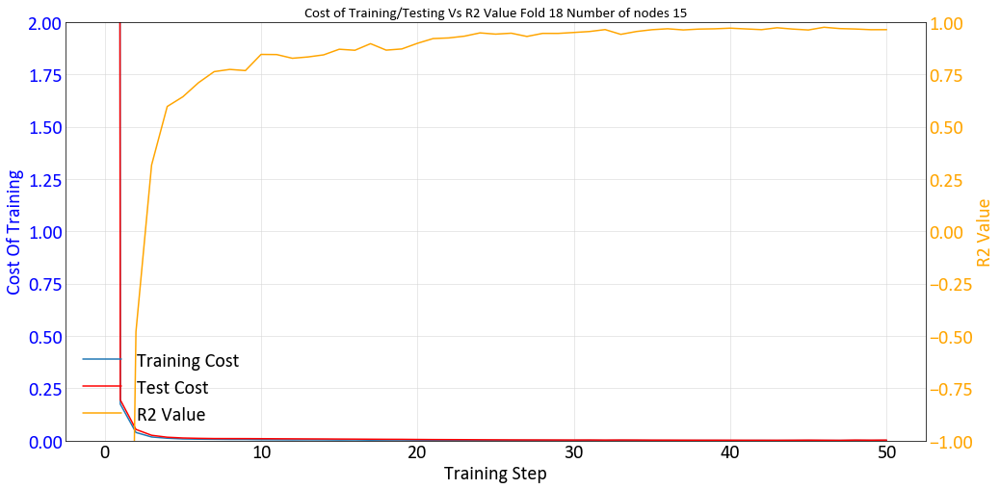

Working on Node 20 fold 18 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp_ogv4k76', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F12F2C0F0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 128.88685607910156
Cost_test : 111.65524
R^2:-5645.478759765625
Epoch: 100/5000 err = 0.19728607684373856
Cost_test : 0.21197808
R^2:-6.571351528167725
Epoch: 200/5000 err = 0.03552443627268076
Cost_test : 0.039153654
R^2:-0.3510621190071106
Epoch: 300/5000 err = 0.012454856652766466
Cost_test : 0.016201964
R^2:0.5042971074581146
Epoch: 400/5000 err = 0.008370451396331191
Cost_test : 0.011648688
R^2:0.7031182646751404
Epoch: 500/5000 err = 0.008214822970330715
Cost_test : 0.010592557
R^2:0.6714345812797546
Epoch: 600/5000 err = 0.006775981513783336
Cost_test : 0.009752203
R^2:0.7029990255832672
Epoch: 700/5000 err = 0.005965100368484855
Cost_test : 0.009184433
R^2:0.7812368869781494
Epoch: 800/5000 err = 0.006082788109779358
Cost_test : 0.008508753
R^2:0.766973614692688
Epoch: 900/5000 err = 0.004428851418197155
Cost_test : 0.008050667
R^2:0.8489010632038116
Epoch: 1000/5000 err = 0.004147686995565891
Cost_test : 0.007403131
R^2:0.8452534079551697
Epoch: 1100/5000 e

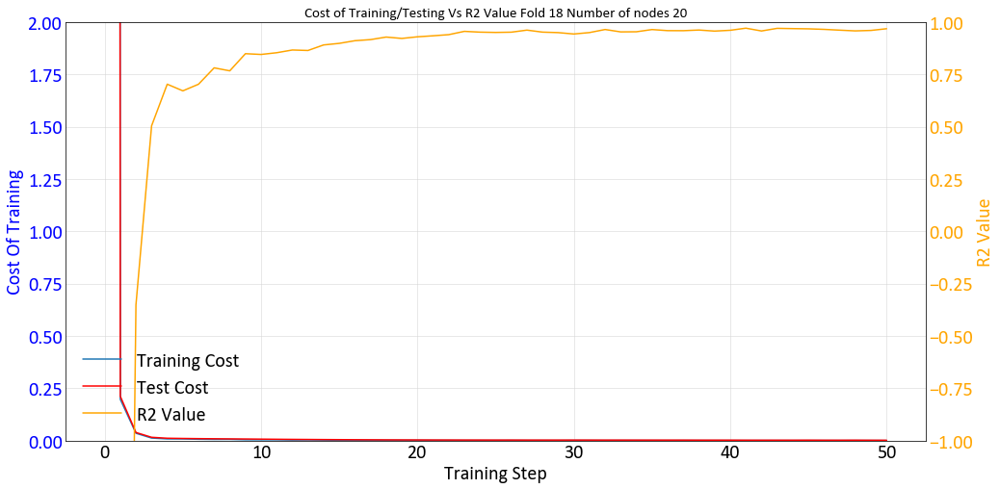

Working on Node 25 fold 18 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp960egqc3', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0CE44748>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 115.44546127319336
Cost_test : 100.218994
R^2:-4395.1923828125
Epoch: 100/5000 err = 0.1550142541527748
Cost_test : 0.1479224
R^2:-5.883641004562378
Epoch: 200/5000 err = 0.025784093886613846
Cost_test : 0.027323617
R^2:-0.05152738094329834
Epoch: 300/5000 err = 0.0159368054009974
Cost_test : 0.017766885
R^2:0.4338945150375366
Epoch: 400/5000 err = 0.011135205626487732
Cost_test : 0.015346782
R^2:0.579694002866745
Epoch: 500/5000 err = 0.009971642401069403
Cost_test : 0.013812979
R^2:0.6733766198158264
Epoch: 600/5000 err = 0.009786509908735752
Cost_test : 0.012374119
R^2:0.6653285920619965
Epoch: 700/5000 err = 0.006972937611863017
Cost_test : 0.01051254
R^2:0.6982082426548004
Epoch: 800/5000 err = 0.005584836006164551
Cost_test : 0.009157176
R^2:0.7829865217208862
Epoch: 900/5000 err = 0.004363316344097257
Cost_test : 0.007845429
R^2:0.8177967667579651
Epoch: 1000/5000 err = 0.004501583753153682
Cost_test : 0.006721276
R^2:0.7813872396945953
Epoch: 1100/5000 err =

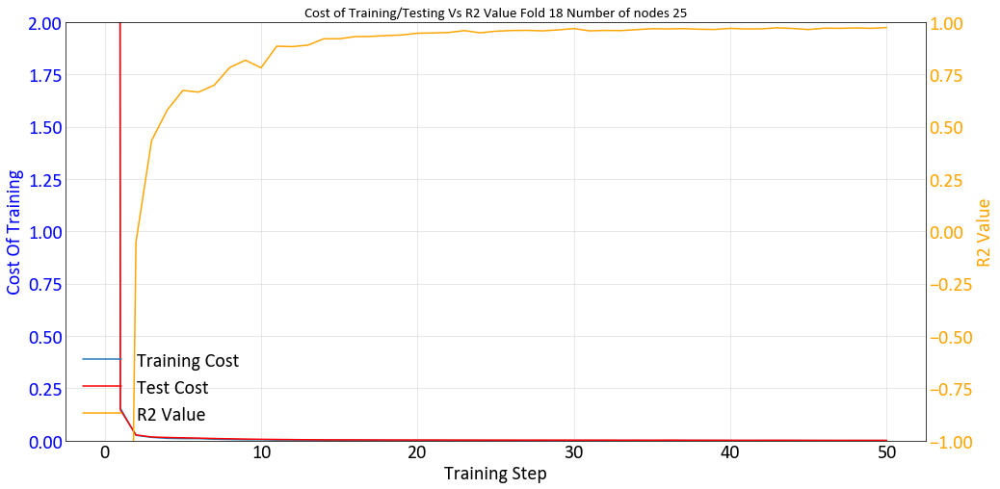

-1.0086
1.8552
19
Working on Node 10 fold 19 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmp0h_oep0h', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F15D16320>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 60.170528411865234
Cost_test : 59.220623
R^2:-1560.2265625
Epoch: 100/5000 err = 0.07894968241453171
Cost_test : 0.06414009
R^2:-0.9551264047622681
Epoch: 200/5000 err = 0.02863266784697771
Cost_test : 0.028613022
R^2:0.24708044528961182
Epoch: 300/5000 err = 0.024340905249118805
Cost_test : 0.022570342
R^2:0.3430415093898773
Epoch: 400/5000 err = 0.016676597762852907
Cost_test : 0.020499257
R^2:0.5835371017456055
Epoch: 500/5000 err = 0.015461801085621119
Cost_test : 0.018882418
R^2:0.6182659268379211
Epoch: 600/5000 err = 0.010760362725704908
Cost_test : 0.01712889
R^2:0.7173899710178375
Epoch: 700/5000 err = 0.01064402936026454
Cost_test : 0.015439447
R^2:0.7068954706192017
Epoch: 800/5000 err = 0.011723767500370741
Cost_test : 0.013967148
R^2:0.7191637456417084
Epoch: 900/5000 err = 0.009067142847925425
Cost_test : 0.012736194
R^2:0.7799447476863861
Epoch: 1000/5000 err = 0.0083600920625031
Cost_test : 0.01182128
R^2:0.8168050348758698
Epoch: 1100/5000 err = 0.0

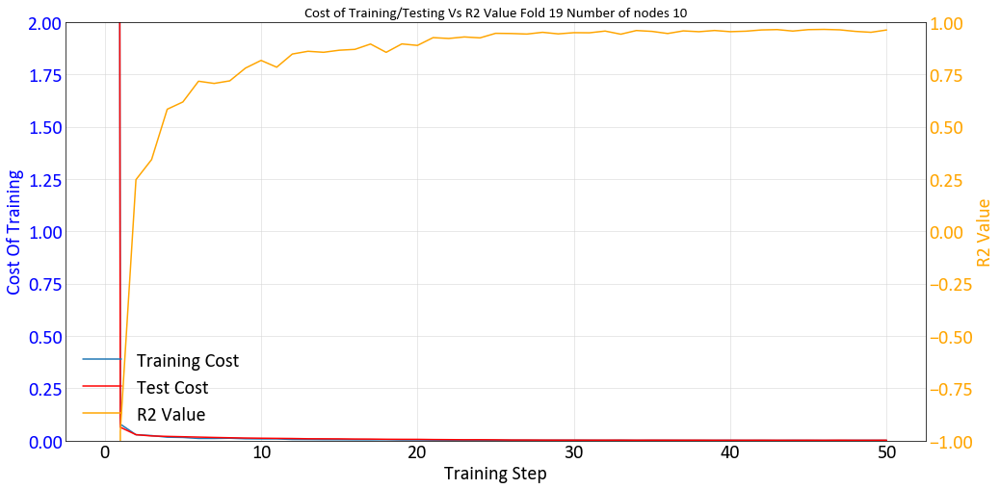

Working on Node 15 fold 19 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpk00pgqjo', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0FF24C88>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 108.11359786987305
Cost_test : 106.08557
R^2:-2532.892822265625
Epoch: 100/5000 err = 0.22871943563222885
Cost_test : 0.16714406
R^2:-4.729613780975342
Epoch: 200/5000 err = 0.05523185059428215
Cost_test : 0.06529638
R^2:-0.37263667583465576
Epoch: 300/5000 err = 0.02967914380133152
Cost_test : 0.03452312
R^2:0.18335095047950745
Epoch: 400/5000 err = 0.01659384835511446
Cost_test : 0.02297298
R^2:0.5404027998447418
Epoch: 500/5000 err = 0.01326557295396924
Cost_test : 0.018930951
R^2:0.6274084746837616
Epoch: 600/5000 err = 0.012174490839242935
Cost_test : 0.017299341
R^2:0.6325670480728149
Epoch: 700/5000 err = 0.014725276734679937
Cost_test : 0.0162844
R^2:0.5707694292068481
Epoch: 800/5000 err = 0.010645001661032438
Cost_test : 0.015330312
R^2:0.746368795633316
Epoch: 900/5000 err = 0.010521862655878067
Cost_test : 0.014768858
R^2:0.7478218078613281
Epoch: 1000/5000 err = 0.009404512122273445
Cost_test : 0.014285304
R^2:0.7450243532657623
Epoch: 1100/5000 err = 0

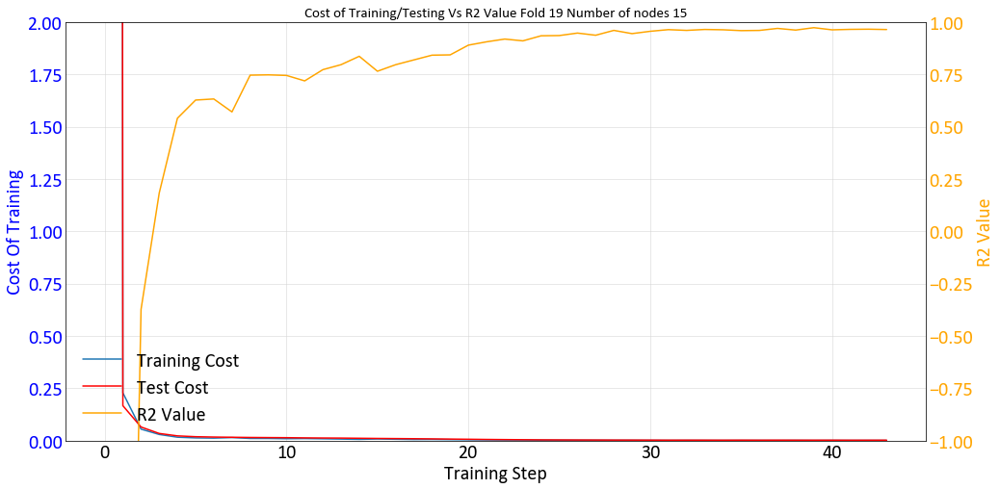

Working on Node 20 fold 19 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpwe8ym1ti', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0D5F0550>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 190.72874450683594
Cost_test : 187.56078
R^2:-5183.39208984375
Epoch: 100/5000 err = 0.37542015314102173
Cost_test : 0.2671027
R^2:-8.984846591949463
Epoch: 200/5000 err = 0.10216129943728447
Cost_test : 0.10332486
R^2:-1.8224403858184814
Epoch: 300/5000 err = 0.04177231527864933
Cost_test : 0.04754989
R^2:-0.06693196296691895
Epoch: 400/5000 err = 0.022510293405503035
Cost_test : 0.024802445
R^2:0.4124714732170105
Epoch: 500/5000 err = 0.013633328024297953
Cost_test : 0.018369036
R^2:0.6723695397377014
Epoch: 600/5000 err = 0.01171532180160284
Cost_test : 0.016108759
R^2:0.6833693981170654
Epoch: 700/5000 err = 0.008845122996717691
Cost_test : 0.014856584
R^2:0.7675803899765015
Epoch: 800/5000 err = 0.011122931726276875
Cost_test : 0.013799506
R^2:0.6683106124401093
Epoch: 900/5000 err = 0.007533951196819544
Cost_test : 0.0128612155
R^2:0.8203247785568237
Epoch: 1000/5000 err = 0.007852377835661173
Cost_test : 0.012049515
R^2:0.7964673936367035
Epoch: 1100/5000 err

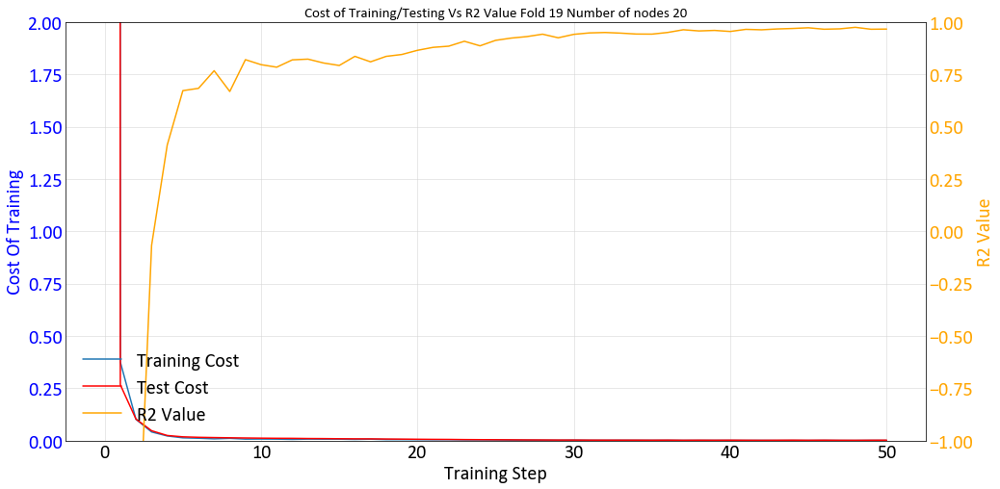

Working on Node 25 fold 19 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpvoi5cuax', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0F5164E0>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 213.6465301513672
Cost_test : 209.50627
R^2:-6069.306884765625
Epoch: 100/5000 err = 0.4367169886827469
Cost_test : 0.33984682
R^2:-10.893255710601807
Epoch: 200/5000 err = 0.09308817982673645
Cost_test : 0.103665985
R^2:-1.8415707349777222
Epoch: 300/5000 err = 0.04631800390779972
Cost_test : 0.057863254
R^2:-0.12358653545379639
Epoch: 400/5000 err = 0.017007020767778158
Cost_test : 0.03481144
R^2:0.5934525430202484
Epoch: 500/5000 err = 0.012804864440113306
Cost_test : 0.026448319
R^2:0.6839209496974945
Epoch: 600/5000 err = 0.010347648058086634
Cost_test : 0.022555118
R^2:0.7321599721908569
Epoch: 700/5000 err = 0.00928074074909091
Cost_test : 0.020147938
R^2:0.7407559156417847
Epoch: 800/5000 err = 0.011638151481747627
Cost_test : 0.01829897
R^2:0.688507616519928
Epoch: 900/5000 err = 0.011903586331754923
Cost_test : 0.017162064
R^2:0.7039816975593567
Epoch: 1000/5000 err = 0.007941852090880275
Cost_test : 0.01596987
R^2:0.8263003826141357
Epoch: 1100/5000 err =

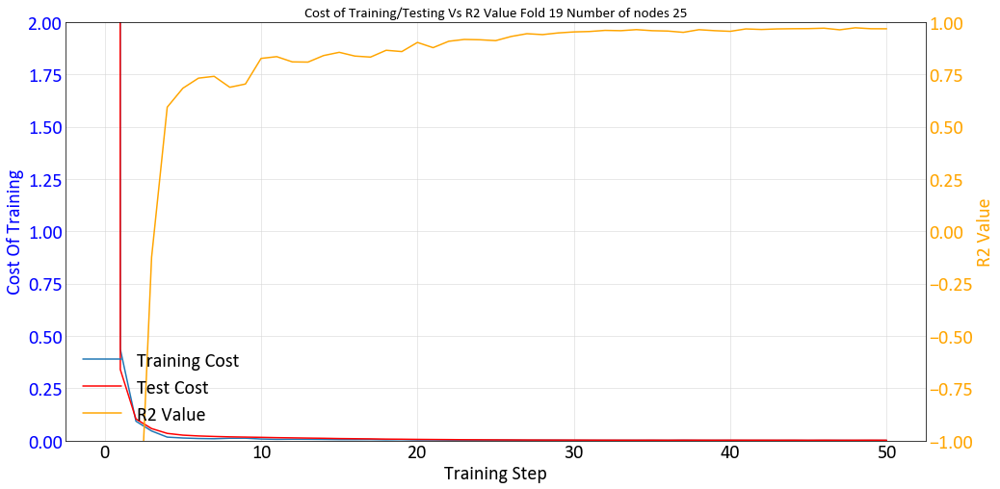

-0.7703
1.8552
20
Working on Node 10 fold 20 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpv4llgg45', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0FA7AB70>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done ca

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 49.91769027709961
Cost_test : 49.048016
R^2:-922.7945556640625
Epoch: 100/5000 err = 0.07614782825112343
Cost_test : 0.11906331
R^2:-1.0618739128112793
Epoch: 200/5000 err = 0.03713233396410942
Cost_test : 0.050551653
R^2:-0.12404200434684753
Epoch: 300/5000 err = 0.025006619282066822
Cost_test : 0.02904308
R^2:0.3672943413257599
Epoch: 400/5000 err = 0.015589841175824404
Cost_test : 0.020495946
R^2:0.5486251711845398
Epoch: 500/5000 err = 0.01053419103845954
Cost_test : 0.01564267
R^2:0.7168693840503693
Epoch: 600/5000 err = 0.008710553869605064
Cost_test : 0.012689441
R^2:0.7912574112415314
Epoch: 700/5000 err = 0.011036057025194168
Cost_test : 0.010730372
R^2:0.8021646738052368
Epoch: 800/5000 err = 0.007368344580754638
Cost_test : 0.009864855
R^2:0.8104633688926697
Epoch: 900/5000 err = 0.005453510209918022
Cost_test : 0.009429297
R^2:0.8655568957328796
Epoch: 1000/5000 err = 0.006369579816237092
Cost_test : 0.009567376
R^2:0.8115050196647644
Epoch: 1100/5000 er

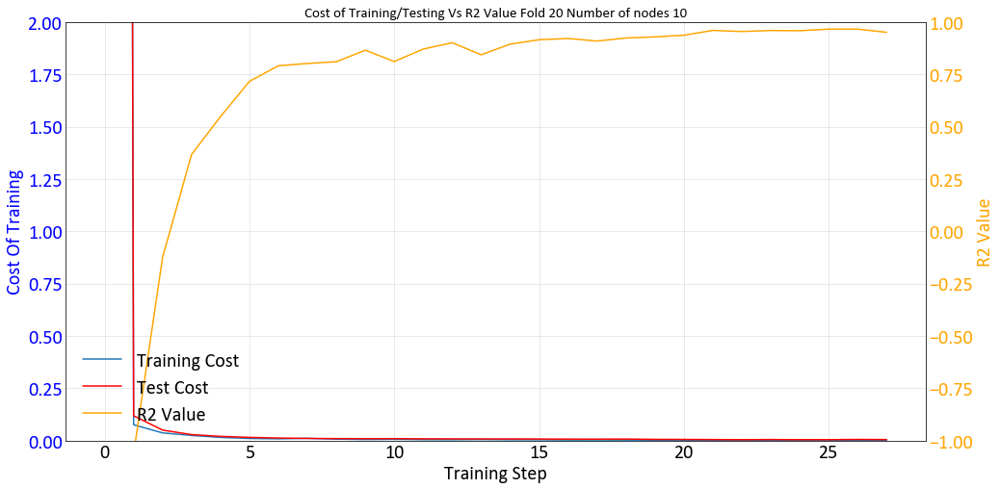

Working on Node 15 fold 20 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpfphnpqss', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022F0D469080>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 114.87405014038086
Cost_test : 111.42843
R^2:-2438.82373046875
Epoch: 100/5000 err = 0.16250860691070557
Cost_test : 0.24173635
R^2:-2.6773663759231567
Epoch: 200/5000 err = 0.04440554603934288
Cost_test : 0.09462806
R^2:-0.26787304878234863
Epoch: 300/5000 err = 0.029786626808345318
Cost_test : 0.052847866
R^2:0.020703673362731934
Epoch: 400/5000 err = 0.021982533857226372
Cost_test : 0.035166446
R^2:0.5368123650550842
Epoch: 500/5000 err = 0.017864405643194914
Cost_test : 0.028760703
R^2:0.44380220770835876
Epoch: 600/5000 err = 0.014057585038244724
Cost_test : 0.024696639
R^2:0.5582424402236938
Epoch: 700/5000 err = 0.01486470503732562
Cost_test : 0.022455847
R^2:0.5673869252204895
Epoch: 800/5000 err = 0.010964946588501334
Cost_test : 0.019330079
R^2:0.7410920560359955
Epoch: 900/5000 err = 0.01067136088386178
Cost_test : 0.017303431
R^2:0.6535857915878296
Epoch: 1000/5000 err = 0.008839634712785482
Cost_test : 0.01578706
R^2:0.7292675673961639
Epoch: 1100/5000 

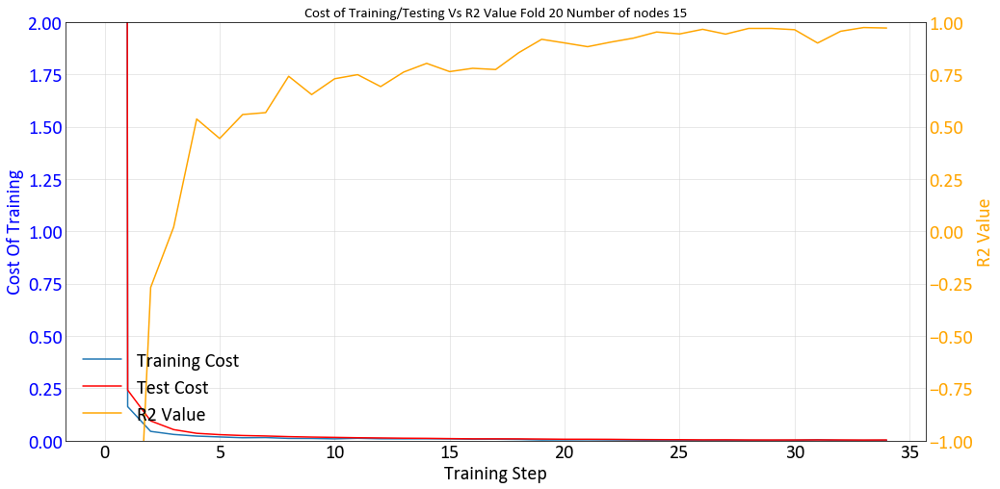

Working on Node 20 fold 20 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmpx5ao24_4', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E88746160>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 133.0002670288086
Cost_test : 128.64044
R^2:-3286.2930908203125
Epoch: 100/5000 err = 0.19750577956438065
Cost_test : 0.2812715
R^2:-3.061959743499756
Epoch: 200/5000 err = 0.08405358344316483
Cost_test : 0.11186448
R^2:-1.4519556760787964
Epoch: 300/5000 err = 0.05493307113647461
Cost_test : 0.063569404
R^2:-0.21895909309387207
Epoch: 400/5000 err = 0.057596368715167046
Cost_test : 0.04469785
R^2:-0.4720916748046875
Epoch: 500/5000 err = 0.023479381576180458
Cost_test : 0.03685273
R^2:0.48862019181251526
Epoch: 600/5000 err = 0.016793752554804087
Cost_test : 0.03166845
R^2:0.41399675607681274
Epoch: 700/5000 err = 0.015015857294201851
Cost_test : 0.02639919
R^2:0.6587278246879578
Epoch: 800/5000 err = 0.019128629937767982
Cost_test : 0.022595583
R^2:0.4207453429698944
Epoch: 900/5000 err = 0.01257560821250081
Cost_test : 0.019669766
R^2:0.7326328754425049
Epoch: 1000/5000 err = 0.009163907496258616
Cost_test : 0.017446427
R^2:0.698011040687561
Epoch: 1100/5000 err 

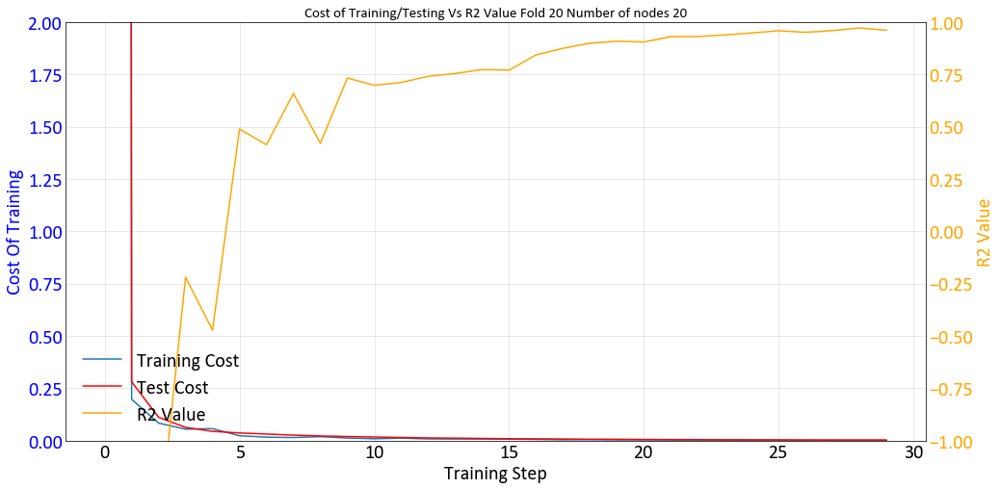

Working on Node 25 fold 20 
INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\Matt\\AppData\\Local\\Temp\\tmprew4rjq1', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x0000022E807E9828>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
IN

C:\ProgramData\Anaconda3\lib\site-packages\tensorflow\python\client\session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


Epoch: 0/5000 err = 195.7985076904297
Cost_test : 178.5207
R^2:-4765.24365234375
Epoch: 100/5000 err = 0.29251208156347275
Cost_test : 0.3208504
R^2:-7.039611339569092
Epoch: 200/5000 err = 0.1517590805888176
Cost_test : 0.14140582
R^2:-2.5784775018692017
Epoch: 300/5000 err = 0.04809592105448246
Cost_test : 0.08352604
R^2:-0.1461724042892456
Epoch: 400/5000 err = 0.035984501242637634
Cost_test : 0.05523199
R^2:-0.18174311518669128
Epoch: 500/5000 err = 0.028565559536218643
Cost_test : 0.043440487
R^2:0.1810677945613861
Epoch: 600/5000 err = 0.02142403833568096
Cost_test : 0.03547656
R^2:0.39997807145118713
Epoch: 700/5000 err = 0.0152872777543962
Cost_test : 0.030704414
R^2:0.6054978370666504
Epoch: 800/5000 err = 0.021314953453838825
Cost_test : 0.02596786
R^2:0.4674043357372284
Epoch: 900/5000 err = 0.01453284453600645
Cost_test : 0.022190502
R^2:0.6835334599018097
Epoch: 1000/5000 err = 0.01228497177362442
Cost_test : 0.018865941
R^2:0.7948991656303406
Epoch: 1100/5000 err = 0.0119

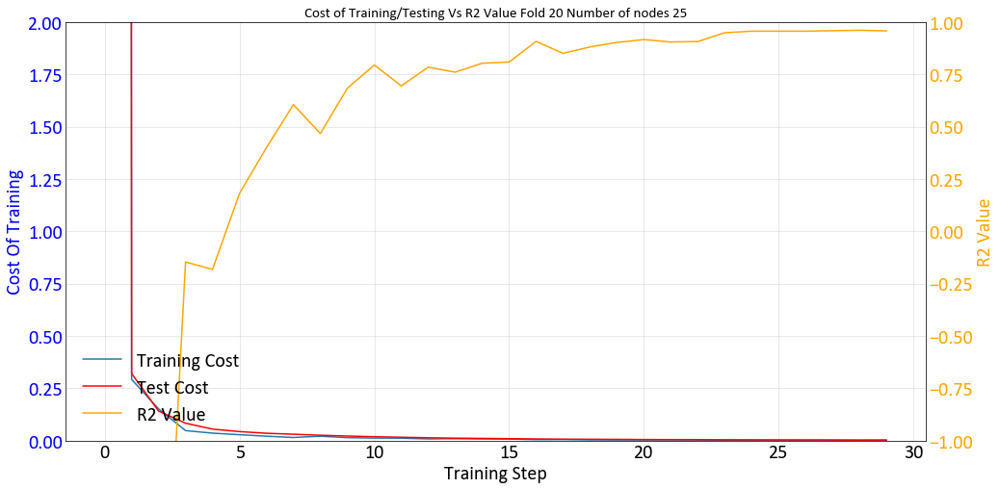

In [18]:
from sklearn.model_selection import KFold
fold_num= 0
for bs in range(1,21):
    fold_num += 1
    datasamplefl = gs.DataFile('dhs_{}.out'.format(fold_num),griddef=griddef)
    datasamplefl = pd.DataFrame(datasamplefl.data, dtype = np.float32)
    del datasamplefl['Drill ID']
    del datasamplefl['MD']
    del datasamplefl['Block ID']
    datasamplefl['Z'] = datasamplefl['Z']
    #Prediction Grid
    x,y,z = griddef.gridcoord()
    #DH Sample Data
    datatest = np.asarray(datasamplefl)
    min_val = np.min(datatest[:,3])
    max_val = np.max(datatest[:,3])
    print(min_val)
    print(max_val)
    datatest[:,3] = (datatest[:,3]-min_val)/(max_val-min_val)
    data_x = np.hstack((x.reshape(len(x),1),y.reshape(len(y),1),z.reshape(len(z),1)))/100
    columns = ['X','Y','Z','value']
    n_batch = 2
    RFB_type = 'Gaussian'
    for fold in range(1,2):
        print(fold_num)
        #print("TRAIN:", train_index, "TEST:", test_index)
        data_train, data_test,target_train, target_test = train_test_split(datatest[:,0:3]/100,datatest[:,3:4],test_size=0.20)
        gs.write_gslib(pd.DataFrame(np.hstack((data_train*100,target_train*(max_val-min_val)+min_val)),columns=columns), './data/data_train_{}.dat'.format(fold_num))
        gs.write_gslib(pd.DataFrame(np.hstack((data_test*100,target_test*(max_val-min_val)+min_val)),columns=columns), './data/data_test_{}.dat'.format(fold_num))
        row = 0
        NN = 'ERBFN' # RBFN or GRNN or 'EBFN'
        data_type = 'Continuous' # Continuous or Categorical
        test_nodes = [10,15,20,25]
        pred_all = np.zeros((len(test_nodes)*data_x.shape[0],target_train.shape[1]))
        pred_all_row = np.zeros((data_x.shape[0],target_train.shape[1],len(test_nodes)))
        info_matrix = np.zeros((len(test_nodes),8))
        for nodes in test_nodes:
            c_t = []
            c_test = []
            c_r2 = []
            start_time = time.time()
            print("Working on Node {} fold {} ".format(nodes,fold_num))
            k = nodes
            data_trainpd = pd.DataFrame(data_train)
            data = data_trainpd

            with tf.device('/device:CPU:0'):
                #clustering
                def input_fn():
                  return tf.train.limit_epochs(
                      tf.convert_to_tensor(data_train, dtype=tf.float32), num_epochs=1)

                kmeans = tf.contrib.factorization.KMeansClustering(
                    num_clusters=nodes, use_mini_batch=False)


                # train
                num_iterations = 10
                previous_centers = None
                for _ in range(num_iterations):
                  kmeans.train(input_fn)
                  cluster_centers = kmeans.cluster_centers()
                  #if previous_centers is not None:
                    #print('delta:', cluster_centers - previous_centers)
                  previous_centers = cluster_centers
                  #print('score:', kmeans.score(input_fn))
                #print('cluster centers:', cluster_centers)


            with tf.device('/device:GPU:0'):
                from tensorflow.python.framework import ops
                ops.reset_default_graph()


                RANDOM_SEED = 42
                tf.set_random_seed(RANDOM_SEED)

                N_INSTANCES = np.shape(data_train)[0]
                N_INPUT = data_train.shape[0]
                N_FEATURE = data_train.shape[1]
                N_CLASSES = target_train.shape[1]
                TRAIN_SIZE = int(N_INSTANCES)
                batch_size = int(np.shape(data_train)[0]/n_batch)
                training_epochs = 5000
                if nodes >= 2:
                    training_epochs = 5000
                if nodes >= 25:
                    training_epochs = 5000
                if nodes >= 100:
                    training_epochs = 5000
                if nodes >= 1000:
                    training_epochs = 5000
                learning_rate = 0.01
                epsilon = 0.001
                display_step = 100
                hidden_size = nodes

                target_ = np.zeros((N_INSTANCES, N_CLASSES))
                extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)

                x_data = tf.placeholder(shape=[None, N_FEATURE], dtype=tf.float32, name = 'Features')
                y_target = tf.placeholder(shape=[None, N_CLASSES], dtype=tf.float32, name = 'Known_Values')


                dist = np.zeros((k,k))
                for i in range (0,k):
                    for j in range (0,k):
                        dist[i:j] = distance.euclidean(cluster_centers[i], cluster_centers[j])
                        maxdist = dist.max()
                sigma = maxdist/np.sqrt(2*k)
                if nodes == 1 :
                    beta = 0.2
                else:        
                    beta = 1/math.pow(2*sigma,2)

                #EBFN
                if NN == 'ERBFN':
                    def rbf_network(input_layer, cluster_centers ,weights):

                        exp_list= []
                        with tf.name_scope('Cluster_Centers'):
                            yy = weights['cluster_centers']

                        with tf.name_scope('Input_Layer'):
                            input_layer

                        for i in range(nodes):
                            with tf.name_scope('Covariance_Matrix'):
                                vv = weights['cov_mat'][:,:,i]
                                symA = 0.5 * tf.math.add(vv , tf.transpose(vv))

                            with tf.name_scope('Mahalanobis_Distance'):
                                cc_i = yy[i]

                                diff = tf.subtract(input_layer, cc_i , name = 'subtract')

                                dt = tf.transpose(diff,name = 'Transpose')

                                M1 = tf.matmul(diff,symA,name = 'M1')

                                M2 = tf.matmul(M1,dt,name = 'M2')

                                sqrt = tf.math.sqrt(tf.math.abs(M2),name = 'sqrt')

                                diag = tf.linalg.tensor_diag_part(sqrt,name = 'diag') 

                            with tf.name_scope('Gaussian_Activation_Layer'):
                                gauss_f = tf.math.exp((-tf.math.pow((weights['beta'][:,i]*diag), 2)))
                                exp_list.append(gauss_f)

                        with tf.name_scope('Output_Layer'):        
                            layer2_act = tf.stack(exp_list)   
                            output = tf.add(tf.matmul(layer2_act, weights['output'],transpose_a=True,name = 'mult_layer2_by_weights'), bias['output'], 
                                        name = 'add_bias_to_output')     
                        return output


                weights = {
                    'h1': tf.Variable(tf.ones([N_FEATURE, N_FEATURE,nodes]), name = 'layer1_dims'),
                    'output': tf.Variable(tf.ones([nodes, N_CLASSES]), name = 'layer2_output_Weights'),
                    'cov_mat': tf.Variable(tf.ones(shape = [N_FEATURE,N_FEATURE,nodes]), name = 'cov'),
                    'beta' : tf.Variable(tf.constant(beta,shape = [1,nodes]) ,name = 'beta'),            
                    'cluster_centers' : tf.Variable(tf.constant(np.asarray(cluster_centers).reshape(nodes,N_FEATURE),
                                        shape = [nodes,N_FEATURE]), name = 'cluster_center')
                }

                bias = {
                    'output' : tf.Variable([0],name='output_bias',dtype=tf.float32)  
                }


                pred = rbf_network(x_data, cluster_centers ,weights)

                if data_type == 'Continuous':
                    with tf.name_scope('cost'):
                        cost = tf.reduce_mean(tf.square(pred - y_target))
                        #cost = tf.math.reduce_sum(tf.square(pred - y_target)) 
                        my_opt = tf.train.AdamOptimizer(learning_rate,beta1=0.5).minimize(cost)  
                        tf.summary.scalar('cost', cost)

                    with tf.name_scope('accuracy'):
                        total_error = tf.reduce_sum(tf.square(tf.subtract(y_target, tf.reduce_mean(y_target))))
                        unexplained_error = tf.reduce_sum(tf.square(tf.subtract(y_target, pred)))
                        accuracy = tf.subtract(1.00, tf.divide(unexplained_error, total_error))

                if data_type == 'Categorical':
                    with tf.name_scope('cost'):
                        if N_CLASSES == 1:
                            cost = tf.reduce_mean(tf.square(tf.round(pred) - y_target)) 
                        else:
                            cost = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels = y_target, logits = pred))
                        my_opt = tf.train.AdamOptimizer(learning_rate).minimize(cost) 
                        tf.summary.scalar('cost', cost)

                    with tf.name_scope('accuracy'):
                        correct_prediction = tf.equal(tf.round(pred), y_target)
                        accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))


    #             tf.summary.histogram("cov_mat", weights['cov_mat'])
    #             tf.summary.histogram("Weights_Output_Layer", weights['output'])
    #             tf.summary.histogram("Bias_Output_Layer", bias['output'])




                init = tf.global_variables_initializer()
                sess = tf.InteractiveSession(config=tf.ConfigProto(log_device_placement=True))
                merged = tf.summary.merge_all()
                saver = tf.train.Saver()
                writer = tf.summary.FileWriter('./test',sess.graph)
                sess.run(init)
                tol = 0.00001
                epoch, err, acc=0, 1, 0
                # Training loop
                #saver.restore(sess,'./spatial/test_dataset_{}.ckpt'.format(nodes))
                while epoch <= training_epochs and err >= tol and acc <= 0.98:

                    avg_cost = 0.
                    acc = 0.
                    total_batch = int(data_train.shape[0] / batch_size)
                    for i in range(total_batch):
                        randidx = np.random.randint(int(TRAIN_SIZE), size=batch_size)
                        batch_xs = data_train[randidx , :]
                        batch_ys = target_train[randidx , :]
                        sess.run(my_opt, feed_dict={x_data: batch_xs, y_target: batch_ys})
                        avg_cost += sess.run(cost, feed_dict={x_data: batch_xs, y_target: batch_ys})/total_batch
                        acc += sess.run(accuracy, feed_dict={x_data: batch_xs, y_target: batch_ys})/total_batch
                    err = avg_cost
                    if epoch % 100 == 0:
                        #summary = sess.run([merged],feed_dict={x_data: batch_xs, y_target: batch_ys})
                        #writer.add_summary(summary,epoch)
                        print("Epoch: {}/{} err = {}".format(epoch, training_epochs, avg_cost))
                        print('Cost_test :',sess.run(cost, feed_dict={x_data:data_test,y_target:target_test}))
                        c_t.append(avg_cost)
                        c_test.append(sess.run(cost, feed_dict={x_data:data_test,y_target:target_test}))
                        c_r2.append(acc)
                        if data_type == 'Categorical': 
                            print("Accuracy:{}".format(acc))
                        else:
                            print("R^2:{}".format(acc))    

                    epoch +=1

                print ("End of learning process")
                print ("Final epoch = {}/{} ".format(epoch, training_epochs))
                print ("Final error = {}".format(err) )
                print ("Final R^2 = {}".format(acc) )
                saver.save(sess,'./spatial/test_dataset_{}_{}.ckpt'.format(nodes,fold_num))
                w = np.vsplit(data_x,500)[0].shape[0]
                pred1 = np.zeros((data_x.shape[0],N_CLASSES))
                for i in range(0,500):
                    pred1[i*w:(1+i)*w,0:N_CLASSES] = (sess.run(pred, feed_dict={x_data:np.vsplit(data_x,500)[i]}))*(max_val-min_val)+min_val
                    pred_all[i*w+(row*data_x.shape[0]):(1+i)*w+(row*data_x.shape[0]),0:N_CLASSES] = pred1[i*w:(1+i)*w,0:N_CLASSES]
                    pred_all_row[i*w:(1+i)*w,0:N_CLASSES,row] = pred1[i*w:(1+i)*w,0:N_CLASSES]

                writer = tf.summary.FileWriter("sess_graph", sess.graph)
                saver.save(sess,'test/test_dataset_{}_{}.ckpt'.format(nodes,fold_num))
                sess.close() 

                gs.write_gslib(pd.DataFrame(pred1), './predictions/real_{}_{}.dat'.format(nodes,fold_num))

                info_matrix[row,0] = k
                info_matrix[row,1] = beta
                info_matrix[row,2] = 0 #r2_score(sgsimfl['value'],pred1)
                info_matrix[row,3] = np.mean(pred1)
                info_matrix[row,4] = np.var(pred1)
                info_matrix[row,5] = 0 #mean_squared_error(sgsimfl['value'],pred1)
                info_matrix[row,6] = err
                info_matrix[row,7] = (time.time() - start_time) 
                row +=1
                tf.InteractiveSession.close(sess)
            print(info_matrix)
            SMALL_SIZE = 15
            plt.rc('font', size=SMALL_SIZE)
            plt.rc('axes', titlesize=SMALL_SIZE)
            f, (ax1) = plt.subplots(1, 1,figsize=(16, 8))
            ax1.set_ylim([0,2])
            ax1.plot(range(len(c_t)), c_t, label ='Training Cost')
            ax1.plot(range(len(c_t)), c_test, color="red",label ='Test Cost')
            ax1.set_xlabel('Training Step')
            ax1.grid(True)
            ax1.set_title('Cost of Training/Testing Vs R2 Value Fold {} Number of nodes {}'.format(fold_num,nodes))
            ax1.set_ylabel('Cost Of Training', color='blue')
            ax1.tick_params(axis='y', labelcolor='blue')
            ax2 = ax1.twinx()
            ax2.plot(range(len(c_t)), c_r2,'-',color="orange",label ='R2 Value')
            ax2.set_ylim([-1,1])
            ax2.set_ylabel('R2 Value', color='orange')
            ax2.tick_params(axis='y', labelcolor='orange')
            lines, labels = ax1.get_legend_handles_labels()
            lines2, labels2 = ax2.get_legend_handles_labels()
            ax2.legend(lines + lines2, labels + labels2, loc=3)
            plt.savefig('C:/Users/Matt/Desktop/Thesis Work/Thesis/0-Figures/3-Chapter/Training_R2_ERBFN_{}_{}_{}.png'.format(nodes,fold_num,plt_extent))
            plt.show()


        ensemble = numpy.nanmean(pred_all_row, axis = 2)
        gs.write_gslib(pd.DataFrame(ensemble), './predictions/ensemble_{}.dat'.format(fold_num))
        gs.write_gslib(pd.DataFrame(pred_all), './predictions/all_real_{}.dat'.format(fold_num))

In [62]:
declusstr = """                  Parameters for DECLUS
                  *********************

START OF PARAMETERS:
{datafl}         -file with data
{xyzcol}   {varcol}               -  columns for X, Y, Z, and variable
-1.0e21     1.0e21          -  trimming limits
declus/declus_{fold}.sum                  -file for summary output
declus/declus_{fold}.out                  -file for output with data & weights
1.0   1.0                   -Y and Z cell anisotropy (Ysize=size*Yanis)
0                           -0=look for minimum declustered mean (1=max)
50  25  110.0               -number of cell sizes, min size, max size
100                           -number of origin offsets
"""
varcparstr = """                  Parameters for VARCALC
                  **********************
 
START OF PARAMETERS:
{datafl}                 -file with data
{xyzcol}                         -   columns for X, Y, Z coordinates
1   {varcol}                            -   number of variables,column numbers (position used for tail,head variables below)
-99.0    1.0e21                  -   trimming limits
3                                 -number of directions
135 15 200 0.0 22.5 200 0.0   -Dir 01: azm,azmtol,bandhorz,dip,dipt
 20  60  30                 -        number of lags,lag distanc
45 15 200 0.0 22.5 200 0.0   -Dir 01: azm,azmtol,bandhorz,dip,dipt
 20  60  30                 -        number of lags,lag distanc
0. 22.5 200 90.0 22.5 200 0.0   -Dir 03: azm,azmtol,bandhorz,dip,
 20  10  5                 -        number of lags,lag distanc
./vargs/varcalc_{fold}.out                       -file for experimental variogram points output.
0                                 -legacy output (0=no, 1=write out gamv2004 format)
1                                 -run checks for common errors
1                                 -standardize sills? (0=no, 1=yes)
1                                 -number of variogram types
1   1   1   ?                     -tail variable, head variable, variogram type (and cutoff/category), sill



NOTES ON VARIOGRAM CALCULATION:
1) By default, varcalc runs checks for common errors in parameter choices. This can be
   disabled if desired. 
2) Varcalc can standardize using a provided sill (such as a declustered variance).
   For example, if variable 1 has a declustered variance of 8.6, the traditional
   semivariogram could be standardized by setting the variogram type to:
      1  1  1  8.6
   Alternatively, varcalc can attempt to infer a sill for standardizing by setting
   the variogram type to:
      1  1  1  ?
   The calculated sills will be written to the console. 
3) Variogram types are the same as in GSLIB:
      1 = traditional semivariogram
      2 = traditional cross semivariogram
      3 = covariance   (-3 calculates variance (provided sill) -covariance)
      4 = correlogram  (-4 calculates 1-correlation)
      5 = general relative semivariogram
      6 = pairwise relative semivariogram
      7 = semivariogram of logarithms
      8 = semimadogram
      9 = indicator semivariogram - continuous  - requires a cutoff
      10= indicator semivariogram - categorical - requires a category
4) For indicator variograms, the variogram cutoff/categories are specified immediately after the variogram type
    1   1   9   1.0   ?               -tail variable, head variable, variogram type (and cutoff/category), sill
5) If desired, the program can write out the variogram points in the gamv2004 style
   for compatibility with older versions. Tilt was not supported in pre-varcalc experimental variogram
   programs so use carefully. 
"""
varmparstr = """                  Parameters for VARMODEL
                  ***********************
 
START OF PARAMETERS:
./vargs/varmodel_{fold}.out                 -file for modeled variogram points output
3                            -number of directions to model points along
    135.0  00.0  1000   0.5      -  azm, dip, npoints, point separation
    45.0  00.0  1000   0.5      -  azm, dip, npoints, point separation
    0.0  90.0  1000   0.5      -  azm, dip, npoints, point separation
1    0.001:0.01                   -nst, nugget effect
3    0.99    135   0.0   0.0    -it,cc,azm,dip,tilt (ang1,ang2,ang3)
        200     200     75    -a_hmax, a_hmin, a_vert (ranges)
1   100000                   -fit model (0=no, 1=yes), maximum iterations
1.0                          -  variogram sill (can be fit, but not recommended in most cases)
1                            -  number of experimental files to use
{varcalc}                  -    experimental output file 1
3   1  2  3                    -      # of variograms (<=0 for all), variogram #s
1   1   10                   -  # pairs weighting, inverse distance weighting, min pairs
0     10.0                   -  fix Hmax/Vert anis. (0=no, 1=yes)
0      1.0                   -  fix Hmin/Hmax anis. (0=no, 1=yes)
./vargs/varmodel_{fold}.var              -  file to save fit variogram model
"""
kt3dnparstr = """                 Parameters for KT3DN
                 ********************
START OF PARAMETERS:
{datafl}             -file with data
0  {xyzcol} {varcol}  0                 -  columns for DH,X,Y,Z,var,sec var
-998.0    1.0e21                 -  trimming limits
0                                -option: 0=grid, 1=cross, 2=jackknife
xvk.dat                          -file with jackknife data
1   2   0    3    0              -   columns for X,Y,Z,vr and sec var
kt3dn_dataspacing.out            -data spacing analysis output file (see note)
0    15.0                        -  number to search (0 for no dataspacing analysis, rec. 10 or 20) and composite length
0    100   0                     -debugging level: 0,3,5,10; max data for GSKV;output total weight of each data?(0=no,1=yes)
kt3dn.dbg-nkt3dn.sum             -file for debugging output (see note)
./predictions/kt3dn_{fold}.out                        -file for kriged output (see GSB note)
{griddef}
1    1      1                    -x,y and z block discretization
25    50    12    1               -min, max data for kriging,upper max for ASO,ASO incr
0      0                         -max per octant, max per drillhole (0-> not used)
500.0  500.0  250.0              -maximum search radii
135.0  45.0   0.0                 -angles for search ellipsoid
0                                -0=SK,1=OK,2=LVM(resid),3=LVM((1-w)*m(u))),4=colo,5=exdrift,6=ICCK
{mean} 0.6  0.8                  -  mean (if 0,4,5,6), corr. (if 4 or 6), var. reduction factor (if 4)
0 0 0 0 0 0 0 0 0                -drift: x,y,z,xx,yy,zz,xy,xz,zy
0                                -0, variable; 1, estimate trend
extdrift.out                     -gridded file with drift/mean
4                                -  column number in gridded file
keyout.out                       -gridded file with keyout (see note)
0    1                           -  column (0 if no keyout) and value to keep
{varg}
"""

In [63]:
varcalc = gs.Program('varcalc')
varmodel = gs.Program('varmodel')
kt3dn = gs.Program('kt3dn')
declus = gs.Program('declus') 
for fold in range(1,21):
    Traindat = gs.DataFile('dhs_{}.out'.format(fold),griddef=griddef)

    declus.run(declusstr.format(datafl = Traindat.flname,
                         xyzcol = Traindat.gscol(Traindat.xyz),
                         varcol = Traindat.gscol('value'),
                         fold = fold))
    
    declus_mean = np.min(np.asarray(gs.DataFile('declus/declus_{}.sum'.format(fold)).data['Declustered Mean'][gs.DataFile('declus/declus_{}.sum'.format(fold)).data['Cell Size']>0.0]))

    
    
    varcalc.run(varcparstr.format(datafl = Traindat.flname,
                             xyzcol = Traindat.gscol(Traindat.xyz),
                             varcol = Traindat.gscol('value'),
                             fold = fold))

    varcalcfl = gs.DataFile('./vargs/varcalc_{}.out'.format(fold))

   
    varmodel.run(varmparstr.format(varcalc = varcalcfl.flname,
                                 fold = fold))

    varmodelfl = gs.DataFile('./vargs/varmodel_{}.out'.format(fold))

    f = open("./vargs/varmodel_{}.var".format(fold), "r")
    varg = f.readlines()
    f.close()
    varg = ''.join(varg)
    
    kt3dn.run(kt3dnparstr.format(datafl = Traindat.flname,
                             xyzcol = Traindat.gscol(Traindat.xyz),
                             varcol = Traindat.gscol('value'),
                             griddef = griddef,
                             varg = varg,
                             fold = fold,
                             mean = declus_mean))

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = dhs_1.out                               
 columns =            2           3           4           7
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = declus/declus_1.sum                     
 output file = declus/declus_1.out                     
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           50       25.000000      110.000000
 offsets =          100


There are     2400 data with:
  mean value            =      0.27043
  minimum and maximum   =     -1.74240     2.76660
  size of data vol in X =    485.84000
  size of data vol in Y =    485.01999
  size of data vol in Z =    230.00000

  declustered mean      =      0.27043
  min and max weight    =      1.00000     1.00000
  equal weighting       =      1.00000


DECLUS Version: 3.000 Finished

Stop - Program terminated.
Calling:  ['varcalc', 'temp']

varcalc version:  1.400

  data file: dhs_1.out
  x,

  working on direction            2
  working on direction            3
Calling:  ['varmodel', 'temp']

varmodel version: 1.1.1

  output points file: ./vargs/varmodel_2.out
  number of directions to model points along:            3
  azm, dip, npoints, pointsep:    135.000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:    45.0000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:   0.000000000000000E+000   90.0000000000000     
        1000  0.500000000000000     
  nst =           1
 c0 constrained to  1.000000000000000E-003  1.000000000000000E-002
  fit model?            1      100000
  number of variogram files:            1
  variogram file: ./vargs/varcalc_2.out
  using variograms            1           2           3
  # pairs wt, inv dist wt, min pairs:            1           1          10
  fixhmaxvert,hmaxvert:            0   10.0000000000000     
  fixhminhmax,hmi

 Final objective value =   5.911543153565983E-003
  Modeling points

varmodel completed successfully

Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = dhs_3.out                               
  columns =            0           2           3           4           7
           0
  trimming limits =   -998.000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk.dat                                 
  columns =            1           2           0           3           0
  data spacing analysis output file = kt3dn_dataspacing.out                   
  debugging level =            0
  summary only file = kt3dn.sum                               
  debugging file = kt3dn.dbg                               
  GSLIB-style output file = ./predictions/kt3dn_3.out               
  nx, xmn, xsiz =           50   5.00000000000000        10.0000000000000     
  ny, ymn, ysiz =           50   5.00000000000000        10.0000000000000     
  nz

 Presorting the data along an arbitrary vector
 Data was presorted with angles:   12.5000000000000        12.5000000000000     
   12.5000000000000     
 Setting up rotation matrices for variogram and search
 Setting up super block search strategy
 
 Working on the kriging 
   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = dhs_5.out                               
 columns =            2           3           4           7
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = declus/declus_5.sum                     
 output file = declus/declus_5.out                     
 anisotropy =


  declustered mean      =      0.26601
  min and max weight    =      1.00000     1.00000
  equal weighting       =      1.00000


DECLUS Version: 3.000 Finished

Stop - Program terminated.
Calling:  ['varcalc', 'temp']

varcalc version:  1.400

  data file: dhs_6.out
  x,y,z columns:            2           3           4
  number of variables:            1
  Variable columns:            7
  tmin,tmax:   -99.0000000000000       1.000000000000000E+021
  number of directions:            3
  direction parameters:
 azm,azmtol,bandhorz   135.000000000000        15.0000000000000     
   200.000000000000     
 dip,diptol,bandvert  0.000000000000000E+000   22.5000000000000     
   200.000000000000     
 tilt  0.000000000000000E+000
 nlags,lagdist,lagtol          20   60.0000000000000     
   30.0000000000000     
 azm,azmtol,bandhorz   45.0000000000000        15.0000000000000     
   200.000000000000     
 dip,diptol,bandvert  0.000000000000000E+000   22.5000000000000     
   200.000000000000 

  working on direction            3
Calling:  ['varmodel', 'temp']

varmodel version: 1.1.1

  output points file: ./vargs/varmodel_7.out
  number of directions to model points along:            3
  azm, dip, npoints, pointsep:    135.000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:    45.0000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:   0.000000000000000E+000   90.0000000000000     
        1000  0.500000000000000     
  nst =           1
 c0 constrained to  1.000000000000000E-003  1.000000000000000E-002
  fit model?            1      100000
  number of variogram files:            1
  variogram file: ./vargs/varcalc_7.out
  using variograms            1           2           3
  # pairs wt, inv dist wt, min pairs:            1           1          10
  fixhmaxvert,hmaxvert:            0   10.0000000000000     
  fixhminhmax,hminhmax:            0   1.000000000000

 Working on the kriging 
   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = dhs_9.out                               
 columns =            2           3           4           7
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = declus/declus_9.sum                     
 output file = declus/declus_9.out                     
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           50       25.000000      110.000000
 offsets =          100


There are     1440 data with:
  mean value            =      0.25389
  minimum and maximum   =     -

Calling:  ['varmodel', 'temp']

varmodel version: 1.1.1

  output points file: ./vargs/varmodel_10.out
  number of directions to model points along:            3
  azm, dip, npoints, pointsep:    135.000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:    45.0000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:   0.000000000000000E+000   90.0000000000000     
        1000  0.500000000000000     
  nst =           1
 c0 constrained to  1.000000000000000E-003  1.000000000000000E-002
  fit model?            1      100000
  number of variogram files:            1
  variogram file: ./vargs/varcalc_10.out
  using variograms            1           2           3
  # pairs wt, inv dist wt, min pairs:            1           1          10
  fixhmaxvert,hmaxvert:            0   10.0000000000000     
  fixhminhmax,hminhmax:            0   1.00000000000000     
  variogram model output f

 
 Working on the kriging 
   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = dhs_12.out                              
 columns =            2           3           4           7
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = declus/declus_12.sum                    
 output file = declus/declus_12.out                    
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           50       25.000000      110.000000
 offsets =          100


There are     1080 data with:
  mean value            =      0.22524
  minimum and maximum   =    

 Final objective value =   8.013100584614494E-003
  Modeling points

varmodel completed successfully

Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = dhs_13.out                              
  columns =            0           2           3           4           7
           0
  trimming limits =   -998.000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk.dat                                 
  columns =            1           2           0           3           0
  data spacing analysis output file = kt3dn_dataspacing.out                   
  debugging level =            0
  summary only file = kt3dn.sum                               
  debugging file = kt3dn.dbg                               
  GSLIB-style output file = ./predictions/kt3dn_13.out              
  nx, xmn, xsiz =           50   5.00000000000000        10.0000000000000     
  ny, ymn, ysiz =           50   5.00000000000000        10.0000000000000     
  nz

 
 Working on the kriging 
   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = dhs_15.out                              
 columns =            2           3           4           7
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = declus/declus_15.sum                    
 output file = declus/declus_15.out                    
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           50       25.000000      110.000000
 offsets =          100


There are      720 data with:
  mean value            =      0.14299
  minimum and maximum   =    

Calling:  ['varmodel', 'temp']

varmodel version: 1.1.1

  output points file: ./vargs/varmodel_16.out
  number of directions to model points along:            3
  azm, dip, npoints, pointsep:    135.000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:    45.0000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:   0.000000000000000E+000   90.0000000000000     
        1000  0.500000000000000     
  nst =           1
 c0 constrained to  1.000000000000000E-003  1.000000000000000E-002
  fit model?            1      100000
  number of variogram files:            1
  variogram file: ./vargs/varcalc_16.out
  using variograms            1           2           3
  # pairs wt, inv dist wt, min pairs:            1           1          10
  fixhmaxvert,hmaxvert:            0   10.0000000000000     
  fixhminhmax,hminhmax:            0   1.00000000000000     
  variogram model output f


 KT3DN Version: 7.4.7

  data file = dhs_17.out                              
  columns =            0           2           3           4           7
           0
  trimming limits =   -998.000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk.dat                                 
  columns =            1           2           0           3           0
  data spacing analysis output file = kt3dn_dataspacing.out                   
  debugging level =            0
  summary only file = kt3dn.sum                               
  debugging file = kt3dn.dbg                               
  GSLIB-style output file = ./predictions/kt3dn_17.out              
  nx, xmn, xsiz =           50   5.00000000000000        10.0000000000000     
  ny, ymn, ysiz =           50   5.00000000000000        10.0000000000000     
  nz, zmn, zsiz =           25   5.00000000000000        10.0000000000000     
  block discretization:           1           1        

   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = dhs_19.out                              
 columns =            2           3           4           7
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = declus/declus_19.sum                    
 output file = declus/declus_19.out                    
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           50       25.000000      110.000000
 offsets =          100


There are      240 data with:
  mean value            =      0.16479
  minimum and maximum   =     -1.00860     1.85520
  siz

 Final objective value =   5.960560978217790E-003
  Modeling points

varmodel completed successfully

Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = dhs_20.out                              
  columns =            0           2           3           4           7
           0
  trimming limits =   -998.000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk.dat                                 
  columns =            1           2           0           3           0
  data spacing analysis output file = kt3dn_dataspacing.out                   
  debugging level =            0
  summary only file = kt3dn.sum                               
  debugging file = kt3dn.dbg                               
  GSLIB-style output file = ./predictions/kt3dn_20.out              
  nx, xmn, xsiz =           50   5.00000000000000        10.0000000000000     
  ny, ymn, ysiz =           50   5.00000000000000        10.0000000000000     
  nz

In [6]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
import warnings
warnings.simplefilter('ignore')
from scipy.ndimage import gaussian_filter

In [7]:
declusstr = """                  Parameters for DECLUS
                  *********************

START OF PARAMETERS:
{datafl}         -file with data
{xyzcol}   {varcol}               -  columns for X, Y, Z, and variable
-1.0e21     1.0e21          -  trimming limits
./declus/declus_{fold}.sum                  -file for summary output
./declus/declus_{fold}.out                  -file for output with data & weights
1.0   1.0                   -Y and Z cell anisotropy (Ysize=size*Yanis)
0                           -0=look for minimum declustered mean (1=max)
99  10.0  110.0               -number of cell sizes, min size, max size
100                           -number of origin offsets
"""

varcparstr = """                  Parameters for VARCALC
                  **********************
 
START OF PARAMETERS:
{datafl}                 -file with data
{xyzcol}                         -   columns for X, Y, Z coordinates
1   {varcol}                            -   number of variables,column numbers (position used for tail,head variables below)
-99.0    1.0e21                  -   trimming limits
3                                 -number of directions
135 15 200 0.0 22.5 200 0.0   -Dir 01: azm,azmtol,bandhorz,dip,dipt
 20  60  30                 -        number of lags,lag distanc
45 15 200 0.0 22.5 200 0.0   -Dir 01: azm,azmtol,bandhorz,dip,dipt
 20  60  30                 -        number of lags,lag distanc
0. 22.5 200 90.0 22.5 200 0.0   -Dir 03: azm,azmtol,bandhorz,dip,
 20  10  5                 -        number of lags,lag distanc
./vargs/varcalc_{fold}.out                       -file for experimental variogram points output.
0                                 -legacy output (0=no, 1=write out gamv2004 format)
1                                 -run checks for common errors
1                                 -standardize sills? (0=no, 1=yes)
1                                 -number of variogram types
1   1   1   ?                     -tail variable, head variable, variogram type (and cutoff/category), sill
"""
varmparstr = """                  Parameters for VARMODEL
                  ***********************
 
START OF PARAMETERS:
./vargs/varmodel_{fold}.out                 -file for modeled variogram points output
3                            -number of directions to model points along
    135.0  00.0  1000   0.5      -  azm, dip, npoints, point separation
    45.0  00.0  1000   0.5      -  azm, dip, npoints, point separation
    0.0  90.0  1000   0.5      -  azm, dip, npoints, point separation
1    0.001:0.01                   -nst, nugget effect
3    0.99    135   0.0   0.0    -it,cc,azm,dip,tilt (ang1,ang2,ang3)
        200     200     75    -a_hmax, a_hmin, a_vert (ranges)
0   100000                   -fit model (0=no, 1=yes), maximum iterations
1.0                          -  variogram sill (can be fit, but not recommended in most cases)
1                            -  number of experimental files to use
{varcalc}                  -    experimental output file 1
0                    -      # of variograms (<=0 for all), variogram #s
1   1   10                   -  # pairs weighting, inverse distance weighting, min pairs
0     10.0                   -  fix Hmax/Vert anis. (0=no, 1=yes)
0      1.0                   -  fix Hmin/Hmax anis. (0=no, 1=yes)
./vargs/varmodel_{fold}.var              -  file to save fit variogram model
"""
kt3dnparstr = """                 Parameters for KT3DN
                 ********************
START OF PARAMETERS:
{datafl}              -file with data
0  {xyzcol}  {varcol}  {seisnscol}                 -  columns for DH,X,Y,Z,var,sec var
-99    1.0e21                 -  trimming limits
0                                -option: 0=grid, 1=cross, 2=jackknife
xvk.dat                          -file with jackknife data
1   2   0    3    0              -   columns for X,Y,Z,vr and sec var
kt3dn_dataspacing.out            -data spacing analysis output file (see note)
0    15.0                        -  number to search (0 for no dataspacing analysis, rec. 10 or 20) and composite length
0    100   0                     -debugging level: 0,3,5,10; max data for GSKV;output total weight of each data?(0=no,1=yes)
kt3dn.dbg-nkt3dn.sum             -file for debugging output (see note)
./ML+ICCK/kt3dn_{fold}.out                        -file for kriged output (see GSB note)
{griddef}
1    1      1                    -x,y and z block discretization
10    50    12    1               -min, max data for kriging,upper max for ASO,ASO incr
0      0                         -max per octant, max per drillhole (0-> not used)
500  500  500              -maximum search radii
 135   45   0.0                 -angles for search ellipsoid
7                                -0=SK,1=OK,2=LVM(resid),3=LVM((1-w)*m(u))),4=colo,5=exdrift,6=ICCK
0  {corr}  0.8                  -  mean (if 0,4,5,6), corr. (if 4 or 6), var. reduction factor (if 4)
0 0 0 0 0 0 0 0 0                -drift: x,y,z,xx,yy,zz,xy,xz,zy
0                                -0, variable; 1, estimate trend
{seisfl}                     -gridded file with drift/mean
{seiscol}                                -  column number in gridded file
keyout.out                       -gridded file with keyout (see note)
0    1                           -  column (0 if no keyout) and value to keep
{varg}
"""

In [8]:
varcalc = gs.Program('varcalc')
varmodel = gs.Program('varmodel')
kt3dn = gs.Program('kt3dn')
declus = gs.Program('declus')   

griddef2 = gs.GridDef(gridfl='griddef2.txt')

for fold in range(1,21):
    
    sesi_data = gs.DataFile('predictions\ensemble_{}.dat'.format(fold))
    
    sesi_data = gaussian_filter((sesi_data.data['0']),sigma = 0)
    
    gs.write_gslib(pd.DataFrame(sesi_data),'predictions\smooth_ensemble_{}.dat'.format(fold))
    
    sesi_data = gs.DataFile('predictions\smooth_ensemble_{}.dat'.format(fold))
    
    Traindat = gs.DataFile('./data/data_train_{}.dat'.format(fold))
    
    declus.run(declusstr.format(datafl = Traindat.flname,
                         xyzcol = Traindat.gscol(Traindat.xyz),
                         varcol = Traindat.gscol('value'),
                         fold = fold))
    
    Testdat = gs.DataFile('declus/declus_{}.out'.format(fold),griddef=griddef)
    
    idx,ingrid = griddef.coord_to_index1d(x=Testdat.data['X'],y=Testdat.data['Y'],z=Testdat.data['Z'])
    
    Testdat['sesi_data'] = sesi_data.data['0'][idx].values
    
    gs.write_gslib(Testdat,'./data/data_test_NS_{}.dat'.format(fold))
    
    Testdat = gs.DataFile('./data/data_test_NS_{}.dat'.format(fold))   
    
    
    idx,ingrid = griddef.coord_to_index1d(x=Traindat.data['X'],y=Traindat.data['Y'],z=Traindat.data['Z']) 
    
    Traindat['sesi_data'] = sesi_data.data['0'][idx].values
    
    gs.write_gslib(Traindat,'./data/data_train_NS_{}.dat'.format(fold))
    
    Traindat = gs.DataFile('./data/data_train_NS_{}.dat'.format(fold))
    

    
#     Traindat = gs.DataFile('declus.out',griddef=griddef)  
        
#     for i in range(len(Traindat['value'])):
#         if Traindat['sesi_data'].isna()[i] == True:
#             Traindat['sesi_data'][i] = Traindat['value'][i]
            
    gs.write_gslib(Traindat,'./nscore/runfl_{}.out'.format(fold))      

    Traindat = gs.DataFile('nscore/runfl_{}.out'.format(fold),griddef=griddef)
    
    varcalc.run(varcparstr.format(datafl = Traindat.flname,
                             xyzcol = Traindat.gscol(Traindat.xyz),
                             varcol = Traindat.gscol('value'),
                             fold = fold))

    varcalcfl = gs.DataFile('./vargs/varcalc_{}.out'.format(fold))

   
    varmodel.run(varmparstr.format(varcalc = varcalcfl.flname,
                                 fold = fold))


    varmodelfl = gs.DataFile('./vargs/varmodel_{}.out'.format(fold))

    f = open('./vargs/varmodel_{}.var'.format(fold), "r")
    varg = f.readlines()
    f.close()
    varg = ''.join(varg)
    
    declus_mean = np.min(np.asarray(gs.DataFile('./declus/declus_{}.sum'.format(fold)).data['Declustered Mean'][gs.DataFile('declus/declus_{}.sum'.format(fold)).data['Cell Size']>0.0]))
    
    kt3dn.run(kt3dnparstr.format(datafl = Traindat.flname,
                                 seisfl = sesi_data.flname,
                             xyzcol = Traindat.gscol(Traindat.xyz),
                             varcol = Traindat.gscol('value'),
                             seiscol = sesi_data.gscol('0'),
                             griddef = griddef2,
                             varg = varg,
                             mean = declus_mean,
                             seisnscol = Traindat.gscol('sesi_data'),
                             corr = np.corrcoef(Traindat.data.dropna()['value'],Traindat.data.dropna()['sesi_data'])[0,1],
                             fold = fold))
    
    
    kt3dnfl = gs.DataFile('./ML+ICCK/kt3dn_{}.out'.format(fold))
    
    kt3dnfl.data['Back Transform'] = kt3dnfl.data['Estimate']
    
    gs.write_gslib(kt3dnfl,'./backtr/backtr_UDDH_{}.out'.format(fold))
    

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = ./data/data_train_1.dat                 
 columns =            1           2           3           4
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = ./declus/declus_1.sum                   
 output file = ./declus/declus_1.out                   
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           99       10.000000      110.000000
 offsets =          100


There are     1920 data with:
  mean value            =      0.26476
  minimum and maximum   =     -1.70590     2.55790
  size of data vol in X =    485.84003
  size of data vol in Y =    485.01999
  size of data vol in Z =    230.00000

  declustered mean      =      0.26476
  min and max weight    =      1.00000     1.00000
  equal weighting       =      1.00000


DECLUS Version: 3.000 Finished

Stop - Program terminated.
Calling:  ['varcalc', 'temp']

varcalc version:  1.400

  data file: nscore/runfl_1

  working on direction            3
Calling:  ['varmodel', 'temp']

varmodel version: 1.1.1

  output points file: ./vargs/varmodel_2.out
  number of directions to model points along:            3
  azm, dip, npoints, pointsep:    135.000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:    45.0000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:   0.000000000000000E+000   90.0000000000000     
        1000  0.500000000000000     
  nst =           1
 c0 constrained to  1.000000000000000E-003  1.000000000000000E-002
  fit model?            0      100000
 ERROR: unknown parameters supplied but told not to fit model           1
Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = nscore/runfl_2.out                      
  columns =            0           1           2           3           4
           5
  trimming limits =   -99.0000000000000       1.000000000000

   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = ./data/data_train_4.dat                 
 columns =            1           2           3           4
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = ./declus/declus_4.sum                   
 output file = ./declus/declus_4.out                   
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           99       10.000000      110.000000
 offsets =          100


There are     1632 data with:
  mean value            =      0.29193
  minimum and maximum   =     -1.40920     2.76660
  siz

varmodel version: 1.1.1

  output points file: ./vargs/varmodel_5.out
  number of directions to model points along:            3
  azm, dip, npoints, pointsep:    135.000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:    45.0000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:   0.000000000000000E+000   90.0000000000000     
        1000  0.500000000000000     
  nst =           1
 c0 constrained to  1.000000000000000E-003  1.000000000000000E-002
  fit model?            0      100000
 ERROR: unknown parameters supplied but told not to fit model           1
Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = nscore/runfl_5.out                      
  columns =            0           1           2           3           4
           5
  trimming limits =   -99.0000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk

  Y mean and standard deviation   0.377375493136000       0.738623525639175     
 Presorting the data along an arbitrary vector
 Data was presorted with angles:   12.5000000000000        12.5000000000000     
   12.5000000000000     
 Setting up rotation matrices for variogram and search
 Setting up super block search strategy
 
 Working on the kriging 
   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = ./data/data_train_7.dat                 
 columns =            1           2           3           4
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = ./declus/declus_7.sum        


varcalc version:  1.400

  data file: nscore/runfl_8.out
  x,y,z columns:            1           2           3
  number of variables:            1
  Variable columns:            4
  tmin,tmax:   -99.0000000000000       1.000000000000000E+021
  number of directions:            3
  direction parameters:
 azm,azmtol,bandhorz   135.000000000000        15.0000000000000     
   200.000000000000     
 dip,diptol,bandvert  0.000000000000000E+000   22.5000000000000     
   200.000000000000     
 tilt  0.000000000000000E+000
 nlags,lagdist,lagtol          20   60.0000000000000     
   30.0000000000000     
 azm,azmtol,bandhorz   45.0000000000000        15.0000000000000     
   200.000000000000     
 dip,diptol,bandvert  0.000000000000000E+000   22.5000000000000     
   200.000000000000     
 tilt  0.000000000000000E+000
 nlags,lagdist,lagtol          20   60.0000000000000     
   30.0000000000000     
 azm,azmtol,bandhorz  0.000000000000000E+000   22.5000000000000     
   200.000000000000     


varmodel version: 1.1.1

  output points file: ./vargs/varmodel_9.out
  number of directions to model points along:            3
  azm, dip, npoints, pointsep:    135.000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:    45.0000000000000       0.000000000000000E+000
        1000  0.500000000000000     
  azm, dip, npoints, pointsep:   0.000000000000000E+000   90.0000000000000     
        1000  0.500000000000000     
  nst =           1
 c0 constrained to  1.000000000000000E-003  1.000000000000000E-002
  fit model?            0      100000
 ERROR: unknown parameters supplied but told not to fit model           1
Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = nscore/runfl_9.out                      
  columns =            0           1           2           3           4
           5
  trimming limits =   -99.0000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk

   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = ./data/data_train_11.dat                
 columns =            1           2           3           4
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = ./declus/declus_11.sum                  
 output file = ./declus/declus_11.out                  
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           99       10.000000      110.000000
 offsets =          100


There are      960 data with:
  mean value            =      0.22989
  minimum and maximum   =     -1.74240     2.45040
  siz

Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = nscore/runfl_12.out                     
  columns =            0           1           2           3           4
           5
  trimming limits =   -99.0000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk.dat                                 
  columns =            1           2           0           3           0
  data spacing analysis output file = kt3dn_dataspacing.out                   
  debugging level =            0
  summary only file = kt3dn.sum                               
  debugging file = kt3dn.dbg                               
  GSLIB-style output file = ./ML+ICCK/kt3dn_12.out                  
  nx, xmn, xsiz =           50   5.01000000000000        10.0000000000000     
  ny, ymn, ysiz =           50   5.00000000000000        10.0000000000000     
  nz, zmn, zsiz =           25   5.00000000000000        10.0000000000000     
  block discretization:    

   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = ./data/data_train_14.dat                
 columns =            1           2           3           4
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = ./declus/declus_14.sum                  
 output file = ./declus/declus_14.out                  
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           99       10.000000      110.000000
 offsets =          100


There are      672 data with:
  mean value            =      0.18935
  minimum and maximum   =     -1.74240     2.45040
  siz

Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = nscore/runfl_15.out                     
  columns =            0           1           2           3           4
           5
  trimming limits =   -99.0000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk.dat                                 
  columns =            1           2           0           3           0
  data spacing analysis output file = kt3dn_dataspacing.out                   
  debugging level =            0
  summary only file = kt3dn.sum                               
  debugging file = kt3dn.dbg                               
  GSLIB-style output file = ./ML+ICCK/kt3dn_15.out                  
  nx, xmn, xsiz =           50   5.01000000000000        10.0000000000000     
  ny, ymn, ysiz =           50   5.00000000000000        10.0000000000000     
  nz, zmn, zsiz =           25   5.00000000000000        10.0000000000000     
  block discretization:    

   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = ./data/data_train_17.dat                
 columns =            1           2           3           4
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = ./declus/declus_17.sum                  
 output file = ./declus/declus_17.out                  
 anisotropy =         1.000000        1.000000
 minmax flag =            0
 ncell min max =           99       10.000000      110.000000
 offsets =          100


There are      384 data with:
  mean value            =      0.13364
  minimum and maximum   =     -1.74240     1.90210
  siz

Calling:  ['kt3dn', 'temp']

 KT3DN Version: 7.4.7

  data file = nscore/runfl_18.out                     
  columns =            0           1           2           3           4
           5
  trimming limits =   -99.0000000000000       1.000000000000000E+021
  kriging option =            0
  jackknife data file = xvk.dat                                 
  columns =            1           2           0           3           0
  data spacing analysis output file = kt3dn_dataspacing.out                   
  debugging level =            0
  summary only file = kt3dn.sum                               
  debugging file = kt3dn.dbg                               
  GSLIB-style output file = ./ML+ICCK/kt3dn_18.out                  
  nx, xmn, xsiz =           50   5.01000000000000        10.0000000000000     
  ny, ymn, ysiz =           50   5.00000000000000        10.0000000000000     
  nz, zmn, zsiz =           25   5.00000000000000        10.0000000000000     
  block discretization:    

 Presorting the data along an arbitrary vector
 Data was presorted with angles:   12.5000000000000        12.5000000000000     
   12.5000000000000     
 Setting up rotation matrices for variogram and search
 Setting up super block search strategy
 
 Working on the kriging 
   currently on estimate      6250
   currently on estimate     12500
   currently on estimate     18750
   currently on estimate     25000
   currently on estimate     31250
   currently on estimate     37500
   currently on estimate     43750
   currently on estimate     50000
   currently on estimate     56250
   currently on estimate     62500

 KT3DN Version:    7.4.7 Finished

Calling:  ['declus', 'temp']

DECLUS Version: 3.000

 data file = ./data/data_train_20.dat                
 columns =            1           2           3           4
 tmin,tmax =    -1.000000E+21    1.000000E+21
 summary file = ./declus/declus_20.sum                  
 output file = ./declus/declus_20.out                  
 anisotropy =

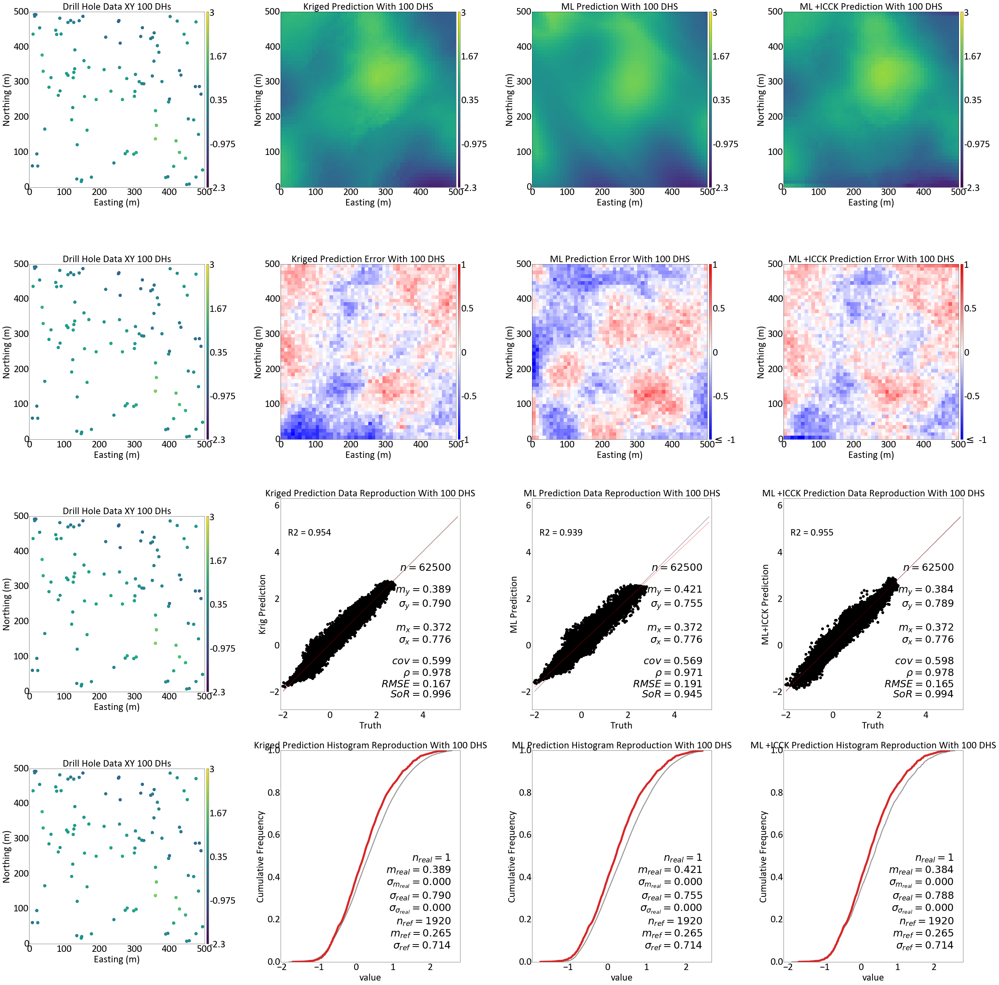

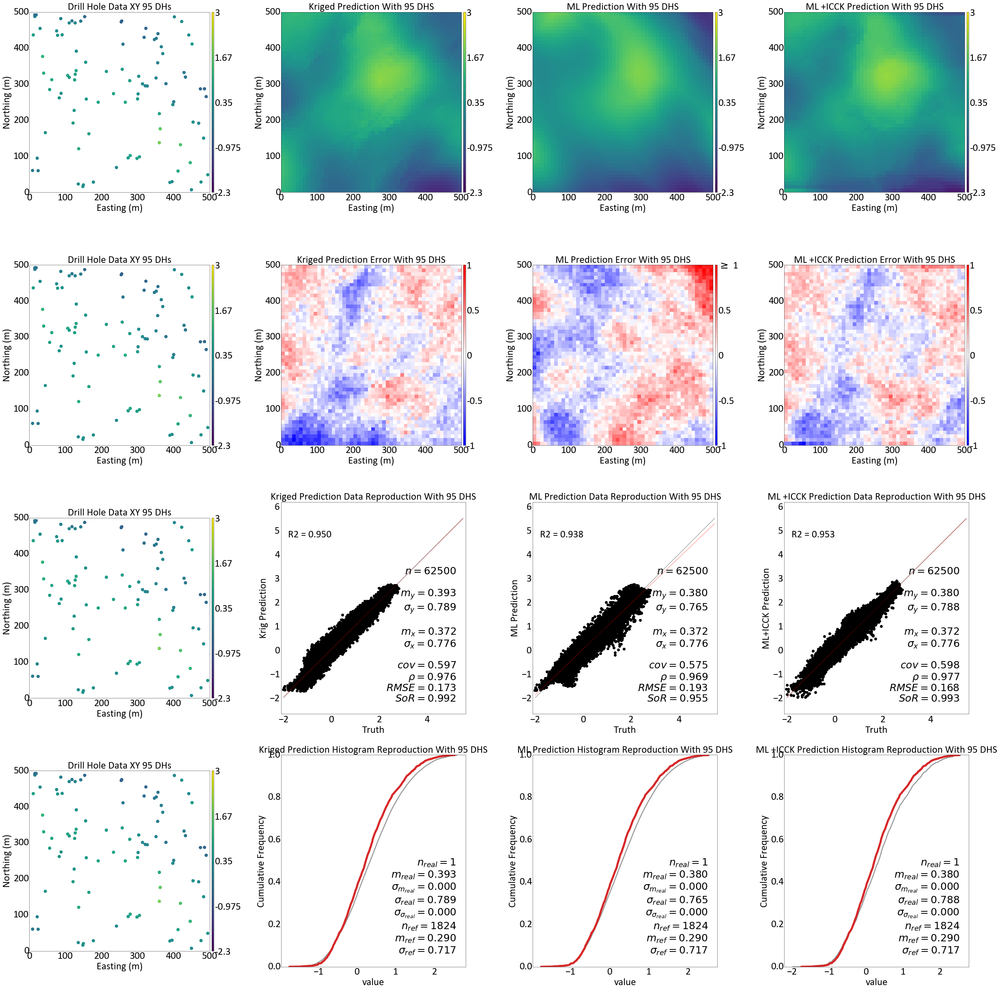

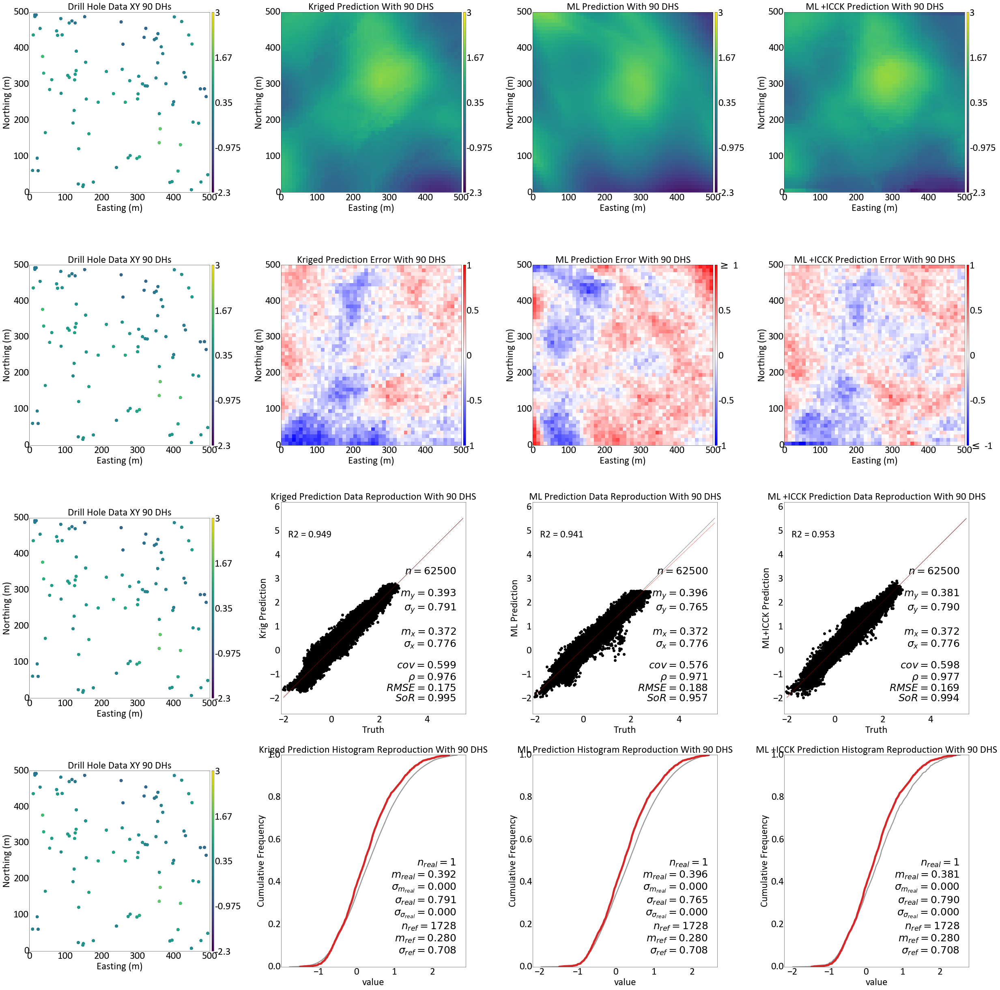

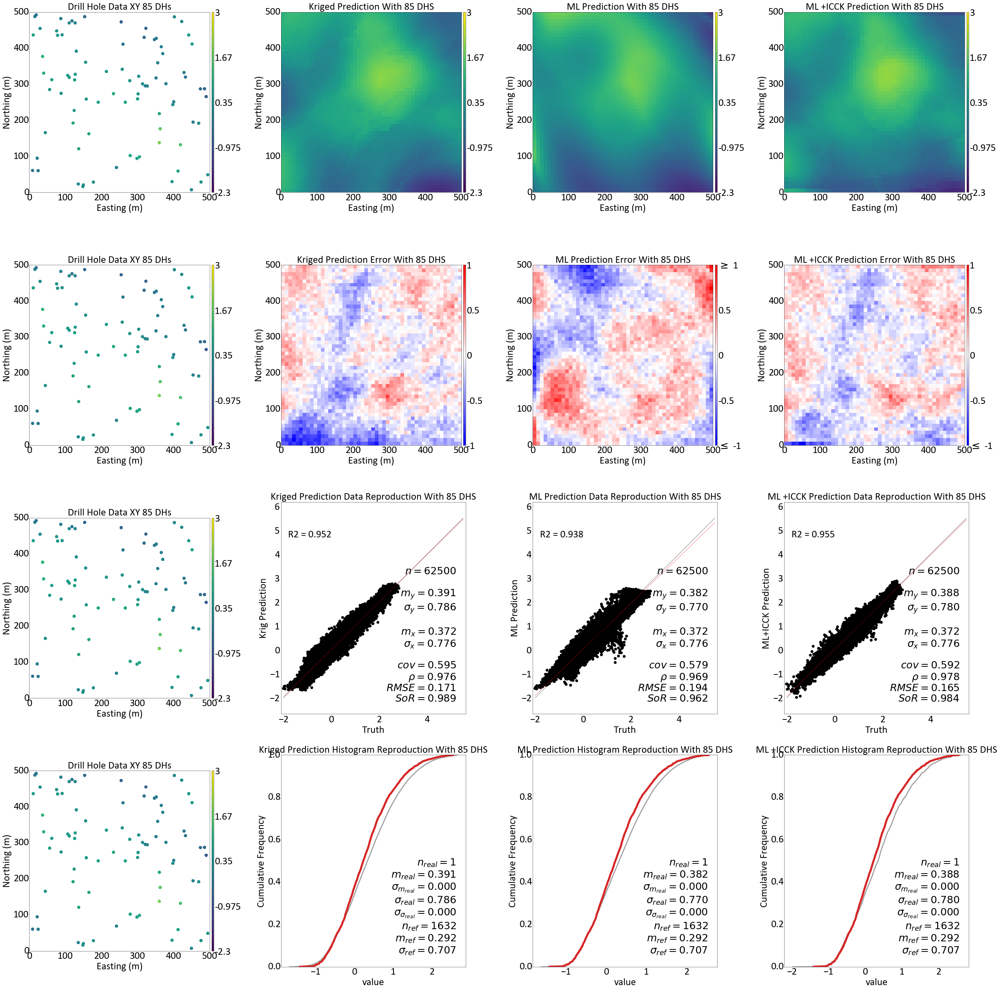

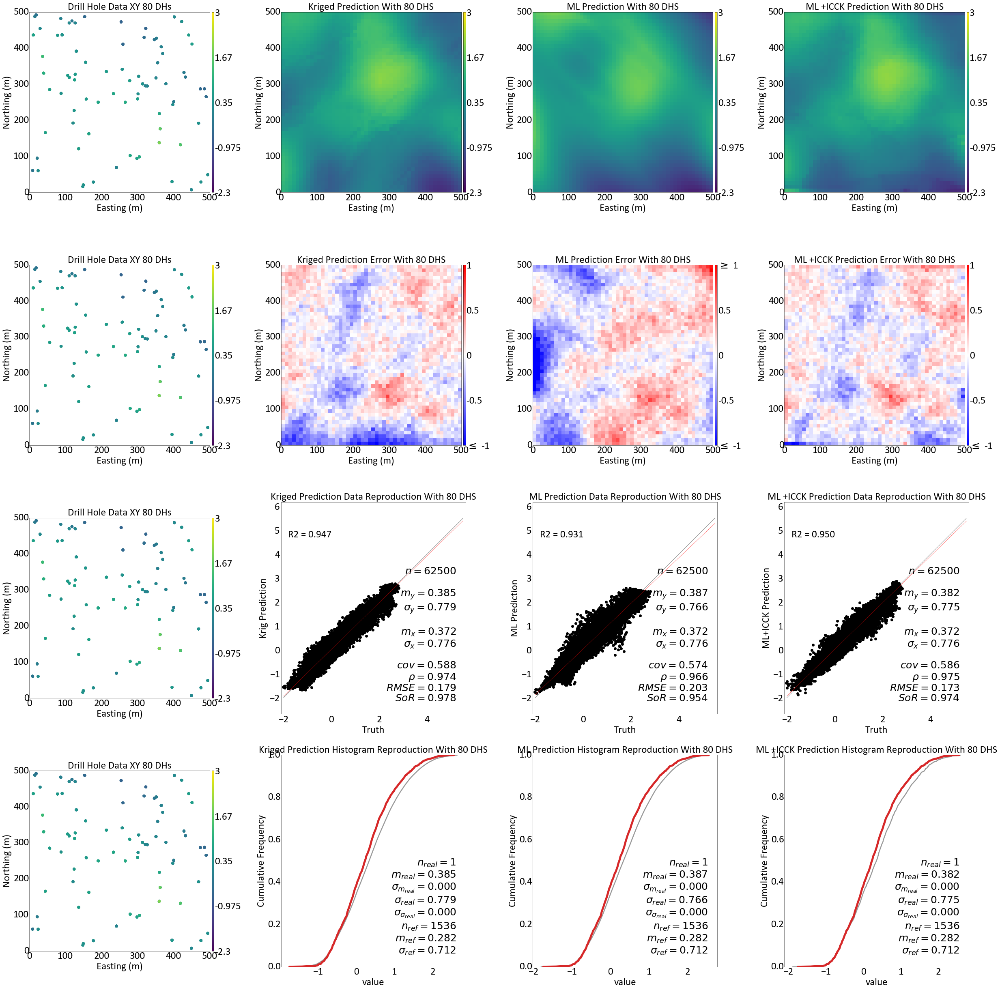

...

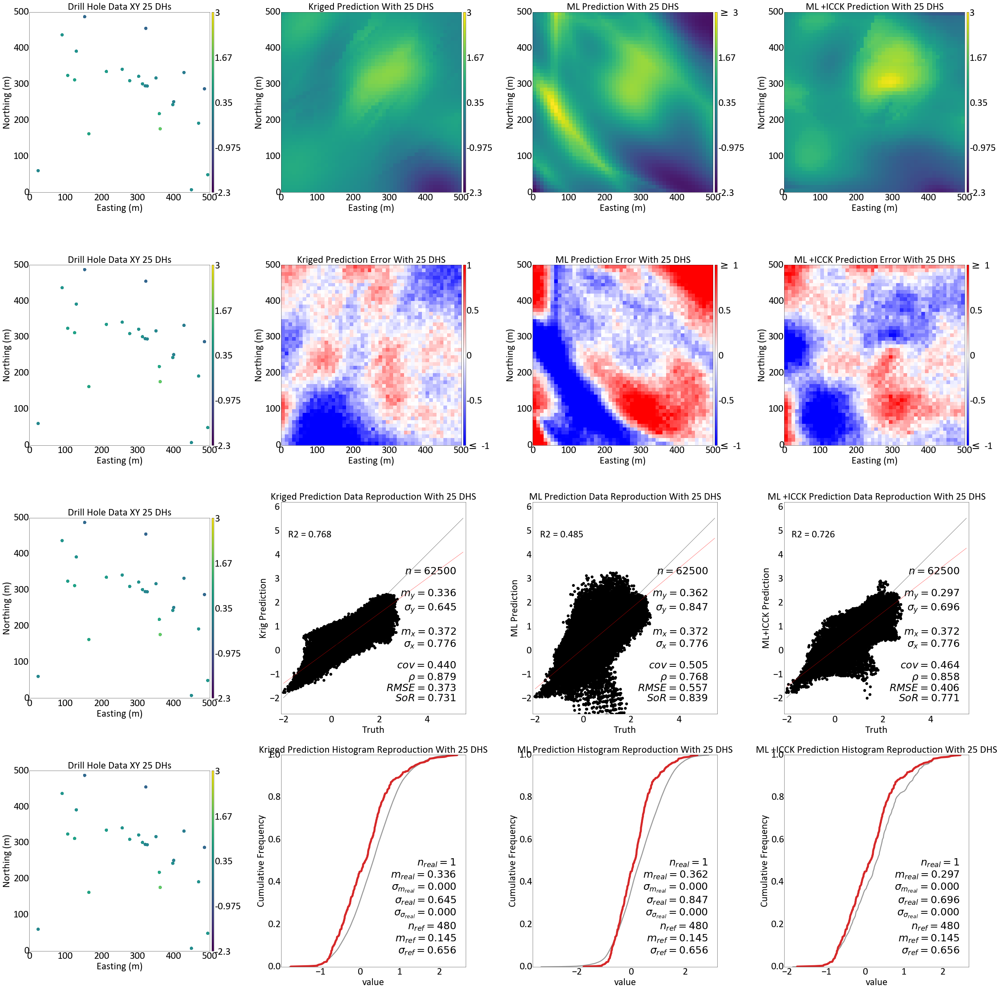

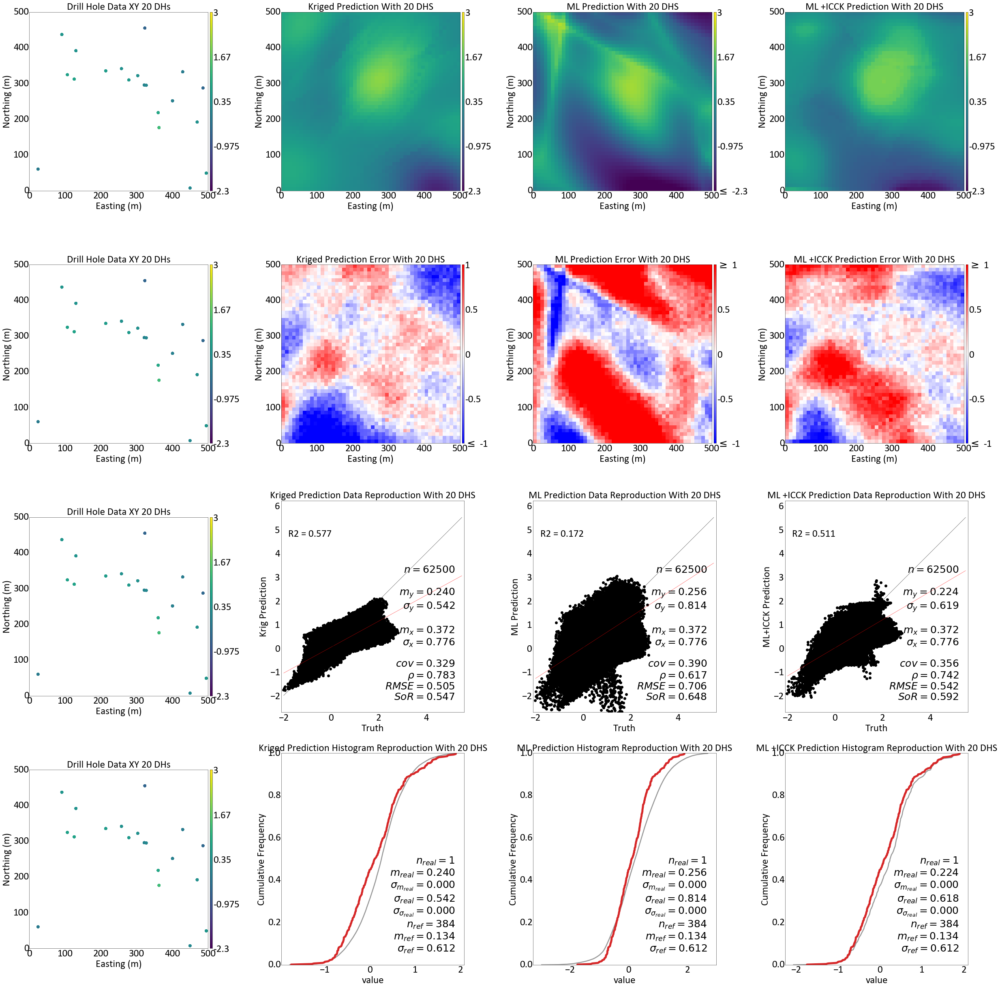

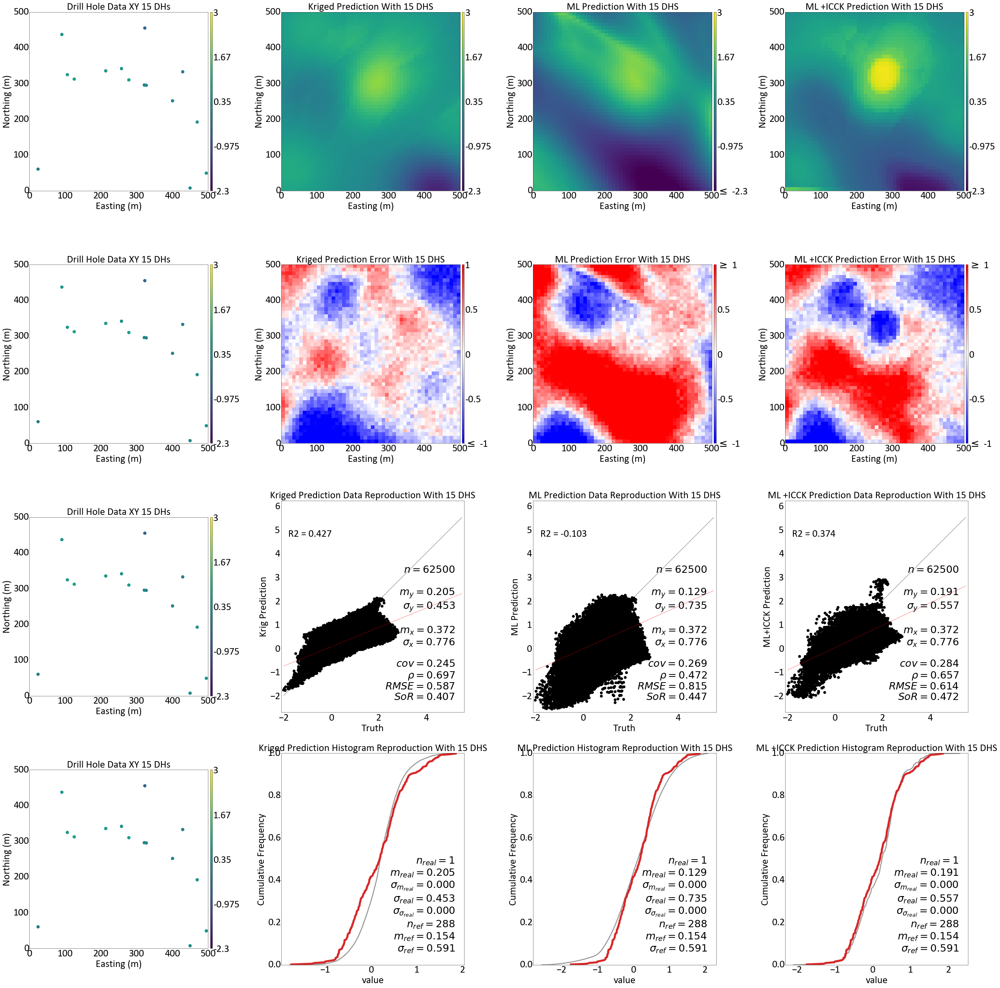

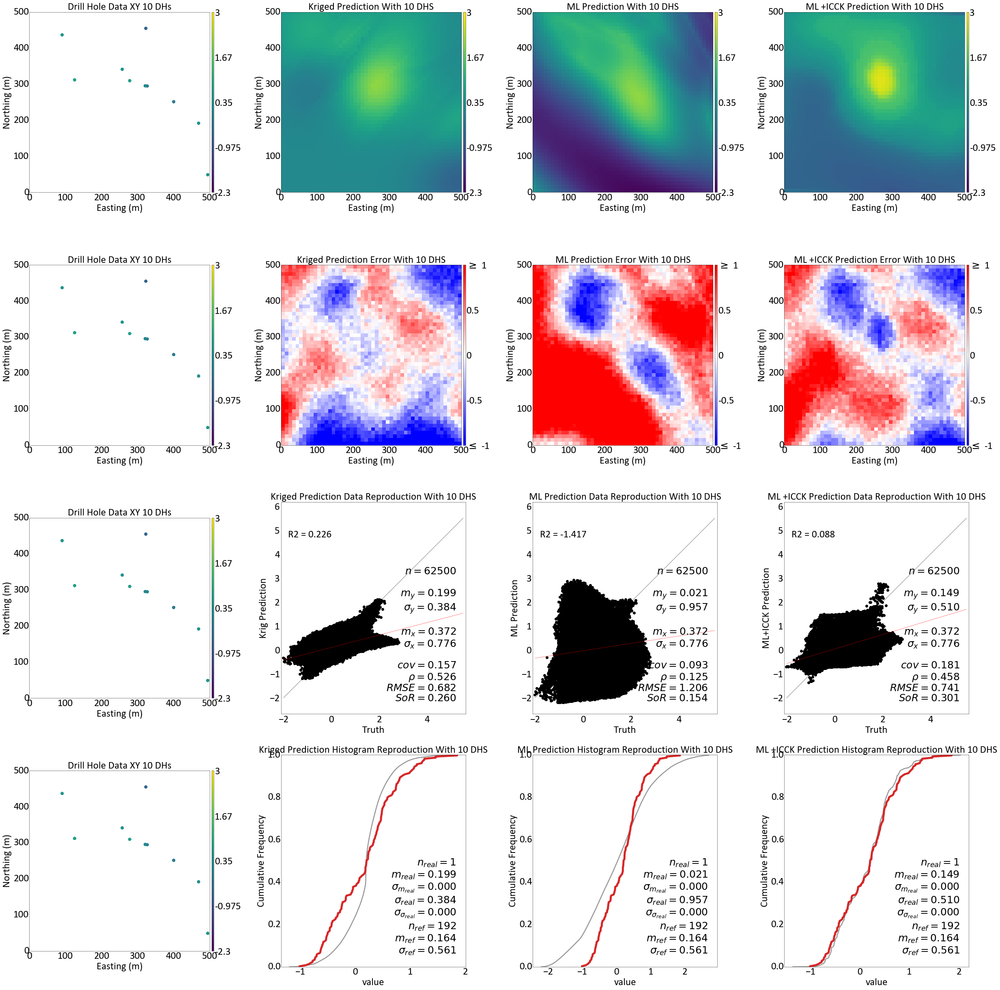

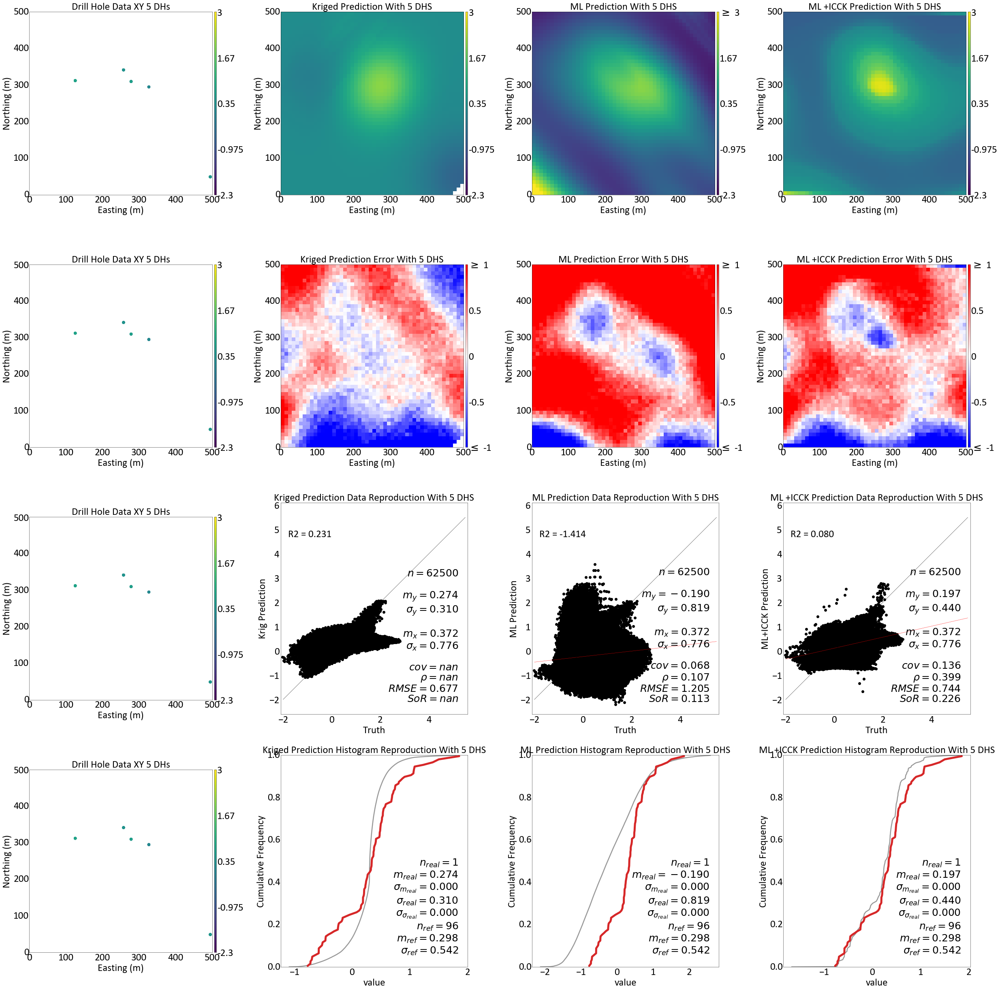

In [9]:
r2_krg_full = []
r2_ML_full = []
r2_ML_icck_full = []
rmse_krg_full = []
rmse_ML_full = []
rmse_ML_icck_full = []
mean_krig = [] 
mean_ML = []
mean_ML_icck = []
sigma_krig= []
sigma_ML= []
sigma_ML_icck= []

vlim = (-2.3,3)
elim = (-1,1)
truth = gs.DataFile('sgsim.out',griddef=griddef)
gs.set_style('pt25')
for fold in range(1,21):
    sim_krig = gs.DataFile('./predictions/kt3dn_{}.out'.format(fold))
    sim_ml = gs.DataFile('./predictions/ensemble_{}.dat'.format(fold))
    sim_ml_icck = gs.DataFile('./backtr/backtr_{}.out'.format(fold))
    
    f, axes = plt.subplots(4, 4, figsize=(35, 35)) 
    
    dataflpoints = gs.DataFile(flname='./declus/declus_{}.out'.format(fold), x='X',y='Y',z='Z', griddef = griddef,
                           readfl=True)  
    
    gs.locmap(dataflpoints,var = 'value',orient='xy', ax = axes[0,0],sliceno= 15,
                     title = ('Drill Hole Data XY {} DHs').format(100-(fold-1)*5),vlim=vlim)
    gs.pixelplt(sim_krig.data['Estimate'],griddef=griddef,ax=axes[0,1] ,
                title = 'Kriged Prediction With {} DHS'.format(100-(fold-1)*5),vlim=vlim)
    gs.pixelplt(sim_ml.data['0'],griddef=griddef,ax=axes[0,2] ,
                title = 'ML Prediction With {} DHS'.format(100-(fold-1)*5),vlim=vlim)
    gs.pixelplt(sim_ml_icck.data['Back Transform'],griddef=griddef,ax=axes[0,3] ,
                title = 'ML +ICCK Prediction With {} DHS'.format(100-(fold-1)*5),vlim=vlim)
    gs.locmap(dataflpoints,var = 'value',orient='xy', ax = axes[1,0],sliceno= 15,
                     title = ('Drill Hole Data XY {} DHs').format(100-(fold-1)*5),vlim=vlim)
    gs.pixelplt((truth.data['value']-sim_krig.data['Estimate']),griddef=griddef,ax=axes[1,1] ,
                title = 'Kriged Prediction Error With {} DHS'.format(100-(fold-1)*5),vlim=elim,cmap = 'bwr')
    gs.pixelplt((truth.data['value']-sim_ml.data['0']),griddef=griddef,ax=axes[1,2] ,
                title = 'ML Prediction Error With {} DHS'.format(100-(fold-1)*5),vlim=elim,cmap = 'bwr')
    gs.pixelplt((truth.data['value']-sim_ml_icck.data['Back Transform']),griddef=griddef,ax=axes[1,3] ,
                title = 'ML +ICCK Prediction Error With {} DHS'.format(100-(fold-1)*5),vlim=elim,cmap = 'bwr')
    gs.locmap(dataflpoints,var = 'value',orient='xy', ax = axes[2,0],sliceno= 15,
                     title = ('Drill Hole Data XY {} DHs').format(100-(fold-1)*5),vlim=vlim)
    gs.scatxval(truth.data['value'],sim_krig.data['Estimate'],griddef=griddef,ax=axes[2,1] ,
                title = 'Kriged Prediction Data Reproduction With {} DHS'.format(100-(fold-1)*5),vlim=(-2,5.5),
               xlabel = 'Truth', ylabel='Krig Prediction')
    axes[2,1].text(-1.8,4.7,'R2 = {0:.3f}'.format(r2_score(truth.data['value'],sim_krig.data['Estimate'].fillna(value = 2.7))),size=25)
    
    gs.scatxval(truth.data['value'],sim_ml.data['0'],griddef=griddef,ax=axes[2,2] ,
                title = 'ML Prediction Data Reproduction With {} DHS'.format(100-(fold-1)*5),vlim=(-2,5.5),
               xlabel = 'Truth', ylabel='ML Prediction')
    axes[2,2].text(-1.8,4.7,'R2 = {0:.3f}'.format(r2_score(truth.data['value'],sim_ml.data['0'])),size=25)
    
    gs.scatxval(truth.data['value'],sim_ml_icck.data['Back Transform'],griddef=griddef,ax=axes[2,3] ,
                title = 'ML +ICCK Prediction Data Reproduction With {} DHS'.format(100-(fold-1)*5),vlim=(-2,5.5),
               xlabel = 'Truth', ylabel='ML+ICCK Prediction')
    axes[2,3].text(-1.8,4.7,'R2 = {0:.3f}'.format(r2_score(truth.data['value'],sim_ml_icck.data['Back Transform'])),size=25)
    
    gs.locmap(dataflpoints,var = 'value',orient='xy', ax = axes[3,0],sliceno= 15,
                     title = ('Drill Hole Data XY {} DHs').format(100-(fold-1)*5),vlim=vlim)
    gs.histpltsim(sim_krig.data['Estimate'],dataflpoints.data['value'],refwt = dataflpoints.data['Declustering Weight']
                  ,griddef=griddef,ax=axes[3,1] ,lw=5,
                title = 'Kriged Prediction Histogram Reproduction With {} DHS'.format(100-(fold-1)*5), nreal = 1)
    gs.histpltsim(sim_ml.data['0'],dataflpoints.data['value'],refwt = dataflpoints.data['Declustering Weight']
                  ,griddef=griddef,ax=axes[3,2] ,lw=5,
                title = 'ML Prediction Histogram Reproduction With {} DHS'.format(100-(fold-1)*5), nreal = 1)
    gs.histpltsim(sim_ml_icck.data['Back Transform'],dataflpoints.data['value'],refwt = dataflpoints.data['Declustering Weight']
                  ,griddef=griddef,ax=axes[3,3] ,lw=5,
                title = 'ML +ICCK Prediction Histogram Reproduction With {} DHS'.format(100-(fold-1)*5), nreal = 1)
    
    r2_krg_full.append(r2_score(sgsimfl['value'],sim_krig.data['Estimate'].fillna(value = 2.7)))
    r2_ML_full.append(r2_score(sgsimfl['value'],sim_ml.data['0'].fillna(value = 2.7)))
    r2_ML_icck_full.append(r2_score(sgsimfl['value'],sim_ml_icck.data['Back Transform'].fillna(value = 2.7)))
    rmse_krg_full.append(np.sqrt(mean_squared_error(sgsimfl['value'],sim_krig.data['Estimate'].fillna(value = 2.7))))
    rmse_ML_full.append(np.sqrt(mean_squared_error(sgsimfl['value'],sim_ml.data['0'].fillna(value = 2.7))))
    rmse_ML_icck_full.append(np.sqrt(mean_squared_error(sgsimfl['value'],sim_ml_icck.data['Back Transform'].fillna(value = 2.7))))
    mean_krig.append(np.mean(sim_krig.data['Estimate'].fillna(value = 2.7)))
    mean_ML.append(np.mean(sim_ml.data['0'].fillna(value = 2.7)))
    mean_ML_icck.append(np.mean(sim_ml_icck.data['Back Transform'].fillna(value = 2.7)))
    sigma_krig.append(np.std(sim_krig.data['Estimate'].fillna(value = 2.7)))
    sigma_ML.append(np.std(sim_ml.data['0'].fillna(value = 2.7)))
    sigma_ML_icck.append(np.std(sim_ml_icck.data['Back Transform'].fillna(value = 2.7)))
    
    plt.tight_layout()  
    plt.savefig('C:/Users/Matt/Desktop/Thesis Work/Thesis/0-Figures/3-Chapter/Data_Number_{}_{}.png'.format(fold,plt_extent))

In [10]:
num_dhs = [100,95,90,85,80,75,70,65,60,55,50,45,40,35,30,25,20,15,10,5]
ML_Stats = np.vstack((num_dhs,rmse_ML_full,r2_ML_full,sigma_ML,mean_ML)).T
ML_icck_Stats = np.vstack((num_dhs,rmse_ML_icck_full,r2_ML_icck_full,sigma_ML_icck,mean_ML_icck)).T
Krig_Stats = np.vstack((num_dhs,rmse_krg_full,r2_krg_full,sigma_krig,mean_krig)).T


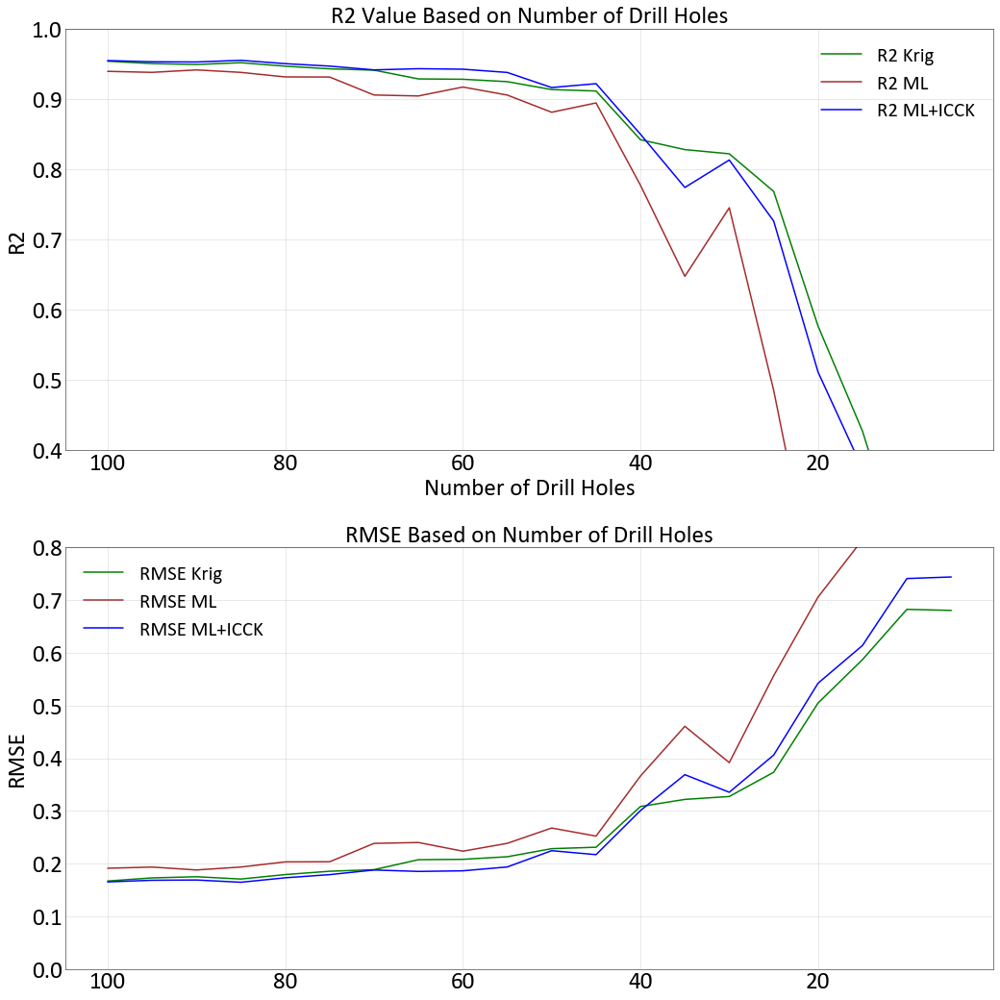

In [11]:
f, (ax1,ax2) = plt.subplots(2, 1,figsize=(15, 15))
ax1.plot(num_dhs, np.asarray(r2_krg_full),color="green", label ='R2 Krig')
ax1.plot(num_dhs, np.asarray(r2_ML_full),color="brown", label ='R2 ML')
ax1.plot(num_dhs, np.asarray(r2_ML_icck_full),color="blue", label ='R2 ML+ICCK')
ax1.set_xlabel('Number of Drill Holes')
ax1.grid(True)
ax1.set_title('R2 Value Based on Number of Drill Holes')
ax1.set_ylabel('R2', color='Black')
ax1.tick_params(axis='y', labelcolor='Black')
ax1.legend(loc='best',fontsize = 'small')
ax1.invert_xaxis()
ax1.set_ylim([0.4,1])

ax2.plot(num_dhs, np.asarray(rmse_krg_full),'-',color="green",label ='RMSE Krig')
ax2.plot(num_dhs, np.asarray(rmse_ML_full),'-',color="brown",label ='RMSE ML')
ax2.plot(num_dhs, np.asarray(rmse_ML_icck_full),'-',color="blue",label ='RMSE ML+ICCK')
ax2.set_title('RMSE Based on Number of Drill Holes')
ax2.grid(True)
ax2.set_ylabel('RMSE', color='Black')
ax2.tick_params(axis='y', labelcolor='Black')
ax2.legend(loc='best',fontsize = 'small')
ax2.invert_xaxis()
ax2.set_ylim([0,0.8])
plt.tight_layout()  
plt.savefig('C:/Users/Matt/Desktop/Thesis Work/Thesis/0-Figures/3-Chapter/Sum_graph_{}.png'.format(plt_extent))

In [12]:
ml_sim = np.asarray(ML_Stats).flatten().reshape(len(np.asarray(ML_Stats).flatten()),1)
icck_ml_sim = np.asarray(ML_icck_Stats).flatten().reshape(len(np.asarray(ML_icck_Stats).flatten()),1)
krig_sim = np.asarray(Krig_Stats).flatten().reshape(len(np.asarray(Krig_Stats).flatten()),1)

In [13]:
np.savetxt('ML_stats.csv', ML_Stats, delimiter = ',')
np.savetxt('Krig_stats.csv', Krig_Stats, delimiter = ',')
np.savetxt('ML_icck_stats.csv', ML_icck_Stats, delimiter = ',')

IndexError: index 0 is out of bounds for axis 0 with size 0

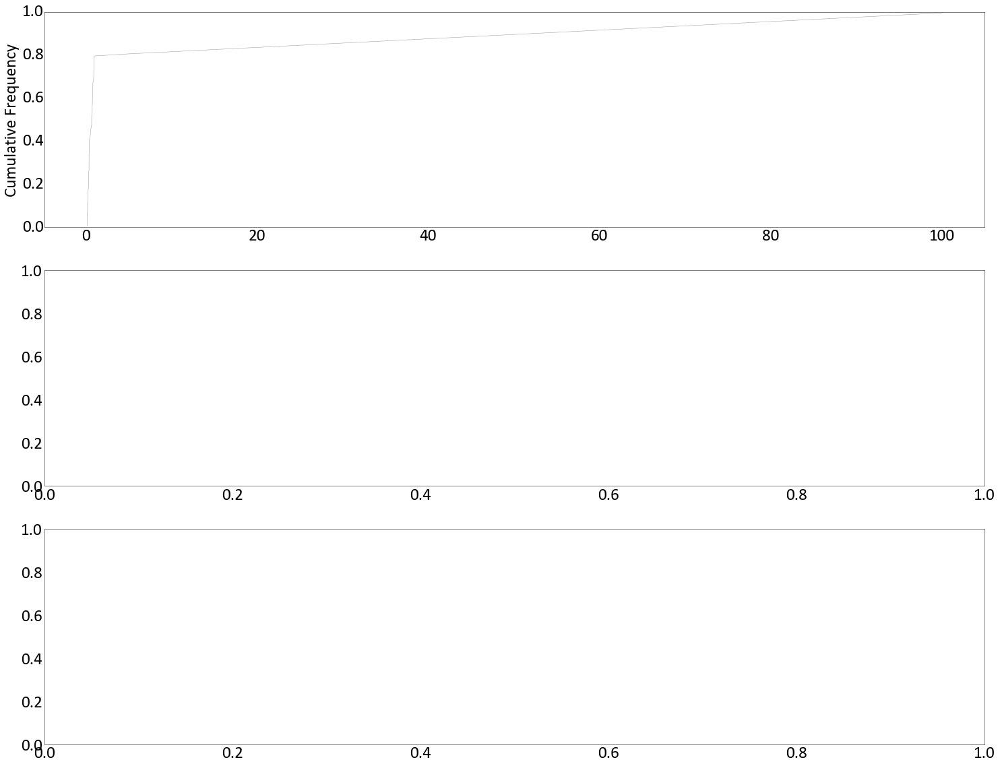

In [14]:
samplefl = gs.DataFile('datasamplefl.out')
gs.set_style('pt25')
xlim=(-0.05,2)
f, axes = plt.subplots(3, 1, figsize=(25, 20))
gs.histpltsim(krig_sim,samplefl.data['value'],griddef=griddef,nreal=20,ax = axes[0],
              title = 'CDF Sensitivity Study Krig ', xlim=xlim)
gs.histpltsim(ml_sim,samplefl.data['value'],griddef=griddef,nreal=20,ax = axes[1],
              title = 'CDF Sensitivity Study ML ', xlim=xlim)
gs.histpltsim(icck_ml_sim,samplefl.data['value'],griddef=griddef,nreal=20,ax = axes[2],
              title = 'CDF Sensitivity Study ML+OICCK ', xlim=xlim)
plt.tight_layout()    
plt.savefig('C:/Users/Matt/Desktop/Thesis Work/Thesis/0-Figures/3-Chapter/Dist_study_{}.png'.format(plt_extent))

In [ ]:
# varsim = gs.Program('varsim')
# varsimparstr = """                 Parameters for VarSim
#                  *********************

# START OF PARAMETERS:
# ../data/lithology.dat        -file with lithology information
# 0   7                        -   lithology column (0=not used), code
# {datafl}             -file with data
# 1   {col}                -   number of variables, column numbers
# -1.0e21     1.0e21    -   trimming limits
# ./vargs/varsim_reals_{p_type}_{fold}.out      -output file for variograms of realizations
# ./vargs/varsim_avg_{p_type}_{fold}.out        -output file for average variogram
# {griddef}
# 1                  -number of realizations
# 3  100                 -number of directions, number of lags
# 1  0  0              -ixd(1),iyd(1),izd(1)
# 0  1  0              -ixd(2),iyd(2),izd(2)
# 0  0  1              -ixd(2),iyd(2),izd(2)
# 0                     -standardize sill? (0=no, 1=yes)
# 1                     -number of variograms
# 1   1   1             -tail variable, head variable, variogram type
# """

In [ ]:
# gs.set_style('pt25')
# ylim = (-.2,1.2)
# f, axes = plt.subplots(3, 2, figsize=(25, 20))
# for fold in range(1,2):
#     varmodelfl = gs.DataFile('./vargs/varmodel_{}.out'.format(fold))
#     varcalcfl = gs.DataFile('./vargs/varcalc_{}.out'.format(fold))
#     for p_type in list(['Krig','ML','OICCK+ML']):
#         if p_type == 'Krig':
#             predfile = gs.DataFile('./predictions/kt3dn_{}.out'.format(fold),griddef=griddef)
#             col = 1
#         if p_type == 'OICCK+ML':
#             predfile = gs.DataFile('./backtr/backtr_UDDH_{}.out'.format(fold),griddef=griddef)
#             col = 3
#         else:
#             predfile = gs.DataFile('./predictions/ensemble_{}.dat'.format(fold),griddef=griddef)
#             col = 1
            
#         varsim.run(varsimparstr.format(datafl = predfile,
#                                        p_type = p_type,
#                                        fold = fold,
#                                        col = col,
#                                        griddef = griddef),quiet=True,liveoutput=False)
#         varsimfl =  gs.DataFile('./vargs/varsim_reals_{}_{}.out'.format(p_type,fold))
    

#         if p_type == 'Krig':
#             ax = gs.varplt(varsimfl,experimental=False,color ='C0' ,index = 1,ax =axes[0,0],ms = 10, title = 'Varsim est type {} fold {} Major Direction'.format(p_type,fold), label= 'Varg Rep',ylim=ylim)
#             ax = gs.varplt(varcalcfl.data,index = 1,ax =ax,color ='C1' ,ms = 10, title = 'Varsim est type {} fold {} Major Direction'.format(p_type,fold),label= 'Experimental',ylim=ylim)
#             ax = gs.varplt(varmodelfl,experimental=False,color ='C1' ,index = 1,ax =ax, title = 'Varsim est type {} fold {} Major Direction'.format(p_type,fold),label= 'Model',ylim=ylim)
#             ax.legend(loc=7,prop={'size': 20})
#             ax.set_xlim(0, 400)
            
#             ax2 = gs.varplt(varsimfl,experimental=False,color ='C0' ,ms = 10,index = 2,ax =axes[0,1], title = 'Varsim est type {} fold {} Minor Direction'.format(p_type,fold), label= 'Varg Rep',ylim=ylim)
#             ax2 = gs.varplt(varcalcfl.data,index = 2,ax =ax2,color ='C1' ,ms = 10, title = 'Varsim est type {} fold {} Minor Direction'.format(p_type,fold),label= 'Experimental',ylim=ylim)
#             ax2 = gs.varplt(varmodelfl,experimental=False,color ='C1' ,ms = 10,index = 2,ax =ax2, title = 'Varsim est type {} fold {} Minor Direction'.format(p_type,fold),label= 'Model',ylim=ylim)
#             ax2.legend(loc=7,prop={'size': 20})
#             ax2.set_xlim(0, 400)
            
#         if p_type == 'ML':
#             ax4 = gs.varplt(varsimfl,experimental=False,color ='C0' ,index = 1,ax = axes[1,0],ms = 10, title = 'Varsim est type {} fold {} Major Direction'.format(p_type,fold), label= 'Varg Rep',ylim=ylim)
#             ax4.legend(loc=7,prop={'size': 20})
#             ax4.set_xlim(0, 400)
#             ax5 = gs.varplt(varsimfl,experimental=False,color ='C0' ,ms = 10,index = 2,ax = axes[1,1], title = 'Varsim est type {} fold {} Minor Direction'.format(p_type,fold), label= 'Varg Rep',ylim=ylim)
#             ax5.set_xlim(0, 400)

#         if p_type == 'OICCK+ML':
#             ax6 = gs.varplt(varsimfl,experimental=False,color ='C0' ,index = 1,ax = axes[2,0],ms = 10, title = 'Varsim est type {} fold {} Major Direction'.format(p_type,fold), label= 'Varg Rep',ylim=ylim)
#             #ax = gs.varplt(varcalcfl.data,index = 1,ax =ax,color ='C1' ,ms = 10, title = 'Varsim est type {} fold {} Major Direction'.format(p_type,fold),label= 'Experimental')
#             #ax = gs.varplt(varmodelfl,experimental=False,color ='C1' ,index = 1,ax =ax, title = 'Varsim est type {} fold {} Major Direction'.format(p_type,fold),label= 'Model')
#             ax6.legend(loc=7,prop={'size': 20})
#             ax6.set_xlim(0, 400)
#             ax7 = gs.varplt(varsimfl,experimental=False,color ='C0' ,ms = 10,index = 2,ax = axes[2,1], title = 'Varsim est type {} fold {} Minor Direction'.format(p_type,fold), label= 'Varg Rep',ylim=ylim)
#             #ax2 = gs.varplt(varcalcfl.data,index = 2,ax =ax2,color ='C1' ,ms = 10, title = 'Varsim est type {} fold {} Minor Direction'.format(p_type,fold),label= 'Experimental')
#             #ax2 = gs.varplt(varmodelfl,experimental=False,color ='C1' ,ms = 10,index = 2,ax =ax2, title = 'Varsim est type {} fold {} Minor Direction'.format(p_type,fold),label= 'Model')
#             ax7.legend(loc=7,prop={'size': 20})
#             ax7.set_xlim(0, 400)


#     plt.tight_layout()    
#     plt.savefig('C:/Users/Matt/Desktop/Thesis Work/Thesis/0-Figures/3-Chapter/varg_rep_ERBFN_{}_{}.png'.format(plt_extent,fold))
#     plt.show()
